# Probelm Statement

DonorsChoose is a United States-based nonprofit organization (NPO) that allows individuals to donate directly to public school classroom projects. The organization has been given Charity Navigator's highest rating every year since 2005. In January 2018, they announced that 1 million projects had been funded.

#### Importing required libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv("Preprocessed_DonorsChoose_dataset.csv")
df

,id,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,teacher_number_of_previously_posted_projects,project_is_approved,price,quantity,cleaned_titles,cleaned_essays,cleaned_summary,isdigit_summary
0,p253737,mrs,in,grades_prek_2,literacy_language,esl_literacy,0,0,154.60,23,educational support english learners home,students english learners working english seco...,students_need_opportunities_practice_beginning...,0
1,p258326,mr,fl,grades_6_8,history_civics_health_sports,civics_government_teamsports,7,1,299.00,1,wanted projector hungry learners,students arrive school eager learn polite gene...,students_need_projector_help_viewing_education...,0
2,p182444,ms,az,grades_6_8,health_sports,health_wellness_teamsports,1,0,516.85,22,soccer equipment awesome middle school students,true champions not always ones win guts mia ha...,students_need_shine_guards_athletic_socks_socc...,0
3,p246581,mrs,ky,grades_prek_2,literacy_language_math_science,literacy_mathematics,4,1,232.90,4,techie kindergarteners,work unique school filled esl english second l...,students_need_engage_reading_math_way_inspire_...,0
4,p104768,mrs,tx,grades_prek_2,math_science,mathematics,1,1,67.98,4,interactive math tools,second grade classroom next year made around 2...,students_need_hands_practice_mathematics_fun_p...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109243,p048540,mr,mo,grades_prek_2,literacy_language_math_science,literature_writing_mathematics,0,1,59.98,8,privacy shields help promote independent thinking,welcome mr ramos 2nd grade classroom title 1 s...,students_need_privacy_partitions_help_focus_be...,0
109244,p166281,ms,nj,grades_prek_2,literacy_language_math_science,literacy_mathematics,0,1,846.32,4,technology classroom,every morning start day core values lead solel...,students_need_two_ipad_protective_cases_enhanc...,0
109245,p155633,mrs,nj,grades_prek_2,literacy_language_math_science,literacy_mathematics,3,1,239.96,4,2016 2017 beginning year basics,great group sharing caring students multi grad...,students_need_giant_comfy_pillows_order_help_r...,0
109246,p206114,mrs,ny,grades_3_5,health_sports_specialneeds,health_wellness_specialneeds,0,1,73.05,16,flexible seating inclusive classroom,students live small rural community classroom ...,students_need_flexible_seating_options_bean_ba...,0


In [3]:
df.shape

(109248, 14)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109248 entries, 0 to 109247
Data columns (total 14 columns):
 #   Column                                        Non-Null Count   Dtype  
---  ------                                        --------------   -----  
 0   id                                            109248 non-null  object 
 1   teacher_prefix                                109248 non-null  object 
 2   school_state                                  109248 non-null  object 
 3   project_grade_category                        109248 non-null  object 
 4   project_subject_categories                    109248 non-null  object 
 5   project_subject_subcategories                 109248 non-null  object 
 6   teacher_number_of_previously_posted_projects  109248 non-null  int64  
 7   project_is_approved                           109248 non-null  int64  
 8   price                                         109248 non-null  float64
 9   quantity                                      10

In [5]:
df = df.drop("id", axis = 1)  #As this feature is not useful

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
teacher_number_of_previously_posted_projects,109248.0,11.153165,27.777154,0.00,0.00,2.00,9.0,451.0
project_is_approved,109248.0,0.848583,0.358456,0.00,1.00,1.00,1.0,1.0
price,109248.0,298.119343,367.498030,0.66,104.31,206.22,379.0,9999.0
quantity,109248.0,16.965610,26.182942,1.00,4.00,9.00,21.0,930.0
isdigit_summary,109248.0,0.144222,0.351317,0.00,0.00,0.00,0.0,1.0


In [7]:
#from the above shown statistics it is clear that all the features are having outliers present in it. As the difference between 75% and max is huge.

In [8]:
df.describe(include = 'object').T

,count,unique,top,freq
teacher_prefix,109248,5,mrs,57272
school_state,109248,51,ca,15388
project_grade_category,109248,4,grades_prek_2,44225
project_subject_categories,109248,51,literacy_language,23655
project_subject_subcategories,109248,401,literacy,9486
cleaned_titles,109205,91442,wiggle work,401
cleaned_essays,109248,108314,students come diverse backgrounds blue collar ...,10
cleaned_summary,109248,107885,students_need_electronic_tablets_things_make_s...,53


In [9]:
df.isnull().sum()

teacher_prefix                                   0
school_state                                     0
project_grade_category                           0
project_subject_categories                       0
project_subject_subcategories                    0
teacher_number_of_previously_posted_projects     0
project_is_approved                              0
price                                            0
quantity                                         0
cleaned_titles                                  43
cleaned_essays                                   0
cleaned_summary                                  0
isdigit_summary                                  0
dtype: int64

In [10]:
null_percentage = (df.isnull().sum() / len(df)) * 100


In [11]:
null_percentage

teacher_prefix                                  0.00000
school_state                                    0.00000
project_grade_category                          0.00000
project_subject_categories                      0.00000
project_subject_subcategories                   0.00000
teacher_number_of_previously_posted_projects    0.00000
project_is_approved                             0.00000
price                                           0.00000
quantity                                        0.00000
cleaned_titles                                  0.03936
cleaned_essays                                  0.00000
cleaned_summary                                 0.00000
isdigit_summary                                 0.00000
dtype: float64

#We can drop null values in cleaned titles as they are negligible.

#Almost complete data is having non nulls except the column Cleaned_titles

In [12]:
df.shape

(109248, 13)

In [13]:
df.describe(include = "object").T

,count,unique,top,freq
teacher_prefix,109248,5,mrs,57272
school_state,109248,51,ca,15388
project_grade_category,109248,4,grades_prek_2,44225
project_subject_categories,109248,51,literacy_language,23655
project_subject_subcategories,109248,401,literacy,9486
cleaned_titles,109205,91442,wiggle work,401
cleaned_essays,109248,108314,students come diverse backgrounds blue collar ...,10
cleaned_summary,109248,107885,students_need_electronic_tablets_things_make_s...,53


In [14]:
df = df.dropna()

In [15]:
df.shape

(109205, 13)

In [16]:
df.isnull().sum()

teacher_prefix                                  0
school_state                                    0
project_grade_category                          0
project_subject_categories                      0
project_subject_subcategories                   0
teacher_number_of_previously_posted_projects    0
project_is_approved                             0
price                                           0
quantity                                        0
cleaned_titles                                  0
cleaned_essays                                  0
cleaned_summary                                 0
isdigit_summary                                 0
dtype: int64

In [17]:
df["school_state"].unique()

array(['in', 'fl', 'az', 'ky', 'tx', 'ct', 'ga', 'sc', 'nc', 'ca', 'ny',
       'ok', 'ma', 'nv', 'oh', 'pa', 'al', 'la', 'va', 'ar', 'wa', 'wv',
       'id', 'tn', 'ms', 'co', 'ut', 'il', 'mi', 'hi', 'ia', 'ri', 'nj',
       'mo', 'de', 'mn', 'me', 'wy', 'nd', 'or', 'ak', 'md', 'wi', 'sd',
       'ne', 'nm', 'dc', 'ks', 'mt', 'nh', 'vt'], dtype=object)

In [18]:
df["teacher_prefix"].unique()

array(['mrs', 'mr', 'ms', 'teacher', 'dr'], dtype=object)

In [19]:
df[df["teacher_prefix"] == "teacher"]

,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,teacher_number_of_previously_posted_projects,project_is_approved,price,quantity,cleaned_titles,cleaned_essays,cleaned_summary,isdigit_summary
27,teacher,la,grades_3_5,literacy_language_math_science,foreignlanguages_mathematics,2,1,660.84,7,4th grade french immersion class ipads,students spend day learning fourth grade subje...,students_need_ipads_work_smaller_groups_accomm...,0
75,teacher,sc,grades_prek_2,music_arts,music,138,1,168.00,26,jump music,students awesome creative excited learning pri...,students_need_jump_ropes_poly_spots_lots_new_s...,0
82,teacher,tn,grades_prek_2,literacy_language,literacy,0,0,428.07,3,fall love reading,provide literacy instruction students come pov...,students_need_vibrant_effective_listening_cent...,0
88,teacher,ca,grades_6_8,specialneeds,specialneeds,0,1,119.99,5,read understand like everyone else,print disabled students enter resource classro...,students_need_technical_support_devices_tablet...,0
201,teacher,ca,grades_3_5,music_arts,music,85,1,36.90,5,ring bells hear,orchestra class unlike ordinary class aside ob...,students_need_learn_songs_life_start_bells,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
109129,teacher,nc,grades_prek_2,literacy_language,literacy,6,1,104.98,14,3d learning,students struggling readers want learn better ...,students_need_virtual_reality_headsets_along_s...,0
109160,teacher,tx,grades_3_5,music_arts,music,3,1,216.44,4,young composers need canvas write,teach music classes title public charter schoo...,students_need_whiteboard_music_staves_learn_co...,0
109217,teacher,ca,grades_3_5,specialneeds_music_arts,specialneeds_visualarts,0,1,162.60,32,art supplies super special kids,moderate severe highly intensive autism classr...,students_need_variety_art_mediums_order_hone_f...,0
109219,teacher,fl,grades_prek_2,literacy_language_history_civics,literature_writing_socialsciences,0,0,300.18,14,make learning fun grade one,creating interactive learning environment help...,students_need_access_fun_learning_engaging_env...,0


In [20]:
df.nunique()

teacher_prefix                                       5
school_state                                        51
project_grade_category                               4
project_subject_categories                          51
project_subject_subcategories                      401
teacher_number_of_previously_posted_projects       374
project_is_approved                                  2
price                                            45231
quantity                                           332
cleaned_titles                                   91442
cleaned_essays                                  108272
cleaned_summary                                 107844
isdigit_summary                                      2
dtype: int64

In [21]:
df

,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,teacher_number_of_previously_posted_projects,project_is_approved,price,quantity,cleaned_titles,cleaned_essays,cleaned_summary,isdigit_summary
0,mrs,in,grades_prek_2,literacy_language,esl_literacy,0,0,154.60,23,educational support english learners home,students english learners working english seco...,students_need_opportunities_practice_beginning...,0
1,mr,fl,grades_6_8,history_civics_health_sports,civics_government_teamsports,7,1,299.00,1,wanted projector hungry learners,students arrive school eager learn polite gene...,students_need_projector_help_viewing_education...,0
2,ms,az,grades_6_8,health_sports,health_wellness_teamsports,1,0,516.85,22,soccer equipment awesome middle school students,true champions not always ones win guts mia ha...,students_need_shine_guards_athletic_socks_socc...,0
3,mrs,ky,grades_prek_2,literacy_language_math_science,literacy_mathematics,4,1,232.90,4,techie kindergarteners,work unique school filled esl english second l...,students_need_engage_reading_math_way_inspire_...,0
4,mrs,tx,grades_prek_2,math_science,mathematics,1,1,67.98,4,interactive math tools,second grade classroom next year made around 2...,students_need_hands_practice_mathematics_fun_p...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
109243,mr,mo,grades_prek_2,literacy_language_math_science,literature_writing_mathematics,0,1,59.98,8,privacy shields help promote independent thinking,welcome mr ramos 2nd grade classroom title 1 s...,students_need_privacy_partitions_help_focus_be...,0
109244,ms,nj,grades_prek_2,literacy_language_math_science,literacy_mathematics,0,1,846.32,4,technology classroom,every morning start day core values lead solel...,students_need_two_ipad_protective_cases_enhanc...,0
109245,mrs,nj,grades_prek_2,literacy_language_math_science,literacy_mathematics,3,1,239.96,4,2016 2017 beginning year basics,great group sharing caring students multi grad...,students_need_giant_comfy_pillows_order_help_r...,0
109246,mrs,ny,grades_3_5,health_sports_specialneeds,health_wellness_specialneeds,0,1,73.05,16,flexible seating inclusive classroom,students live small rural community classroom ...,students_need_flexible_seating_options_bean_ba...,0


In [22]:
df["project_grade_category"].unique()

array(['grades_prek_2', 'grades_6_8', 'grades_3_5', 'grades_9_12'],
      dtype=object)

In [23]:
df["project_grade_category"].unique()

array(['grades_prek_2', 'grades_6_8', 'grades_3_5', 'grades_9_12'],
      dtype=object)

In [24]:
df["project_is_approved"].unique()

array([0, 1], dtype=int64)

In [25]:
df["project_is_approved"].value_counts()

1    92680
0    16525
Name: project_is_approved, dtype: int64

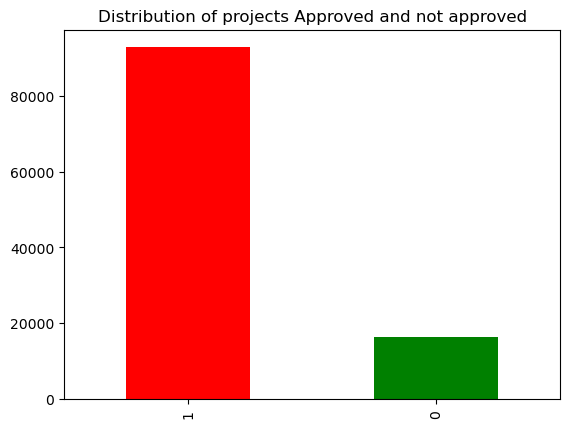

In [26]:
df["project_is_approved"].value_counts().plot(kind = 'bar', color = ["red","green"])
plt.title("Distribution of projects Approved and not approved")
plt.show()

In [27]:
#Here project is approved in a Target attribute.Like if the particular project is approved for funding or not.

In [28]:
#Here we can consider 1 as approved and 0 as not approved

# Preprocessing

In [29]:
object_list = []
numerical_list = []
for i in df.columns:
    if df[i].dtype == 'O':
        object_list.append(i)
    else:
        numerical_list.append(i)

In [30]:
object_list

['teacher_prefix',
 'school_state',
 'project_grade_category',
 'project_subject_categories',
 'project_subject_subcategories',
 'cleaned_titles',
 'cleaned_essays',
 'cleaned_summary']

In [31]:
numerical_list

['teacher_number_of_previously_posted_projects',
 'project_is_approved',
 'price',
 'quantity',
 'isdigit_summary']

In [32]:
unigrams = ['teacher_prefix', 'school_state', 'project_grade_category', 'project_subject_categories', 'project_subject_subcategories']


In [33]:
from sklearn.feature_extraction.text import CountVectorizer

In [34]:
def replace_space(s):
    s = s.replace("_", " ")
    return s
df["project_subject_categories"] = df["project_subject_categories"].apply(replace_space)
df["project_subject_subcategories"] = df["project_subject_subcategories"].apply(replace_space)

In [35]:
#!pip install wordcloud matplotlib
from wordcloud import WordCloud

In [36]:
import os

##### columns to be used in unigram vectorizer

In [38]:
unigrams = ['teacher_prefix', 'school_state', 'project_grade_category', 'project_subject_categories',
            'project_subject_subcategories']

In [39]:
def plot_barh(unigram_feature_sums):
     # Assuming you have the 'unigram_feature_sums' dictionary

    # Extract feature names and their sums from the dictionary
    feature_names = list(unigram_feature_sums.keys())
    sum_values = list(unigram_feature_sums.values())

    # Create a bar plot
    plt.figure(figsize=(10, 7))
    plt.barh(feature_names, sum_values, color='skyblue')
    plt.xlabel('Sum of Feature Occurrences')
    plt.ylabel('Feature Names')
    plt.title('Feature Sums for Unigrams')
    #plt.gca().invert_yaxis()  # Invert the y-axis to display the highest sum at the top
    plt.show()
    plt.savefig("output.pdf")
    

In [40]:
def plot_wordcloud(unigram_feature_sums):
     # Create a WordCloud object with the specified font
    wordcloud = WordCloud(width=800, height=400, background_color='white', font_path=None)

    # Generate the word cloud from the unigrams dictionary
    wordcloud.generate_from_frequencies(unigram_feature_sums)

    # Display the word cloud using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('Word Cloud for Unigrams')
    plt.show()

In [41]:
def get_unigrams(unigrams):
    for i in unigrams:
        # Create a CountVectorizer instance for unigrams (n_grams = 1)
        vectorizer_unigrams = CountVectorizer(ngram_range=(1, 1))
        # Fit and transform the text data for unigrams
        X_unigrams = vectorizer_unigrams.fit_transform(df[i])
        # Get the feature names (words or n-grams)
        feature_names_unigrams = vectorizer_unigrams.get_feature_names_out()
        # Print the results for unigrams
        print("\n------------Unigrams: for", i,"--------------\n")
        #print(X_unigrams.toarray())
        print("\nFeature names (Unigrams): for ", i, feature_names_unigrams)
        print("-------------------------------------------------------------------")
        # Calculate the column-wise sum for unigrams
        sum_unigrams = X_unigrams.sum(axis=0)
        # Convert the sums to a numpy array and flatten it
        sum_unigrams = np.array(sum_unigrams).flatten()
        # Create a dictionary to associate feature names with their respective sums
        unigram_feature_sums = {feature_names_unigrams[i]: sum_unigrams[i] for i in range(len(feature_names_unigrams))}
        # Print the feature sums for unigrams
        print("Feature Sums for Unigrams:")
        for feature, sum_value in unigram_feature_sums.items():
            print(f"{feature}: {sum_value}")
        print("***********************************************************************")
    
        sorted_unigram_values = dict(sorted(unigram_feature_sums.items(), key = lambda x:x[1], reverse = True))
        
        #print(sorted_unigram_values)
        
        plot_barh(sorted_unigram_values)
        plot_wordcloud(unigram_feature_sums)
    
    #print(unigram_feature_sums)
    
     #Specify the path to your custom font (Dejavu.ttf)
    #font_path = "D:\\Needa\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\DejaVuSans.ttf"
    #r"D:\Needa\anaconda3\Lib\site-packages\matplotlib\mpl-data\fonts\DejavuSans.ttf"

    
   

In [42]:
#def visualize()


------------Unigrams: for teacher_prefix --------------


Feature names (Unigrams): for  teacher_prefix ['dr' 'mr' 'mrs' 'ms' 'teacher']
-------------------------------------------------------------------
Feature Sums for Unigrams:
dr: 13
mr: 10643
mrs: 57248
ms: 38943
teacher: 2358
***********************************************************************


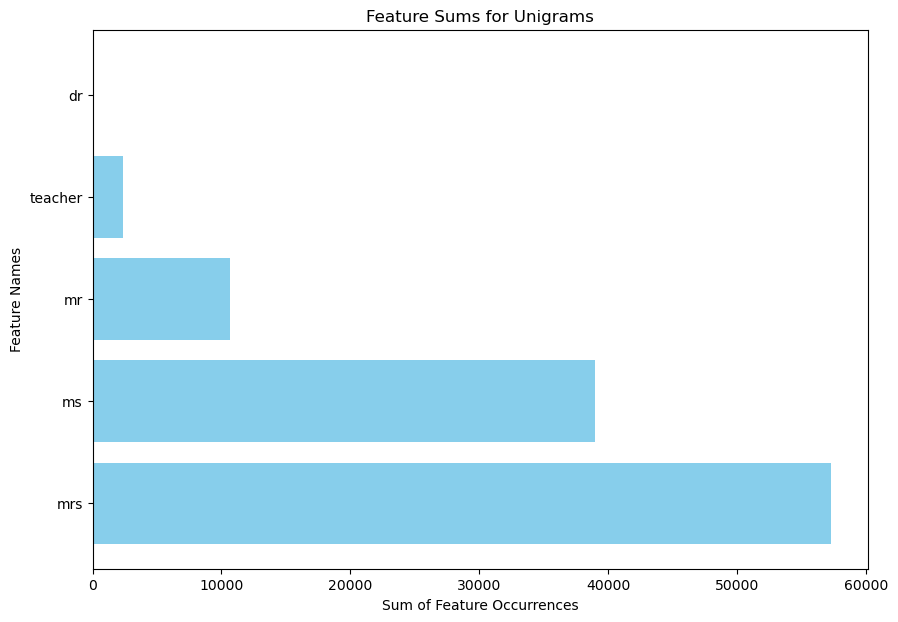

<Figure size 640x480 with 0 Axes>

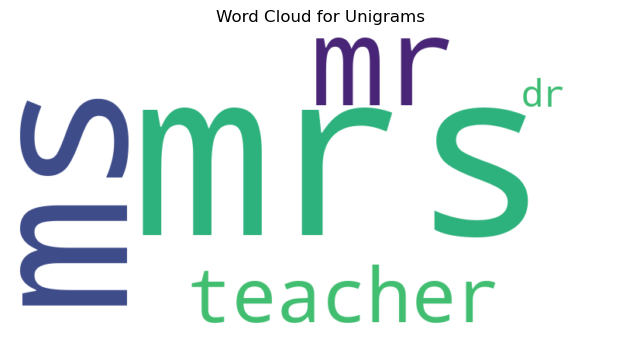


------------Unigrams: for school_state --------------


Feature names (Unigrams): for  school_state ['ak' 'al' 'ar' 'az' 'ca' 'co' 'ct' 'dc' 'de' 'fl' 'ga' 'hi' 'ia' 'id'
 'il' 'in' 'ks' 'ky' 'la' 'ma' 'md' 'me' 'mi' 'mn' 'mo' 'ms' 'mt' 'nc'
 'nd' 'ne' 'nh' 'nj' 'nm' 'nv' 'ny' 'oh' 'ok' 'or' 'pa' 'ri' 'sc' 'sd'
 'tn' 'tx' 'ut' 'va' 'vt' 'wa' 'wi' 'wv' 'wy']
-------------------------------------------------------------------
Feature Sums for Unigrams:
ak: 345
al: 1760
ar: 1049
az: 2146
ca: 15382
co: 1111
ct: 1663
dc: 516
de: 342
fl: 6183
ga: 3957
hi: 507
ia: 666
id: 693
il: 4342
in: 2620
ks: 634
ky: 1304
la: 2394
ma: 2388
md: 1514
me: 505
mi: 3161
mn: 1208
mo: 2576
ms: 1323
mt: 245
nc: 5088
nd: 143
ne: 309
nh: 348
nj: 2237
nm: 557
nv: 1367
ny: 7315
oh: 2466
ok: 2275
or: 1242
pa: 3109
ri: 285
sc: 3934
sd: 300
tn: 1688
tx: 7392
ut: 1731
va: 2045
vt: 80
wa: 2334
wi: 1825
wv: 503
wy: 98
***********************************************************************


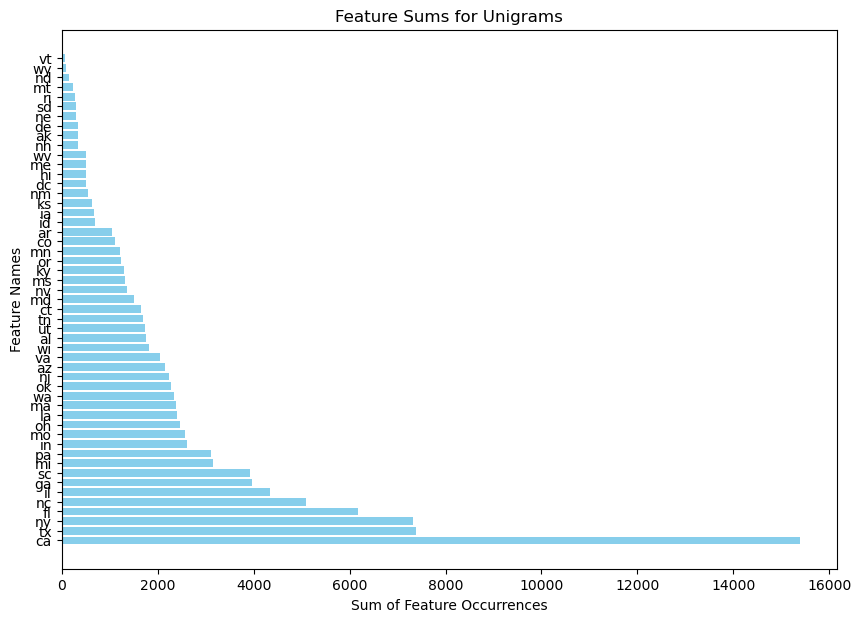

<Figure size 640x480 with 0 Axes>

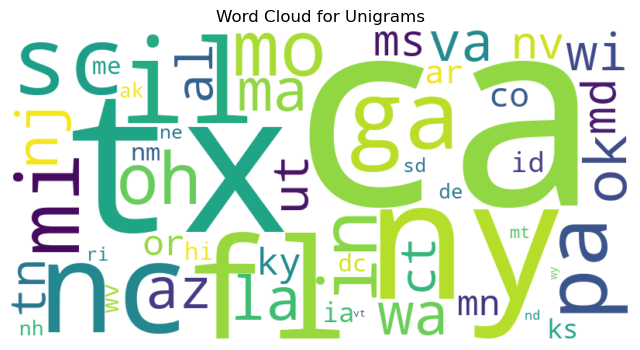


------------Unigrams: for project_grade_category --------------


Feature names (Unigrams): for  project_grade_category ['grades_3_5' 'grades_6_8' 'grades_9_12' 'grades_prek_2']
-------------------------------------------------------------------
Feature Sums for Unigrams:
grades_3_5: 37122
grades_6_8: 16914
grades_9_12: 10961
grades_prek_2: 44208
***********************************************************************


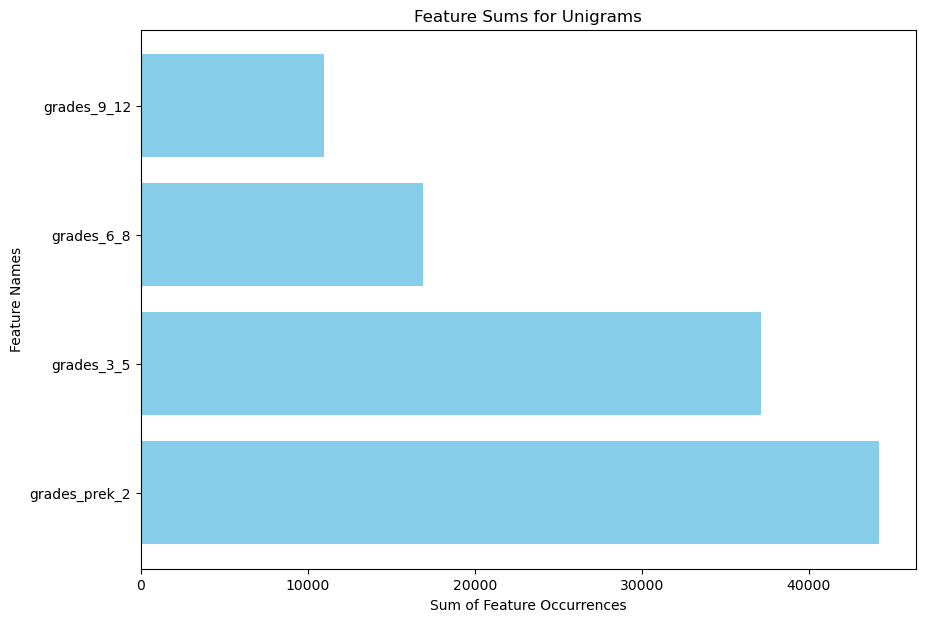

<Figure size 640x480 with 0 Axes>

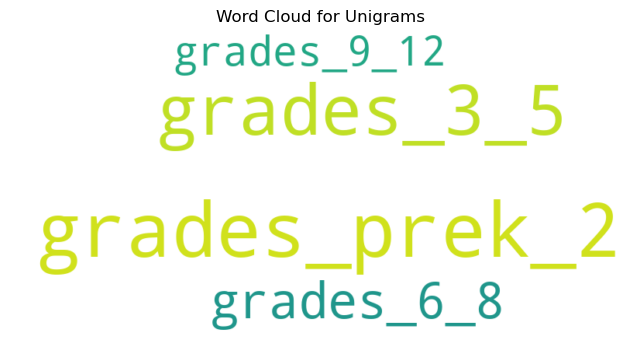


------------Unigrams: for project_subject_categories --------------


Feature names (Unigrams): for  project_subject_categories ['appliedlearning' 'arts' 'care' 'civics' 'health' 'history' 'hunger'
 'language' 'literacy' 'math' 'music' 'science' 'specialneeds' 'sports'
 'warmth']
-------------------------------------------------------------------
Feature Sums for Unigrams:
appliedlearning: 12131
arts: 10288
care: 1388
civics: 5907
health: 14220
history: 5907
hunger: 1388
language: 52216
literacy: 52216
math: 41409
music: 10288
science: 41409
specialneeds: 13634
sports: 14220
warmth: 1388
***********************************************************************


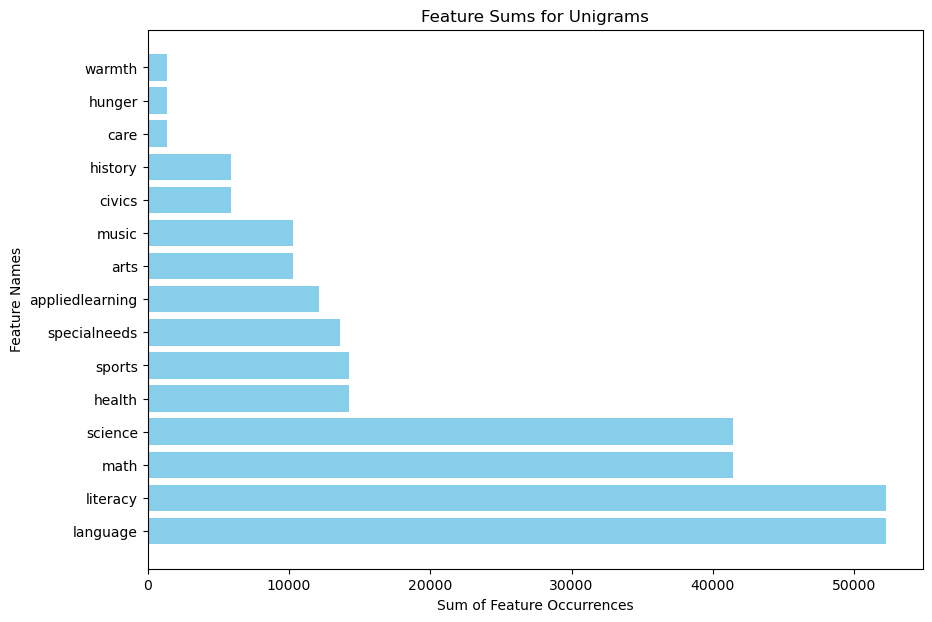

<Figure size 640x480 with 0 Axes>

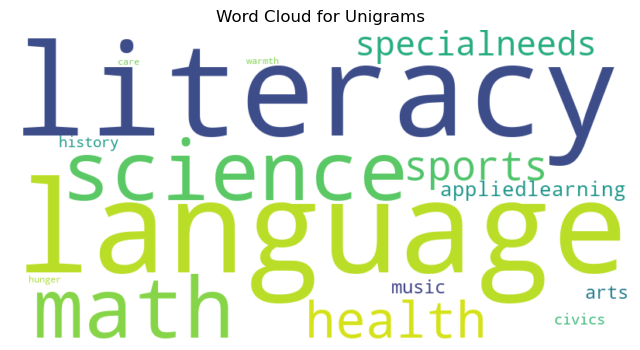


------------Unigrams: for project_subject_subcategories --------------


Feature names (Unigrams): for  project_subject_subcategories ['appliedsciences' 'care' 'careerprep' 'charactereducation' 'civics'
 'college' 'communityservice' 'earlydevelopment' 'economics'
 'environmentalscience' 'esl' 'extracurricular' 'financialliteracy'
 'fitness' 'foreignlanguages' 'geography' 'government' 'gym' 'health'
 'history' 'hunger' 'lifescience' 'literacy' 'literature' 'mathematics'
 'music' 'nutritioneducation' 'other' 'parentinvolvement' 'performingarts'
 'socialsciences' 'specialneeds' 'teamsports' 'visualarts' 'warmth'
 'wellness' 'writing']
-------------------------------------------------------------------
Feature Sums for Unigrams:
appliedsciences: 10814
care: 1388
careerprep: 2567
charactereducation: 2065
civics: 812
college: 2567
communityservice: 441
earlydevelopment: 4251
economics: 269
environmentalscience: 5588
esl: 4364
extracurricular: 810
financialliteracy: 568
fitness: 4507
foreign

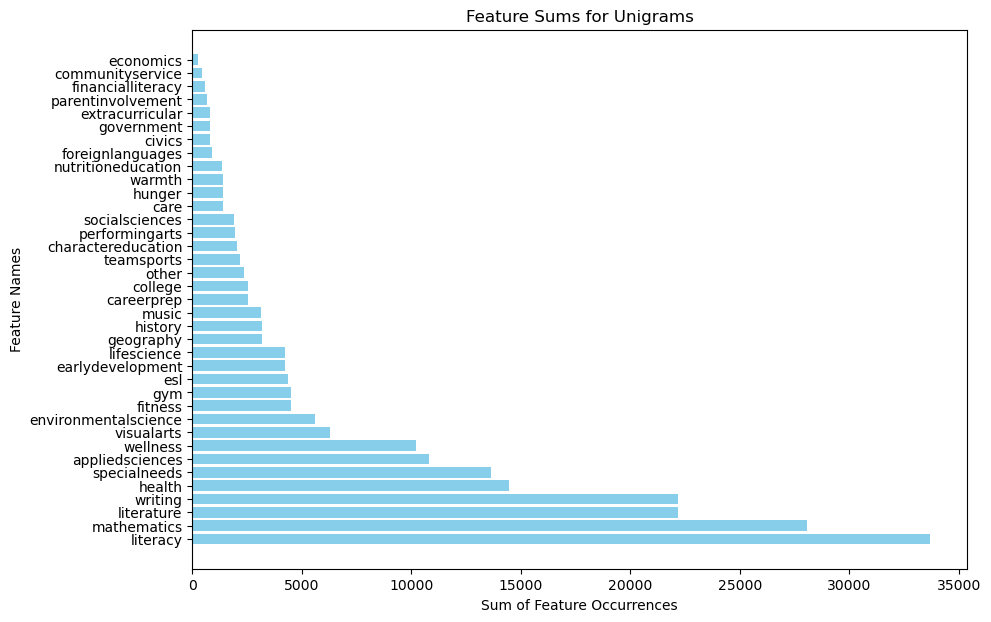

<Figure size 640x480 with 0 Axes>

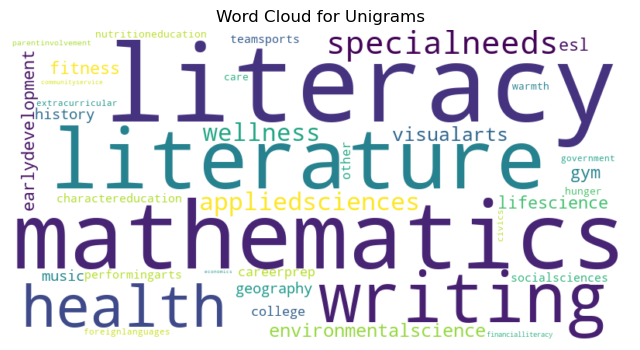

In [43]:
get_unigrams(unigrams)

In [44]:
#!pip install --upgrade pip 

#!pip install --upgrade Pillow

In [45]:
#pip install wordcloud

In [46]:
#pip install matplotlib wordcloud

In [47]:
#from wordcloud import WordCloud

In [48]:
import nltk
from nltk.corpus import stopwords
from nltk.util import bigrams
from nltk.util import trigrams
from nltk.tokenize import word_tokenize
import string
import pandas as pd
from nltk.probability import FreqDist

# Assuming you have a DataFrame df with a column named "cleaned_essays"
word_set = set()

def clean_text(text_list):
    bigram_counts = {}  # Dictionary to store bigrams and their counts
    trigram_counts = {}
    
    custom_words = ["students","student","school", "special", "learnings", "english", "working", "language", "need", "learn", 
                   "learning", "seating", "21st", "century", "help", "us","library", "first", "grade", "books", "read",
                    "reading", "love", "book", "learners", "extra", "classroom", "second","let", "get", "flexible", "uku",
                    "7x9", "muir", "70s", "bdc", "nyt","cbe","lpn", "cj", "mvp", "uwva", "tra", "tast", "nuc", "thsee", "asa",
                    "ah", "isto", "would", "throughout", "come", "many", "free", "new", "things", "receive", "every", 
                    "small", "use", "daily", "high", "low", "needs", "met", "pre", "k", "reduced"]
    
    english_stopwords = stopwords.words('english')
    english_stopwords.extend(custom_words)
    if text_list == []:
        print("Its empty")
    else:
        for text in text_list:
            # Tokenize the text
            words = word_tokenize(text)  # Tokenize and convert to lowercase
            # Remove punctuation and stopwords
            words = [word for word in words if word not in string.punctuation and word
                     not in english_stopwords and not word.isnumeric()]
            # Create bigrams and count them
            bi_grams = list(bigrams(words))
            # Generate trigrams
            tri_grams = list(trigrams(words))

            for bigram in bi_grams:
                if bigram in bigram_counts:
                    bigram_counts[bigram] += 1
                else:
                    bigram_counts[bigram] = 1
            
            for trigram in tri_grams:
                if trigram in bigram_counts:
                    trigram_counts[trigram] += 1
                else:
                    trigram_counts[trigram] = 1


        sorted_bigram_values = sorted(bigram_counts.items(), key = lambda x:x[1], reverse = True)
        sorted_trigram_values = sorted(trigram_counts.items(), key = lambda x:x[1], reverse = True)

        top_20_bigram_values = sorted_bigram_values[:20]
        top_20_trigram_values = sorted_trigram_values[:20]

        top_20_bigram_values = {item[0]: item[1] for item in top_20_bigram_values}
        top_20_trigram_values = {item[0]: item[1] for item in top_20_trigram_values}

        #print("printing top 30 bigrams..........")
        #print(top_30_bigram_values)

        # Extract keys and values from the dictionaries
        bigram_keys, bigram_values = zip(*top_20_bigram_values.items())
        trigram_keys, trigram_values = zip(*top_20_trigram_values.items())

        # Combine the tuples into single strings for word cloud
        bigram_wordcloud_dict = {' '.join(key): value for key, value in top_20_bigram_values.items()}
        #bigram_keys, bigram_values = zip(*bigram_freq_dict.items())
                    
        for key in bigram_counts.keys():
            for word in key:
                word_set.add(word)
        
        plt.figure(figsize=(10, 5))
        plt.barh([' '.join(key) for key in bigram_keys], bigram_values, color='skyblue')
        plt.xlabel('Frequency')
        plt.ylabel('Bigram')
        plt.title('Bigram Frequency Bar Graph')
        plt.show()

        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(bigram_wordcloud_dict)
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title('Bigram Word Cloud')
        plt.show()

        print("printing top 20 trigrams.....................")
        print(top_20_trigram_values)

In [49]:
df["cleaned_summary"] = df["cleaned_summary"].apply(replace_space)

In [50]:
df_approved = df[df["project_is_approved"] == 1]
df_not_approved = df[df["project_is_approved"] == 0]

In [51]:
bigrams_columns = ["cleaned_titles", "cleaned_essays", "cleaned_summary"]
subjects = ["appliedlearning", "arts", "care", "civics", "health", "history", "hunger", "language", "literacy", "math", "music", "science", "specialneeds", "sports", "warmth"]

Approved cleaned_titles  appliedlearning


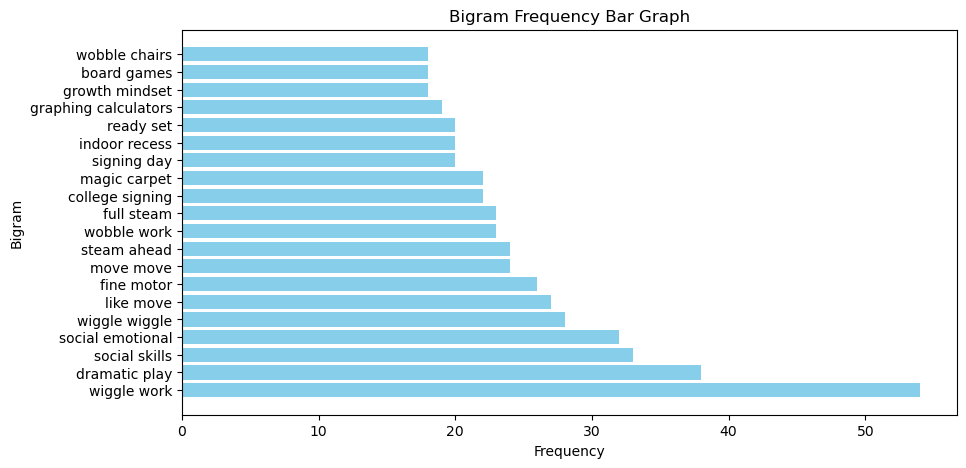

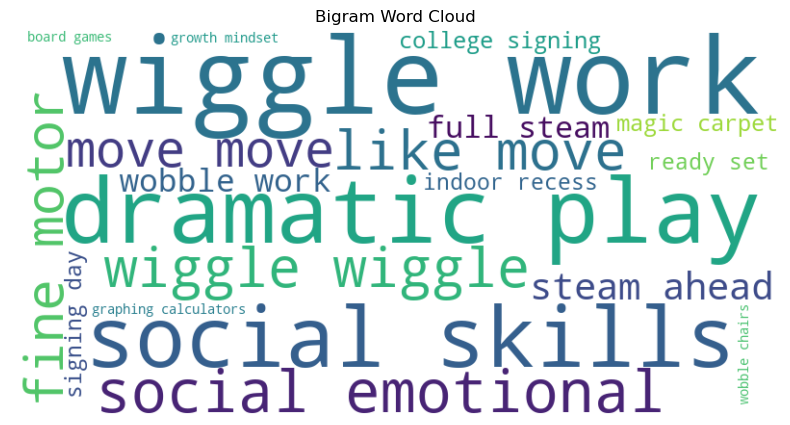

printing top 20 trigrams.....................
{('elevating', 'academics', 'parent'): 1, ('academics', 'parent', 'rapports'): 1, ('parent', 'rapports', 'technology'): 1, ('basic', 'supplies', 'needed'): 1, ('ipad', 'supplies', 'room'): 1, ('steam', 'technology', 'inquiry'): 1, ('technology', 'inquiry', 'based'): 1, ('behavior', 'technology', 'match'): 1, ('technology', 'match', 'made'): 1, ('match', 'made', 'heaven'): 1, ('sensory', 'toys', 'make'): 1, ('toys', 'make', 'sense'): 1, ('make', 'sense', 'world'): 1, ('wiggle', 'kinder', 'kids'): 1, ('fueling', 'bodies', 'minds'): 1, ('bodies', 'minds', 'right'): 1, ('minds', 'right', 'start'): 1, ('technology', 'environment', 'responsibility'): 1, ('super', 'star', 'graders'): 1, ('like', 'move', 'move'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  appliedlearning


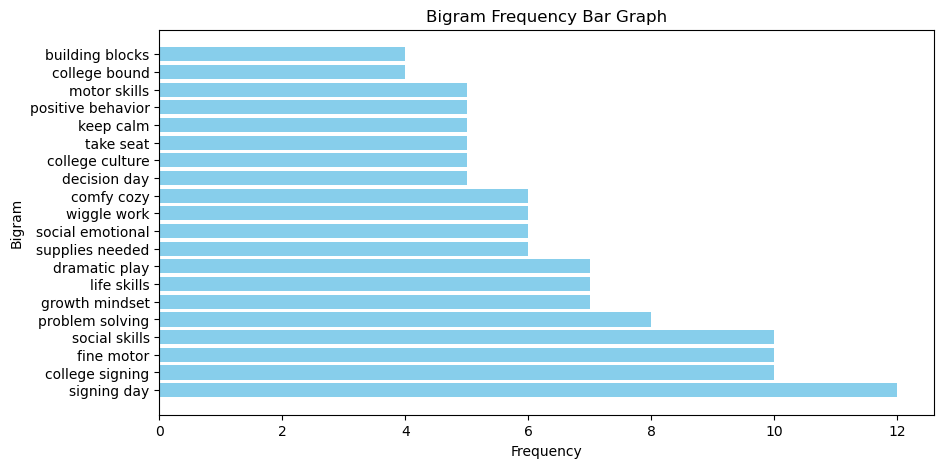

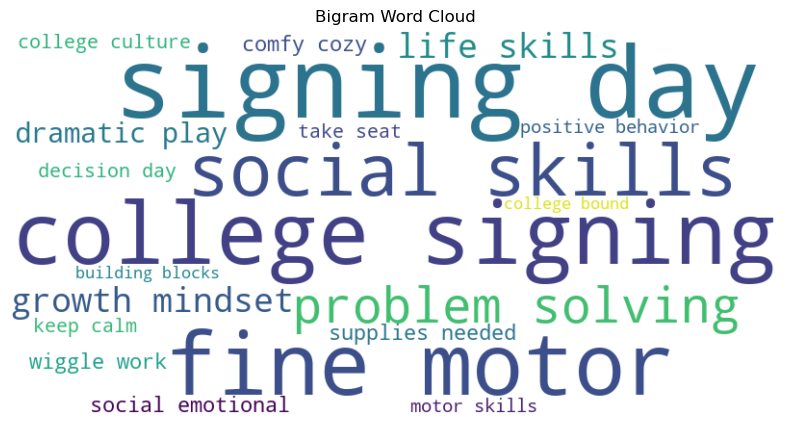

printing top 20 trigrams.....................
{('college', 'signing', 'day'): 1, ('signing', 'day', 'rally'): 1, ('day', 'rally', 'prizes'): 1, ('rally', 'prizes', 'deserving'): 1, ('growth', 'mindset', 'future'): 1, ('kindergarten', 'stem', 'stations'): 1, ('spreading', 'one', 'card'): 1, ('one', 'card', 'time'): 1, ('future', 'bright', 'technology'): 1, ('break', 'tech', 'cooperatively'): 1, ('creativity', 'critical', 'thinking'): 1, ('critical', 'thinking', 'interactive'): 1, ('thinking', 'interactive', 'technology'): 1, ('teaching', 'living', 'skills'): 1, ('living', 'skills', 'children'): 1, ('wish', 'list', 'year'): 1, ('oh', 'baby', 'parenting'): 1, ('baby', 'parenting', 'f'): 1, ('parenting', 'f', 'c'): 1, ('creative', 'sticky', 'murals'): 1}
#######################################################################################################
Approved cleaned_titles  arts


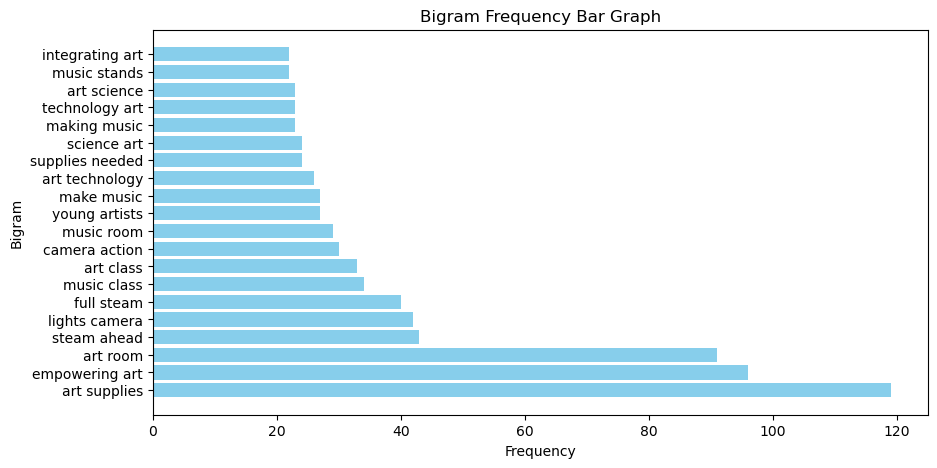

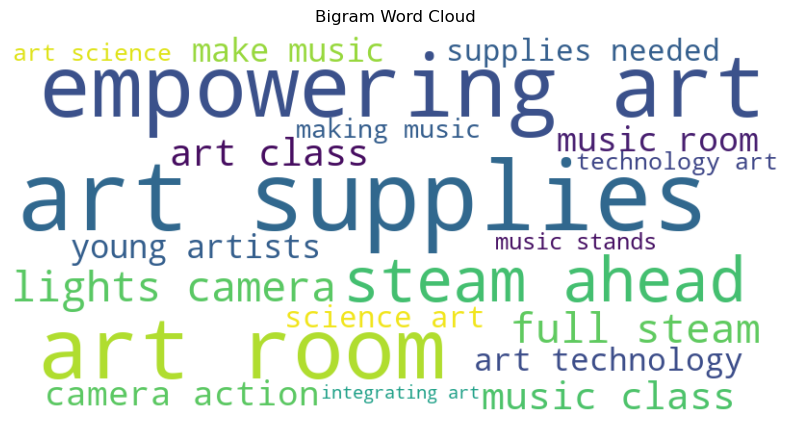

printing top 20 trigrams.....................
{('instrumental', 'power', 'conquering'): 1, ('power', 'conquering', 'steam'): 1, ('paper', 'ink', 'year'): 1, ('music', 'stands', 'benton'): 1, ('stands', 'benton', 'middle'): 1, ('benton', 'middle', 'band'): 1, ('paper', 'paper', 'paper'): 1, ('paper', 'paper', 'please'): 1, ('gone', 'chopin', 'bach'): 1, ('chopin', 'bach', 'five'): 1, ('without', 'string', 'world'): 1, ('string', 'world', 'silent'): 1, ('lego', 'robotics', 'programming'): 1, ('robotics', 'programming', 'resources'): 1, ('programming', 'resources', 'digital'): 1, ('resources', 'digital', 'media'): 1, ('digital', 'media', 'mics'): 1, ('hear', 'hear', 'heard'): 1, ('team', 'practices', 'make'): 1, ('practices', 'make', 'perfect'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  arts


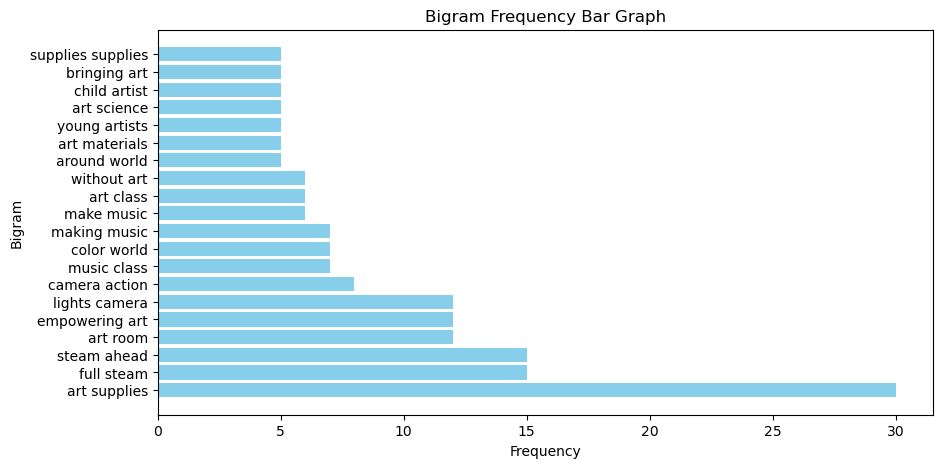

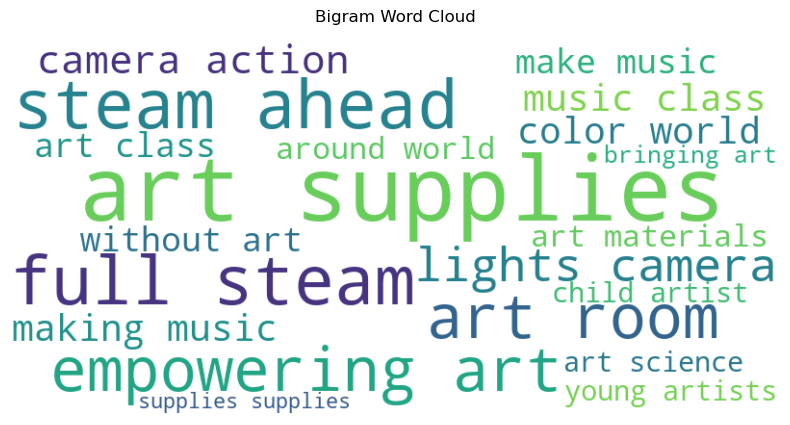

printing top 20 trigrams.....................
{('make', 'music', 'make'): 1, ('music', 'make', 'year'): 1, ('ceramics', 'history', 'clay'): 1, ('history', 'clay', 'sculpture'): 1, ('pick', 'play', 'tune'): 1, ('band', 'basics', 'create'): 1, ('basics', 'create', 'music'): 1, ('science', 'art', 'together'): 1, ('art', 'together', 'way'): 1, ('art', 'teaching', 'kids'): 1, ('teaching', 'kids', 'zen'): 1, ('kids', 'zen', 'art'): 1, ('creative', 'sticky', 'murals'): 1, ('immerse', 'art', 'class'): 1, ('art', 'class', 'watercolors'): 1, ('draw', '3d', 'doodle'): 1, ('3d', 'doodle', 'pens'): 1, ('lets', 'spreading', 'music'): 1, ('drumming', 'around', 'world'): 1, ('height', 'width', 'depth'): 1}
#######################################################################################################
Approved cleaned_titles  care


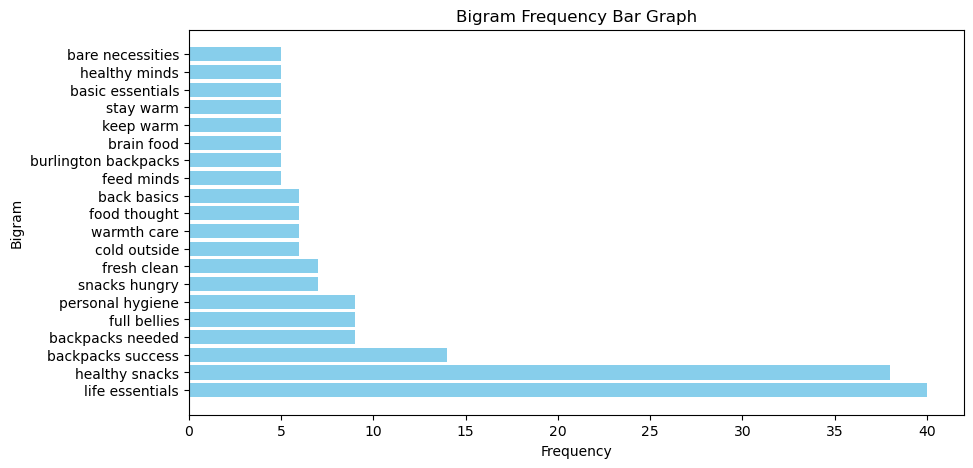

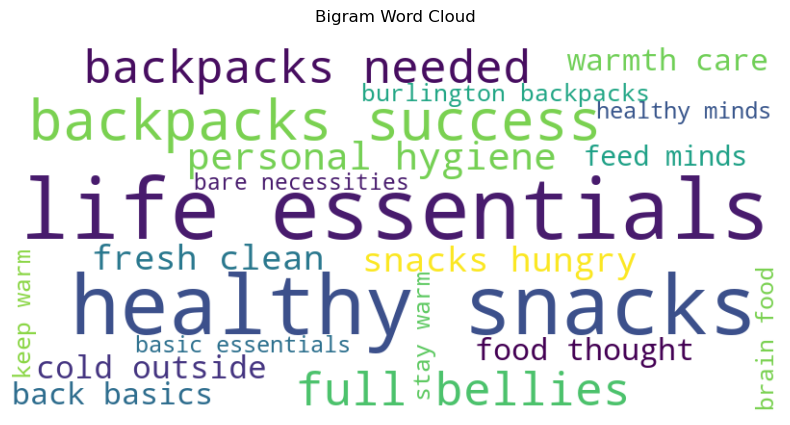

printing top 20 trigrams.....................
{('keep', 'closet', 'open'): 1, ('clean', 'tidy', 'ready'): 1, ('taking', 'care', 'bodies'): 1, ('care', 'bodies', 'one'): 1, ('bodies', 'one', 'less'): 1, ('one', 'less', 'concern'): 1, ('tummies', 'rumble', 'empty'): 1, ('right', 'track', 'backpacks'): 1, ('feed', 'minds', 'hungry'): 1, ('minds', 'hungry', 'snacks'): 1, ('burlington', 'backpacks', 'win'): 1, ('backpacks', 'organized', 'scholars'): 1, ('keeping', 'teeth', 'clean'): 1, ('teeth', 'clean', 'stomachs'): 1, ('clean', 'stomachs', 'full'): 1, ('essential', 'snack', 'hungry'): 1, ('start', 'day', 'supplying'): 1, ('day', 'supplying', 'life'): 1, ('supplying', 'life', 'essentials'): 1, ('life', 'essentials', 'children'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  care


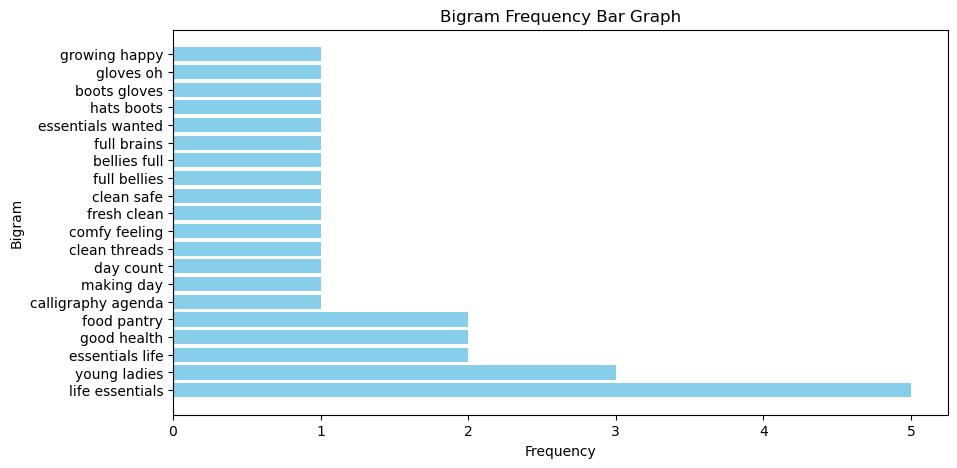

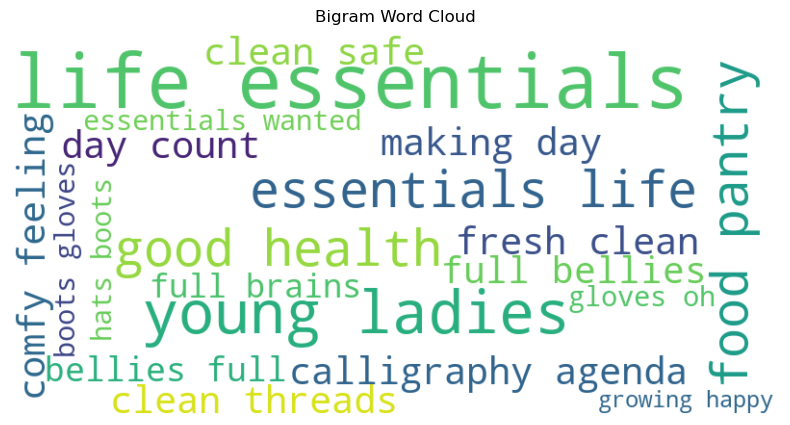

printing top 20 trigrams.....................
{('making', 'day', 'count'): 1, ('fresh', 'clean', 'safe'): 1, ('full', 'bellies', 'full'): 1, ('bellies', 'full', 'brains'): 1, ('hats', 'boots', 'gloves'): 1, ('boots', 'gloves', 'oh'): 1, ('growing', 'happy', 'kids'): 1, ('happy', 'kids', 'positive'): 1, ('kids', 'positive', 'mindset'): 1, ('4th', 'organizers', 'supplies'): 1, ('survival', 'skill', 'preschool'): 1, ('setting', 'successful', 'environment'): 1, ('health', 'hygiene', 'happiness'): 1, ('clean', 'healthy', 'kids'): 1, ('magic', 'carpet', 'ride'): 1, ('loving', 'litter', 'bugs'): 1, ('wearing', 'chinese', 'chinese'): 1, ('jet', 'fuel', 'super'): 1, ('fuel', 'super', 'rocket'): 1, ('super', 'rocket', 'scholars'): 1}
#######################################################################################################
Approved cleaned_titles  civics


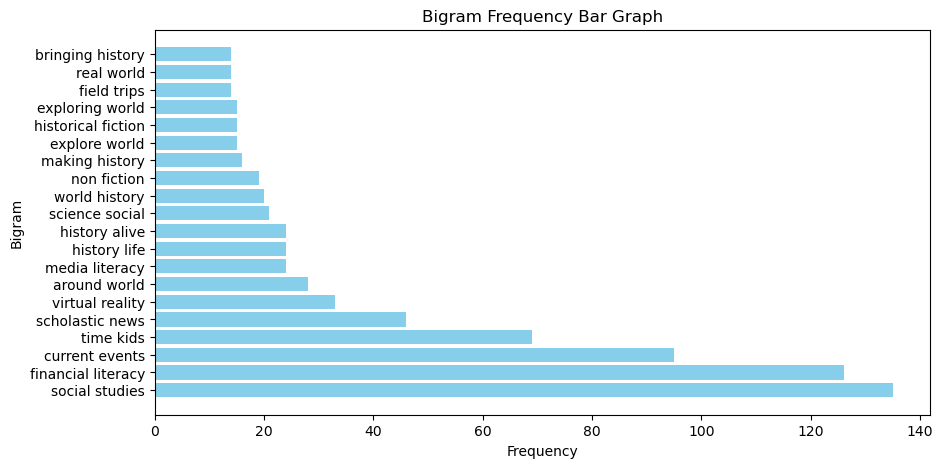

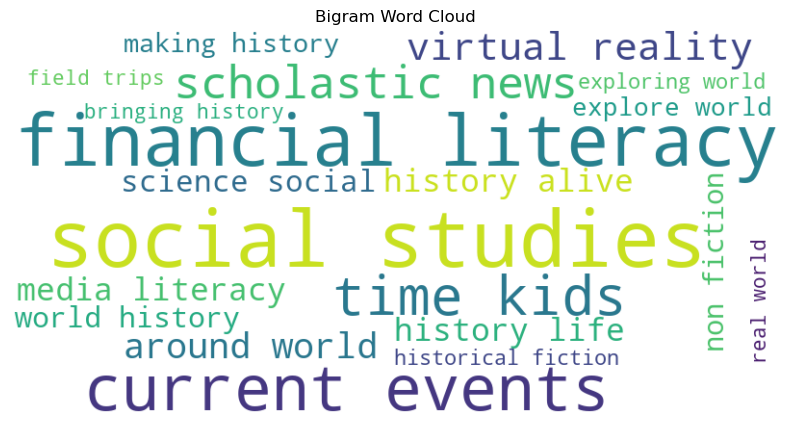

printing top 20 trigrams.....................
{('wanted', 'projector', 'hungry'): 1, ('computing', 'way', 'financial'): 1, ('way', 'financial', 'literacy'): 1, ('financial', 'literacy', 'part'): 1, ('global', 'taking', 'lead'): 1, ('history', 'comes', 'life'): 1, ('comes', 'life', 'mrs'): 1, ('life', 'mrs', 'butler'): 1, ('mrs', 'butler', '5th'): 1, ('butler', '5th', 'class'): 1, ('globe', 'gazing', 'want'): 1, ('gazing', 'want', 'see'): 1, ('want', 'see', 'world'): 1, ('little', 'wiggle', 'room'): 1, ('amplifying', 'one', 'ipad'): 1, ('one', 'ipad', 'time'): 1, ('classics', 'class', 'disappear'): 1, ('class', 'disappear', 'forever'): 1, ('technology', 'one', 'ipad'): 1, ('mrs', 'esposito', 'class'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  civics


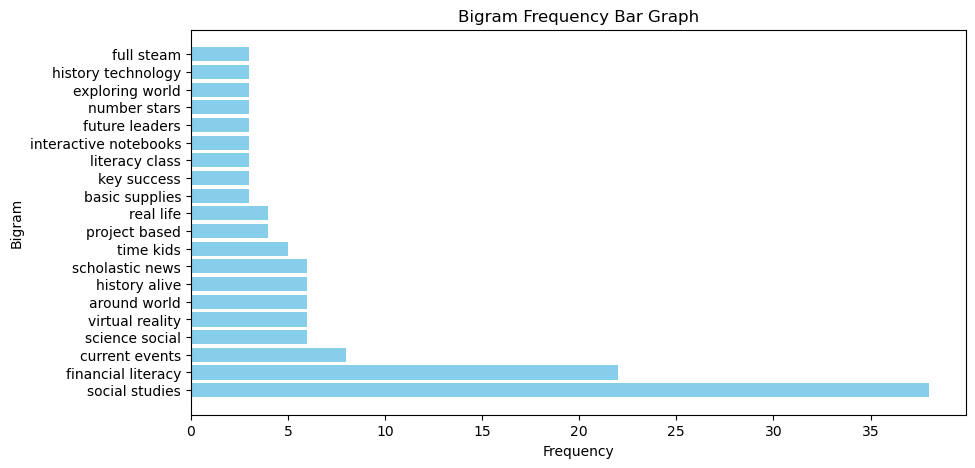

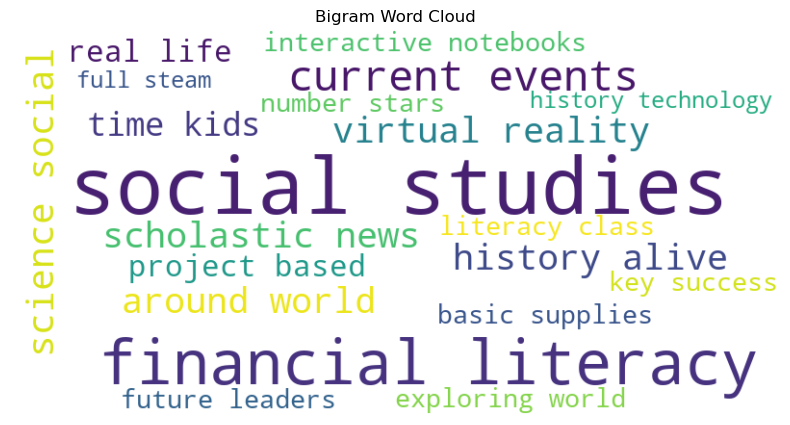

printing top 20 trigrams.....................
{('national', 'parks', 'outer'): 1, ('parks', 'outer', 'space'): 1, ('time', 'graduate', 'textbook'): 1, ('green', 'screen', 'projects'): 1, ('screen', 'projects', 'wanted'): 1, ('virtual', 'field', 'trips'): 1, ('field', 'trips', 'kg'): 1, ('trips', 'kg', 'kids'): 1, ('revelance', 'makes', 'life'): 1, ('makes', 'life', 'long'): 1, ('humane', 'education', 'boston'): 1, ('bringing', 'colonies', 'america'): 1, ('art', 'debate', 'enhanced'): 1, ('debate', 'enhanced', 'technology'): 1, ('real', 'lives', 'watts'): 1, ('mrs', 'cemo', 'class'): 1, ('cemo', 'class', 'organization'): 1, ('class', 'organization', 'project'): 1, ('outbreak', 'united', 'united'): 1, ('united', 'united', 'initiative'): 1}
#######################################################################################################
Approved cleaned_titles  health


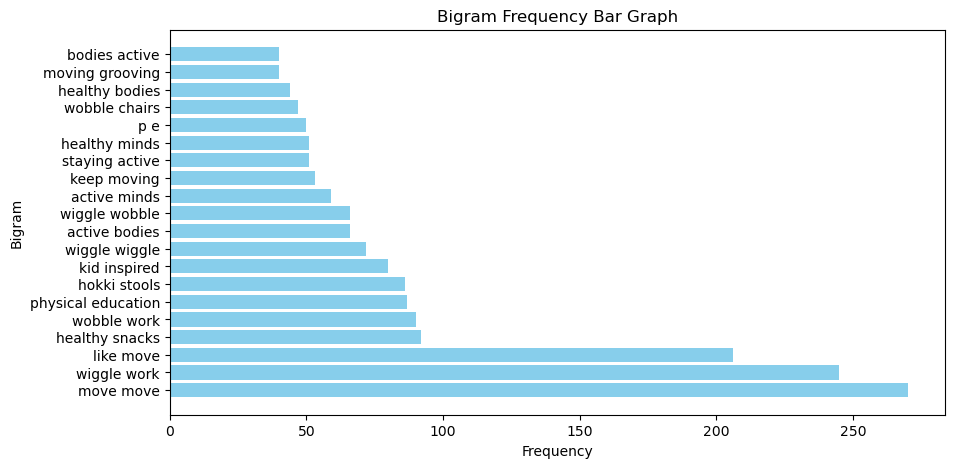

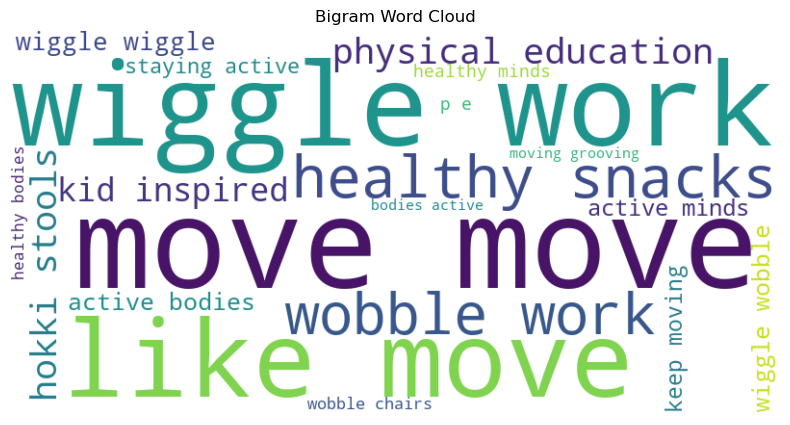

printing top 20 trigrams.....................
{('wanted', 'projector', 'hungry'): 1, ('targeting', 'success', 'class'): 1, ('making', 'recess', 'active'): 1, ('wiggling', 'way', 'success'): 1, ('target', 'kids', 'printer'): 1, ('kids', 'printer', 'ink'): 1, ('kinders', 'inspired', 'target'): 1, ('inspired', 'target', 'fitness'): 1, ('target', 'fitness', 'part'): 1, ('fitness', 'part', 'one'): 1, ('rainy', 'day', 'run'): 1, ('day', 'run', 'around'): 1, ('swim', 'life', 'ymca'): 1, ('picnic', 'table', 'make'): 1, ('table', 'make', 'able'): 1, ('targeting', 'baseball', 'hitting'): 1, ('baseball', 'hitting', 'bulls'): 1, ('hitting', 'bulls', 'eye'): 1, ('chicka', 'chicka', 'boom'): 1, ('chicka', 'boom', 'boom'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  health


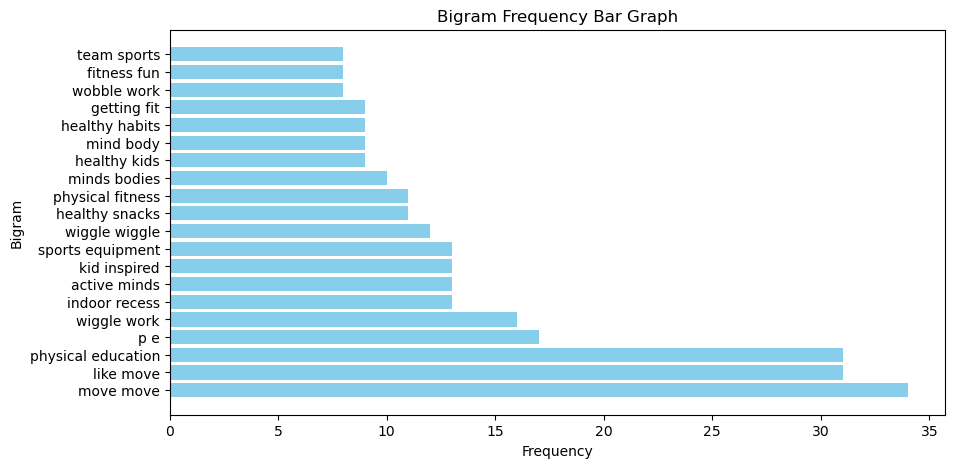

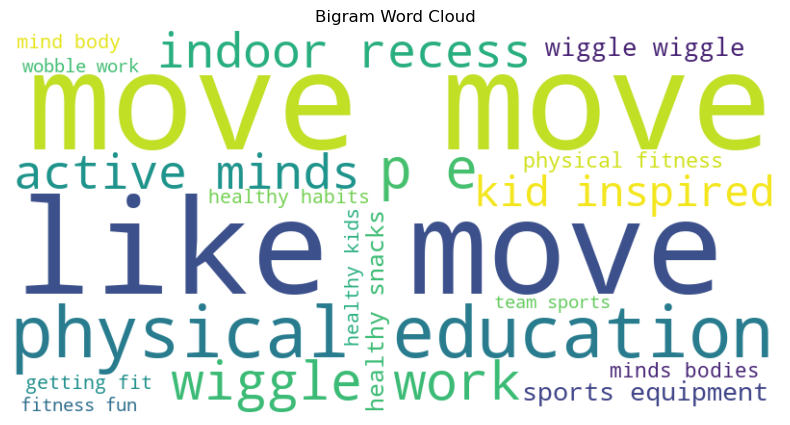

printing top 20 trigrams.....................
{('soccer', 'equipment', 'awesome'): 1, ('equipment', 'awesome', 'middle'): 1, ('fun', 'physically', 'fit'): 1, ('healthy', 'snack', 'attacks'): 1, ('like', 'move', 'move'): 1, ('oodles', 'outdoor', 'fun'): 1, ('ifit', 'going', 'gold'): 1, ('going', 'gold', 'part'): 1, ('gold', 'part', 'ii'): 1, ('getting', 'staying', 'healthy'): 1, ('art', 'teaching', 'kids'): 1, ('teaching', 'kids', 'zen'): 1, ('kids', 'zen', 'art'): 1, ('keep', 'garden', 'alive'): 1, ('garden', 'alive', 'thriving'): 1, ('play', 'adapted', 'sports'): 1, ('never', 'young', 'healthy'): 1, ('reaching', 'goals', 'fitness'): 1, ('goals', 'fitness', 'mindfulness'): 1, ('live', 'oak', 'eagle'): 1}
#######################################################################################################
Approved cleaned_titles  history


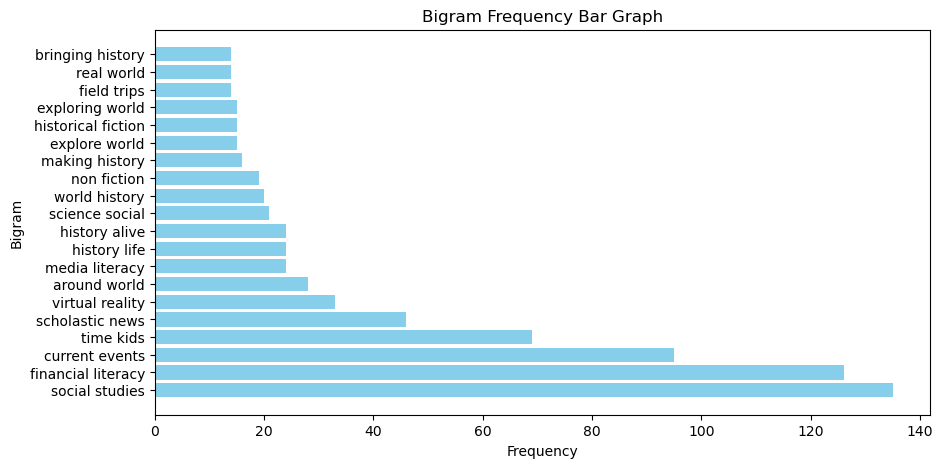

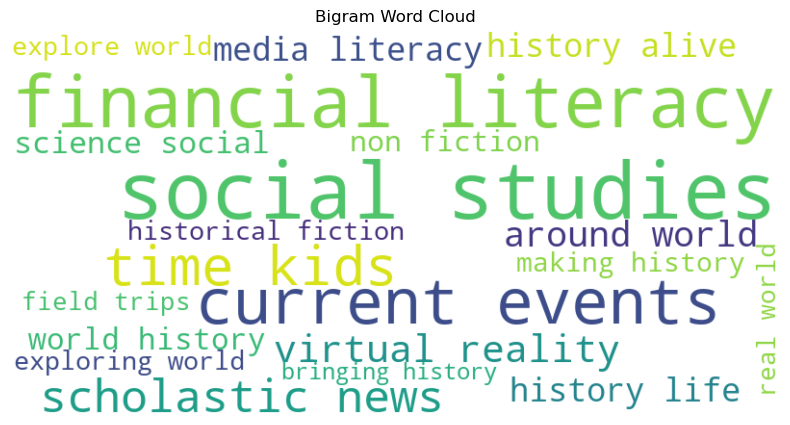

printing top 20 trigrams.....................
{('wanted', 'projector', 'hungry'): 1, ('computing', 'way', 'financial'): 1, ('way', 'financial', 'literacy'): 1, ('financial', 'literacy', 'part'): 1, ('global', 'taking', 'lead'): 1, ('history', 'comes', 'life'): 1, ('comes', 'life', 'mrs'): 1, ('life', 'mrs', 'butler'): 1, ('mrs', 'butler', '5th'): 1, ('butler', '5th', 'class'): 1, ('globe', 'gazing', 'want'): 1, ('gazing', 'want', 'see'): 1, ('want', 'see', 'world'): 1, ('little', 'wiggle', 'room'): 1, ('amplifying', 'one', 'ipad'): 1, ('one', 'ipad', 'time'): 1, ('classics', 'class', 'disappear'): 1, ('class', 'disappear', 'forever'): 1, ('technology', 'one', 'ipad'): 1, ('mrs', 'esposito', 'class'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  history


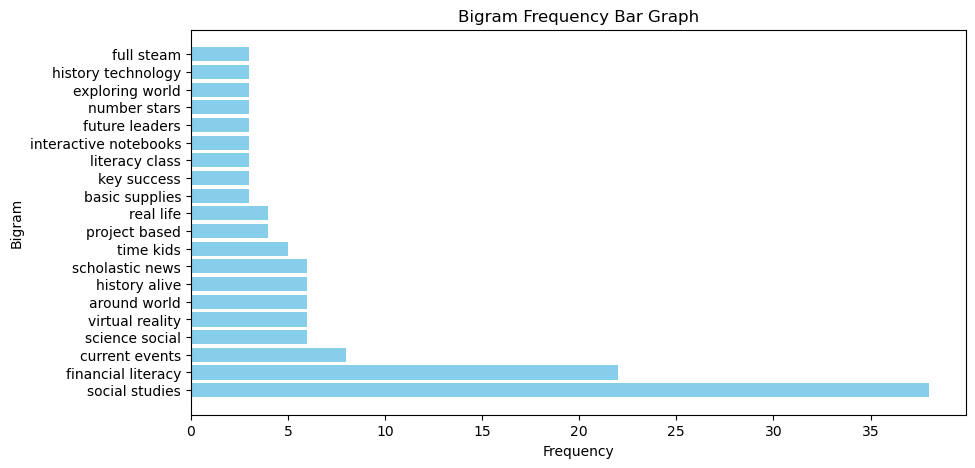

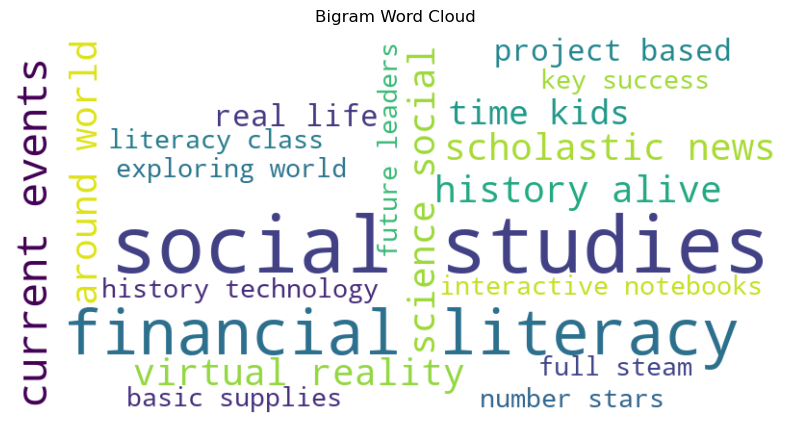

printing top 20 trigrams.....................
{('national', 'parks', 'outer'): 1, ('parks', 'outer', 'space'): 1, ('time', 'graduate', 'textbook'): 1, ('green', 'screen', 'projects'): 1, ('screen', 'projects', 'wanted'): 1, ('virtual', 'field', 'trips'): 1, ('field', 'trips', 'kg'): 1, ('trips', 'kg', 'kids'): 1, ('revelance', 'makes', 'life'): 1, ('makes', 'life', 'long'): 1, ('humane', 'education', 'boston'): 1, ('bringing', 'colonies', 'america'): 1, ('art', 'debate', 'enhanced'): 1, ('debate', 'enhanced', 'technology'): 1, ('real', 'lives', 'watts'): 1, ('mrs', 'cemo', 'class'): 1, ('cemo', 'class', 'organization'): 1, ('class', 'organization', 'project'): 1, ('outbreak', 'united', 'united'): 1, ('united', 'united', 'initiative'): 1}
#######################################################################################################
Approved cleaned_titles  hunger


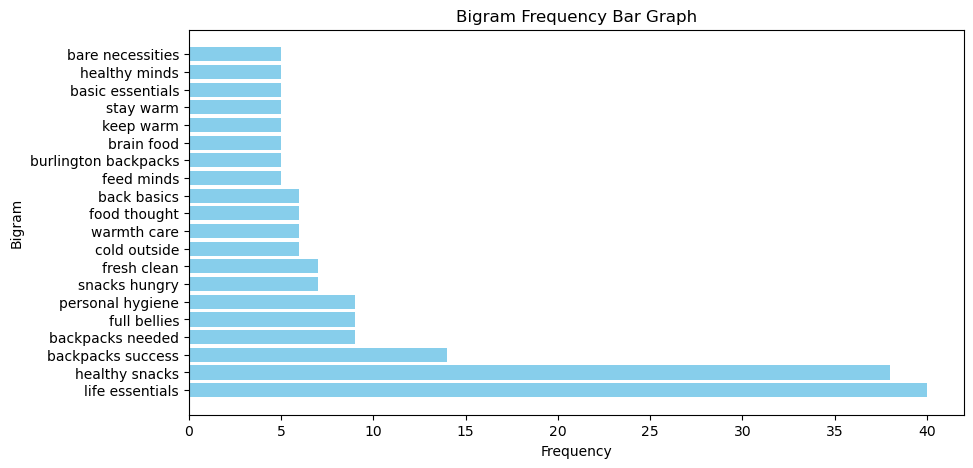

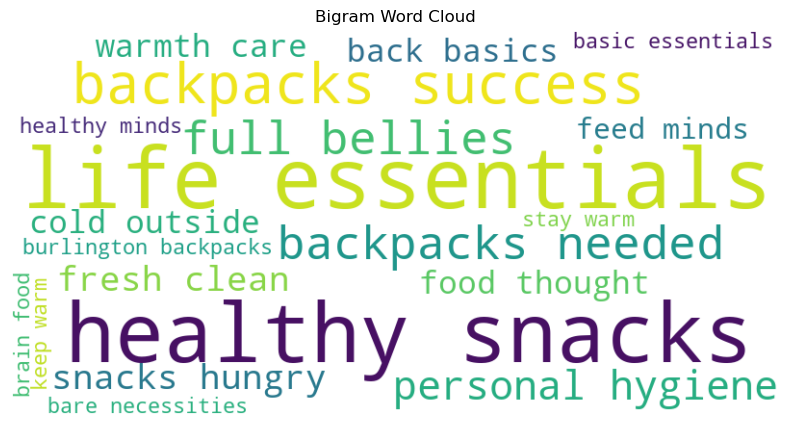

printing top 20 trigrams.....................
{('keep', 'closet', 'open'): 1, ('clean', 'tidy', 'ready'): 1, ('taking', 'care', 'bodies'): 1, ('care', 'bodies', 'one'): 1, ('bodies', 'one', 'less'): 1, ('one', 'less', 'concern'): 1, ('tummies', 'rumble', 'empty'): 1, ('right', 'track', 'backpacks'): 1, ('feed', 'minds', 'hungry'): 1, ('minds', 'hungry', 'snacks'): 1, ('burlington', 'backpacks', 'win'): 1, ('backpacks', 'organized', 'scholars'): 1, ('keeping', 'teeth', 'clean'): 1, ('teeth', 'clean', 'stomachs'): 1, ('clean', 'stomachs', 'full'): 1, ('essential', 'snack', 'hungry'): 1, ('start', 'day', 'supplying'): 1, ('day', 'supplying', 'life'): 1, ('supplying', 'life', 'essentials'): 1, ('life', 'essentials', 'children'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  hunger


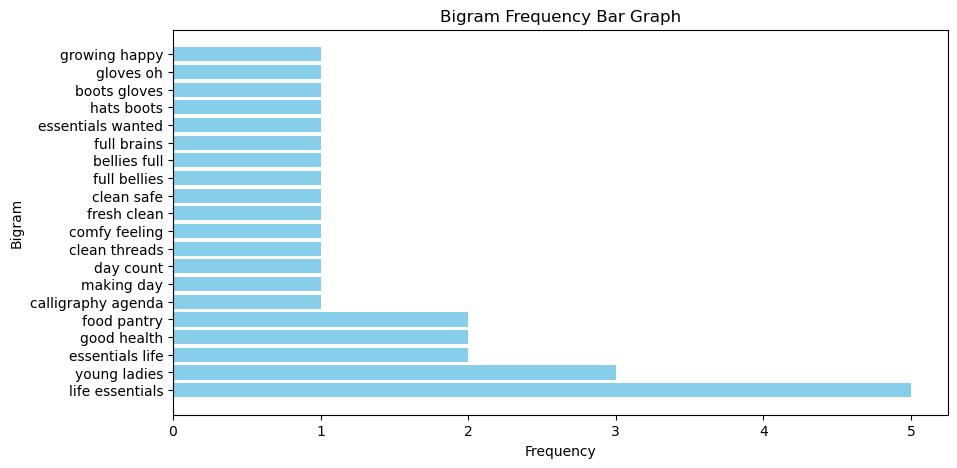

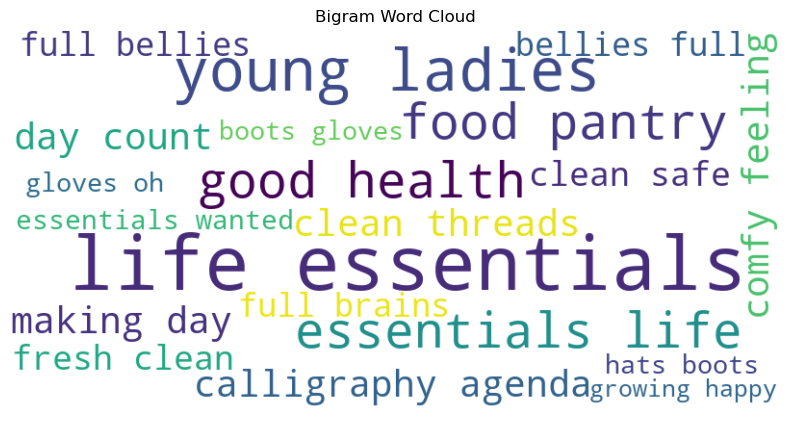

printing top 20 trigrams.....................
{('making', 'day', 'count'): 1, ('fresh', 'clean', 'safe'): 1, ('full', 'bellies', 'full'): 1, ('bellies', 'full', 'brains'): 1, ('hats', 'boots', 'gloves'): 1, ('boots', 'gloves', 'oh'): 1, ('growing', 'happy', 'kids'): 1, ('happy', 'kids', 'positive'): 1, ('kids', 'positive', 'mindset'): 1, ('4th', 'organizers', 'supplies'): 1, ('survival', 'skill', 'preschool'): 1, ('setting', 'successful', 'environment'): 1, ('health', 'hygiene', 'happiness'): 1, ('clean', 'healthy', 'kids'): 1, ('magic', 'carpet', 'ride'): 1, ('loving', 'litter', 'bugs'): 1, ('wearing', 'chinese', 'chinese'): 1, ('jet', 'fuel', 'super'): 1, ('fuel', 'super', 'rocket'): 1, ('super', 'rocket', 'scholars'): 1}
#######################################################################################################
Approved cleaned_titles  language


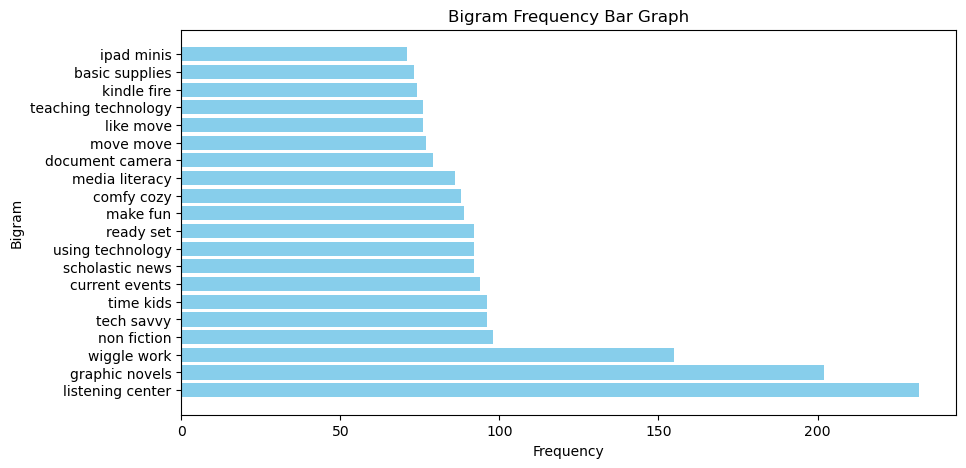

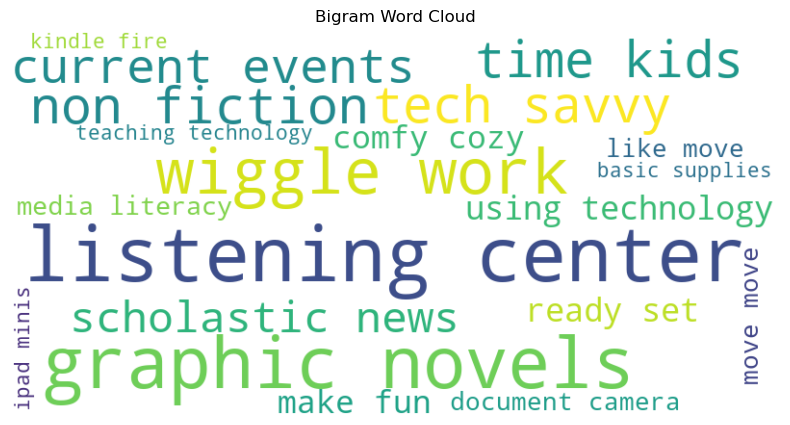

printing top 20 trigrams.....................
{('mrs', 'jarvis', 'terrific'): 1, ('jarvis', 'terrific', 'third'): 1, ('terrific', 'third', 'graders'): 1, ('chromebooks', 'education', 'program'): 1, ('elevating', 'academics', 'parent'): 1, ('academics', 'parent', 'rapports'): 1, ('parent', 'rapports', 'technology'): 1, ('making', 'great', 'leap'): 1, ('great', 'leap', 'leapfrog'): 1, ('technology', 'teaches', 'tomorrow'): 1, ('teaches', 'tomorrow', 'talents'): 1, ('tomorrow', 'talents', 'today'): 1, ('magic', 'carpet', 'ride'): 1, ('4th', 'french', 'immersion'): 1, ('french', 'immersion', 'class'): 1, ('immersion', 'class', 'ipads'): 1, ('basic', 'supplies', 'needed'): 1, ('2nd', 'explores', 'world'): 1, ('explores', 'world', 'charlotte'): 1, ('world', 'charlotte', 'web'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  language


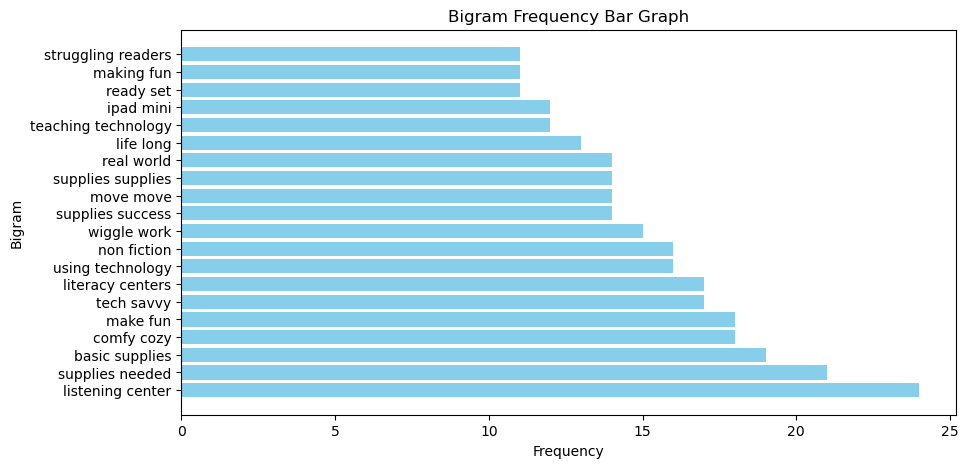

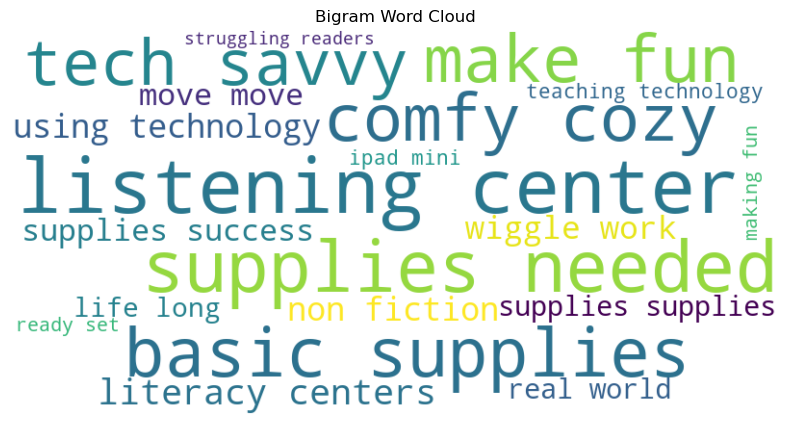

printing top 20 trigrams.....................
{('educational', 'support', 'home'): 1, ('tablets', 'show', 'world'): 1, ('leveling', 'multi', 'age'): 1, ('multi', 'age', 'class'): 1, ('paper', 'pencils', 'markers'): 1, ('pencils', 'markers', 'oh'): 1, ('1st', 'graders', 'reaching'): 1, ('graders', 'reaching', 'stars'): 1, ('reaching', 'stars', 'writing'): 1, ('writer', 'workshop', '1st'): 1, ('workshop', '1st', 'authors'): 1, ('words', 'listening', 'weekly'): 1, ('alternative', 'comfy', 'classrooms'): 1, ('7th', 'action', 'researchers'): 1, ('open', 'window', 'technology'): 1, ('go', 'go', 'google'): 1, ('go', 'google', 'gadgets'): 1, ('amazing', 'work', 'binders'): 1, ('optimizing', 'growth', 'accelerated'): 1, ('growth', 'accelerated', 'reader'): 1}
#######################################################################################################
Approved cleaned_titles  literacy


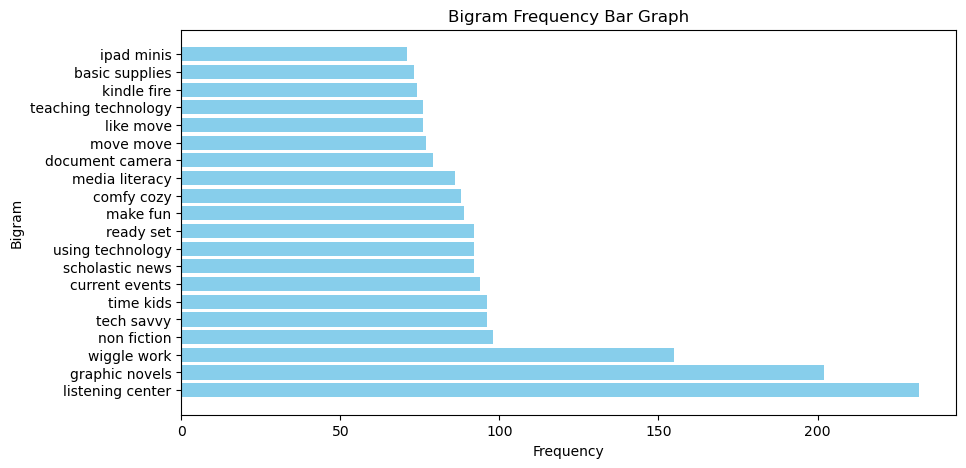

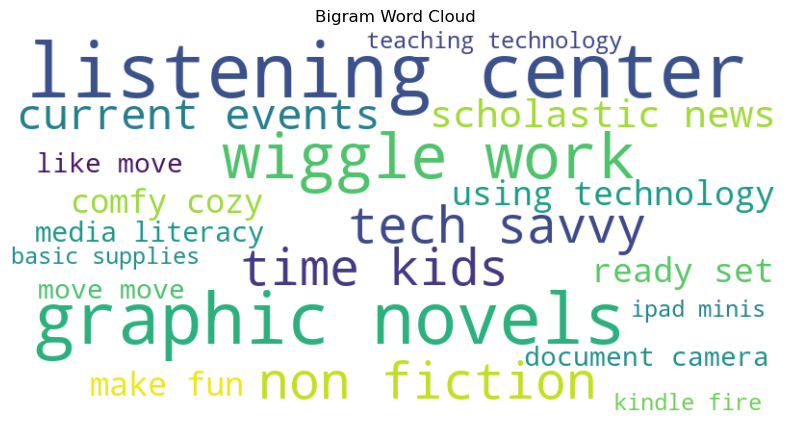

printing top 20 trigrams.....................
{('mrs', 'jarvis', 'terrific'): 1, ('jarvis', 'terrific', 'third'): 1, ('terrific', 'third', 'graders'): 1, ('chromebooks', 'education', 'program'): 1, ('elevating', 'academics', 'parent'): 1, ('academics', 'parent', 'rapports'): 1, ('parent', 'rapports', 'technology'): 1, ('making', 'great', 'leap'): 1, ('great', 'leap', 'leapfrog'): 1, ('technology', 'teaches', 'tomorrow'): 1, ('teaches', 'tomorrow', 'talents'): 1, ('tomorrow', 'talents', 'today'): 1, ('magic', 'carpet', 'ride'): 1, ('4th', 'french', 'immersion'): 1, ('french', 'immersion', 'class'): 1, ('immersion', 'class', 'ipads'): 1, ('basic', 'supplies', 'needed'): 1, ('2nd', 'explores', 'world'): 1, ('explores', 'world', 'charlotte'): 1, ('world', 'charlotte', 'web'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  literacy


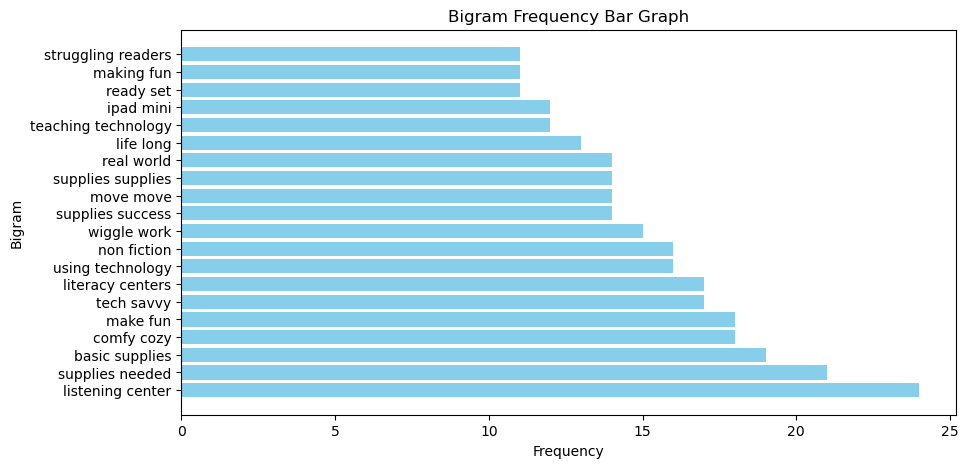

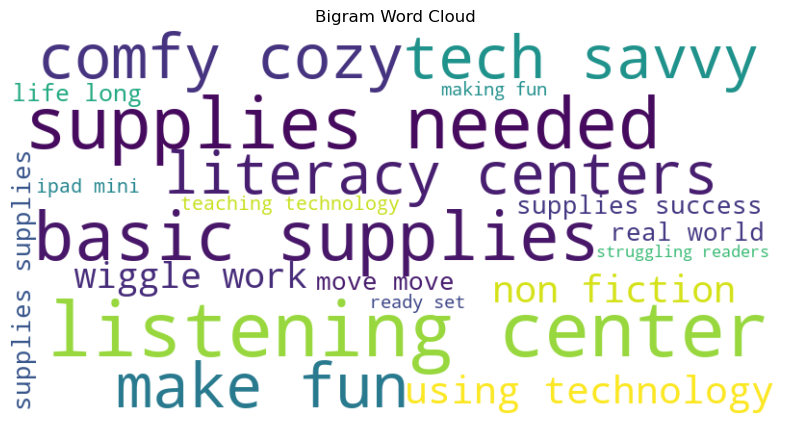

printing top 20 trigrams.....................
{('educational', 'support', 'home'): 1, ('tablets', 'show', 'world'): 1, ('leveling', 'multi', 'age'): 1, ('multi', 'age', 'class'): 1, ('paper', 'pencils', 'markers'): 1, ('pencils', 'markers', 'oh'): 1, ('1st', 'graders', 'reaching'): 1, ('graders', 'reaching', 'stars'): 1, ('reaching', 'stars', 'writing'): 1, ('writer', 'workshop', '1st'): 1, ('workshop', '1st', 'authors'): 1, ('words', 'listening', 'weekly'): 1, ('alternative', 'comfy', 'classrooms'): 1, ('7th', 'action', 'researchers'): 1, ('open', 'window', 'technology'): 1, ('go', 'go', 'google'): 1, ('go', 'google', 'gadgets'): 1, ('amazing', 'work', 'binders'): 1, ('optimizing', 'growth', 'accelerated'): 1, ('growth', 'accelerated', 'reader'): 1}
#######################################################################################################
Approved cleaned_titles  math


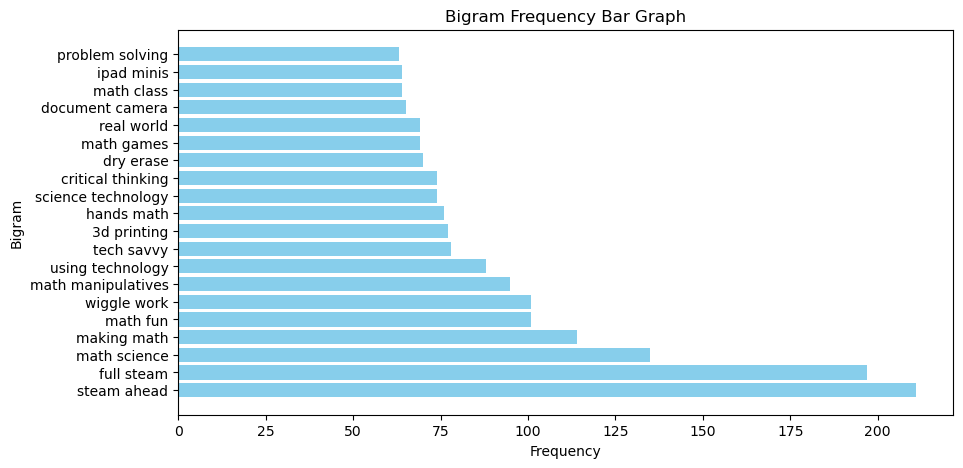

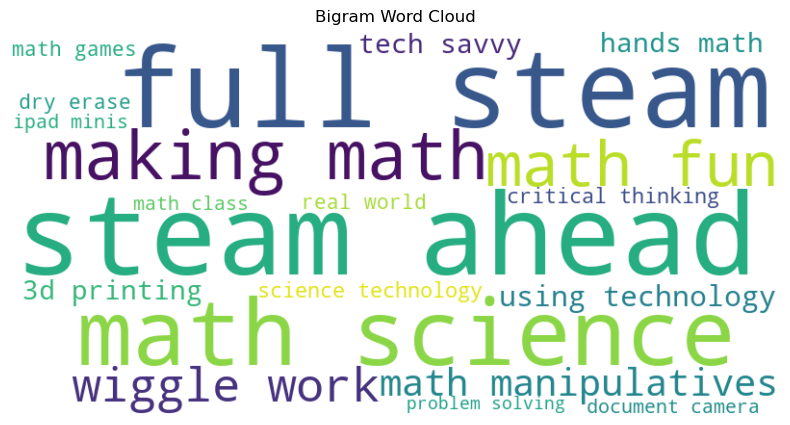

printing top 20 trigrams.....................
{('interactive', 'math', 'tools'): 1, ('technology', 'teaches', 'tomorrow'): 1, ('teaches', 'tomorrow', 'talents'): 1, ('tomorrow', 'talents', 'today'): 1, ('e', 'challenges', 'science'): 1, ('challenges', 'science', 'technology'): 1, ('science', 'technology', 'engineering'): 1, ('technology', 'engineering', 'art'): 1, ('engineering', 'art', 'math'): 1, ('4th', 'french', 'immersion'): 1, ('french', 'immersion', 'class'): 1, ('immersion', 'class', 'ipads'): 1, ('inquiry', 'based', 'discovery'): 1, ('based', 'discovery', 'laptop'): 1, ('pressing', 'mastery', 'flood'): 1, ('forming', 'magnificent', 'minds'): 1, ('technology', 'engineering', 'math'): 1, ('engineering', 'math', 'oh'): 1, ('math', 'oh', 'kinder'): 1, ('oh', 'kinder', 'stem'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  math


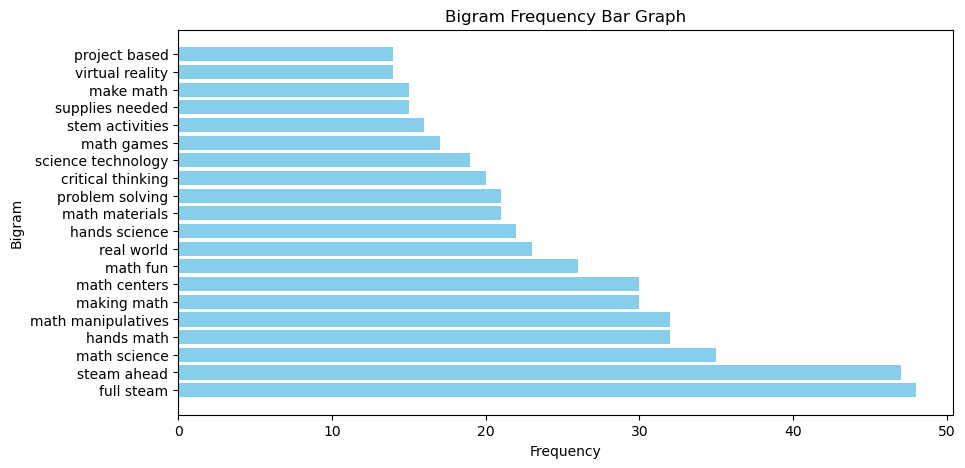

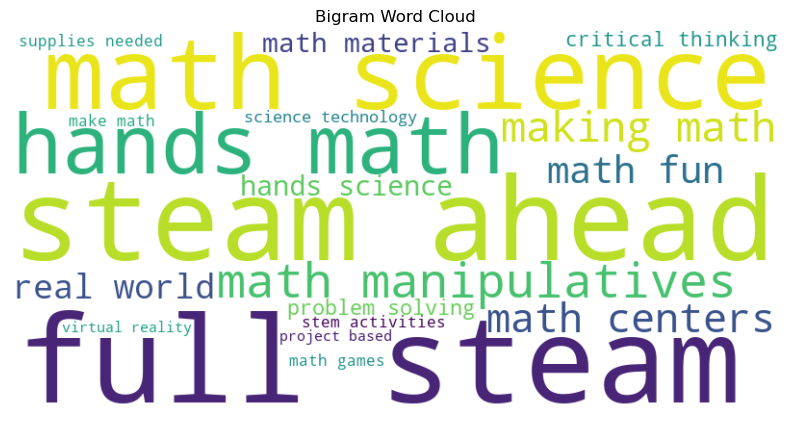

printing top 20 trigrams.....................
{('building', 'life', 'science'): 1, ('life', 'science', 'experiences'): 1, ('stem', 'capitalize', 'technology'): 1, ('stem', 'made', 'simple'): 1, ('made', 'simple', 'sensible'): 1, ('simple', 'sensible', 'integrated'): 1, ('sensible', 'integrated', 'meaningful'): 1, ('integrated', 'meaningful', 'purposeful'): 1, ('meaningful', 'purposeful', 'engaging'): 1, ('immersion', 'trip', 'outdoor'): 1, ('trip', 'outdoor', 'gear'): 1, ('kindergarten', 'stem', 'stations'): 1, ('national', 'parks', 'outer'): 1, ('parks', 'outer', 'space'): 1, ('becoming', 'architects', 'engineers'): 1, ('architects', 'engineers', 'builders'): 1, ('engineers', 'builders', 'age'): 1, ('open', 'window', 'technology'): 1, ('go', 'go', 'google'): 1, ('go', 'google', 'gadgets'): 1}
#######################################################################################################
Approved cleaned_titles  music


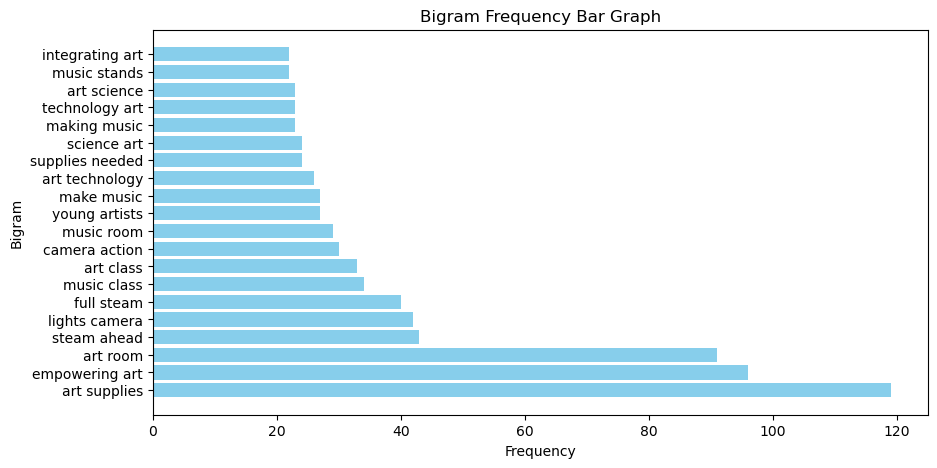

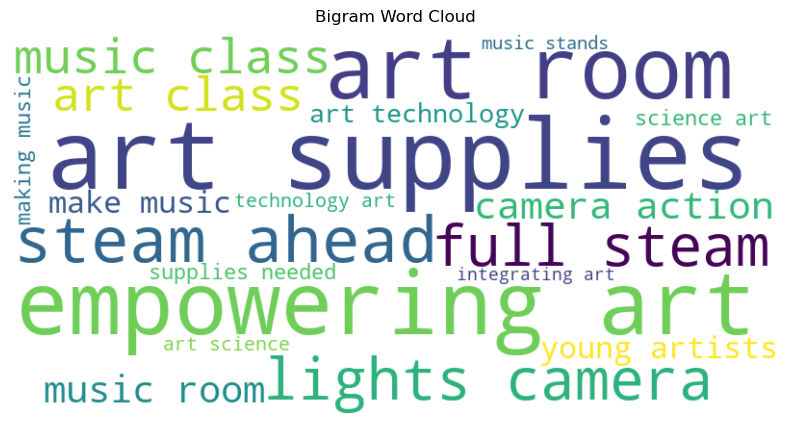

printing top 20 trigrams.....................
{('instrumental', 'power', 'conquering'): 1, ('power', 'conquering', 'steam'): 1, ('paper', 'ink', 'year'): 1, ('music', 'stands', 'benton'): 1, ('stands', 'benton', 'middle'): 1, ('benton', 'middle', 'band'): 1, ('paper', 'paper', 'paper'): 1, ('paper', 'paper', 'please'): 1, ('gone', 'chopin', 'bach'): 1, ('chopin', 'bach', 'five'): 1, ('without', 'string', 'world'): 1, ('string', 'world', 'silent'): 1, ('lego', 'robotics', 'programming'): 1, ('robotics', 'programming', 'resources'): 1, ('programming', 'resources', 'digital'): 1, ('resources', 'digital', 'media'): 1, ('digital', 'media', 'mics'): 1, ('hear', 'hear', 'heard'): 1, ('team', 'practices', 'make'): 1, ('practices', 'make', 'perfect'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  music


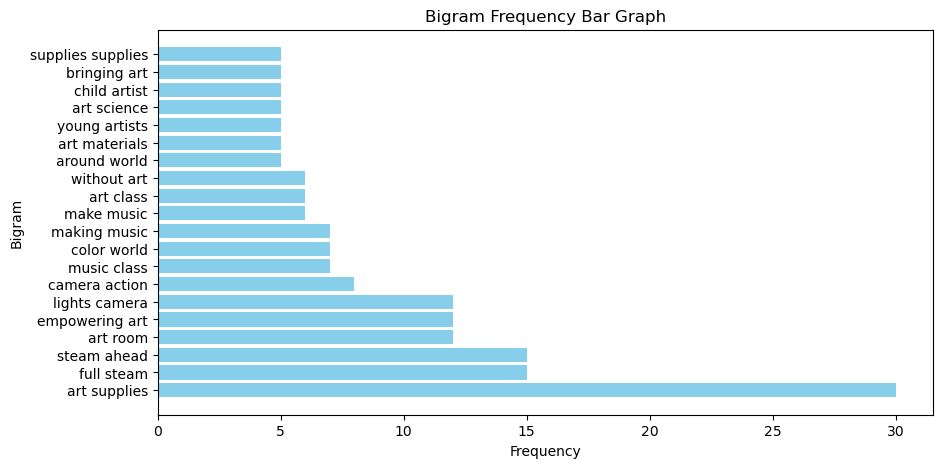

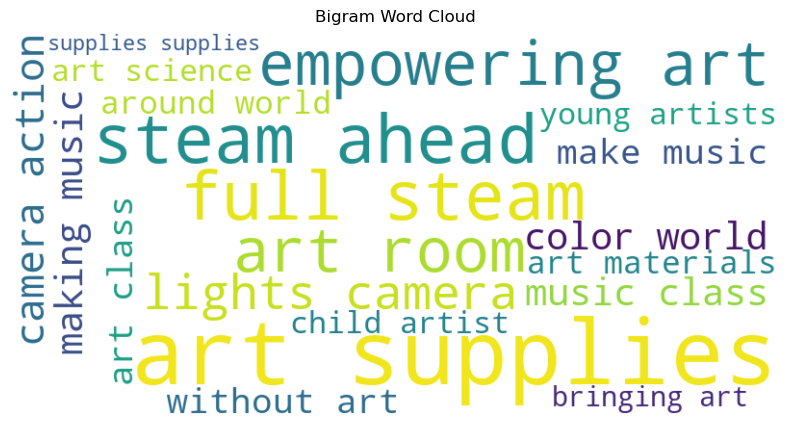

printing top 20 trigrams.....................
{('make', 'music', 'make'): 1, ('music', 'make', 'year'): 1, ('ceramics', 'history', 'clay'): 1, ('history', 'clay', 'sculpture'): 1, ('pick', 'play', 'tune'): 1, ('band', 'basics', 'create'): 1, ('basics', 'create', 'music'): 1, ('science', 'art', 'together'): 1, ('art', 'together', 'way'): 1, ('art', 'teaching', 'kids'): 1, ('teaching', 'kids', 'zen'): 1, ('kids', 'zen', 'art'): 1, ('creative', 'sticky', 'murals'): 1, ('immerse', 'art', 'class'): 1, ('art', 'class', 'watercolors'): 1, ('draw', '3d', 'doodle'): 1, ('3d', 'doodle', 'pens'): 1, ('lets', 'spreading', 'music'): 1, ('drumming', 'around', 'world'): 1, ('height', 'width', 'depth'): 1}
#######################################################################################################
Approved cleaned_titles  science


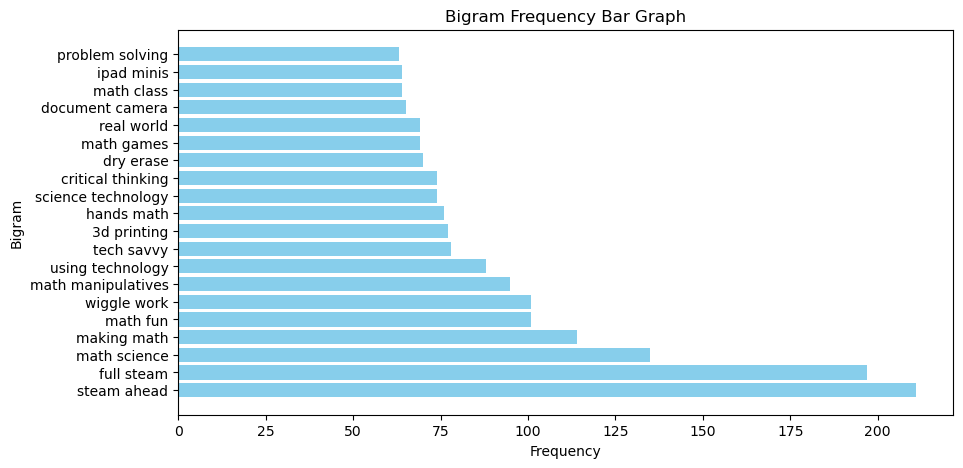

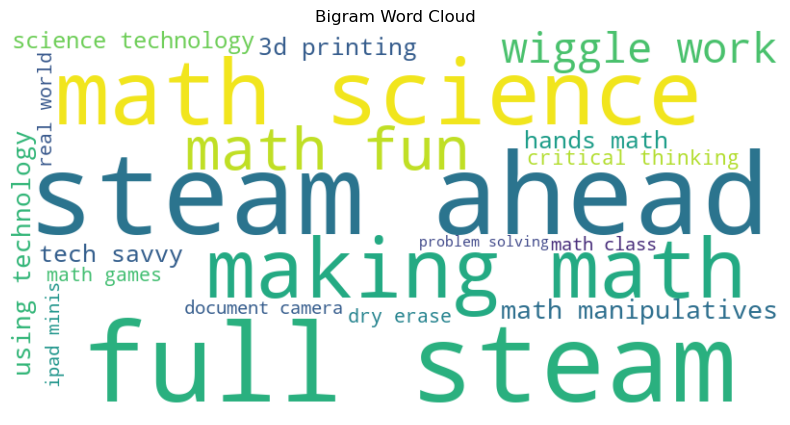

printing top 20 trigrams.....................
{('interactive', 'math', 'tools'): 1, ('technology', 'teaches', 'tomorrow'): 1, ('teaches', 'tomorrow', 'talents'): 1, ('tomorrow', 'talents', 'today'): 1, ('e', 'challenges', 'science'): 1, ('challenges', 'science', 'technology'): 1, ('science', 'technology', 'engineering'): 1, ('technology', 'engineering', 'art'): 1, ('engineering', 'art', 'math'): 1, ('4th', 'french', 'immersion'): 1, ('french', 'immersion', 'class'): 1, ('immersion', 'class', 'ipads'): 1, ('inquiry', 'based', 'discovery'): 1, ('based', 'discovery', 'laptop'): 1, ('pressing', 'mastery', 'flood'): 1, ('forming', 'magnificent', 'minds'): 1, ('technology', 'engineering', 'math'): 1, ('engineering', 'math', 'oh'): 1, ('math', 'oh', 'kinder'): 1, ('oh', 'kinder', 'stem'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  science


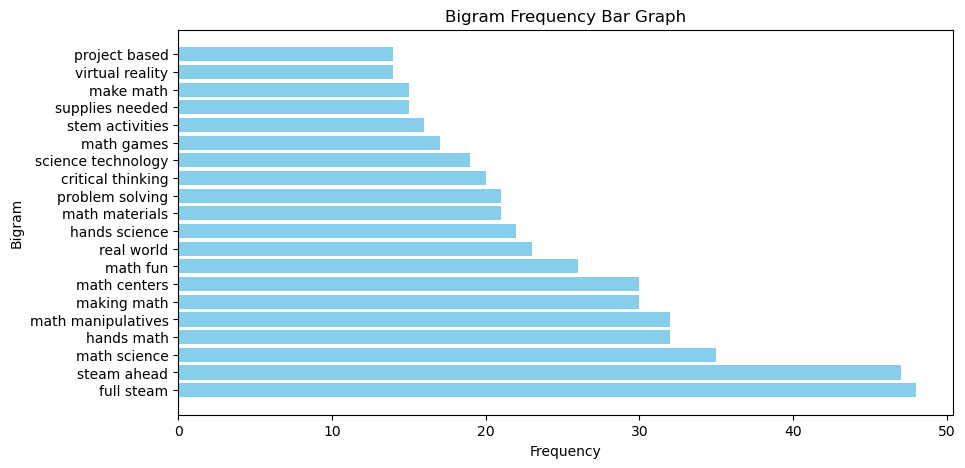

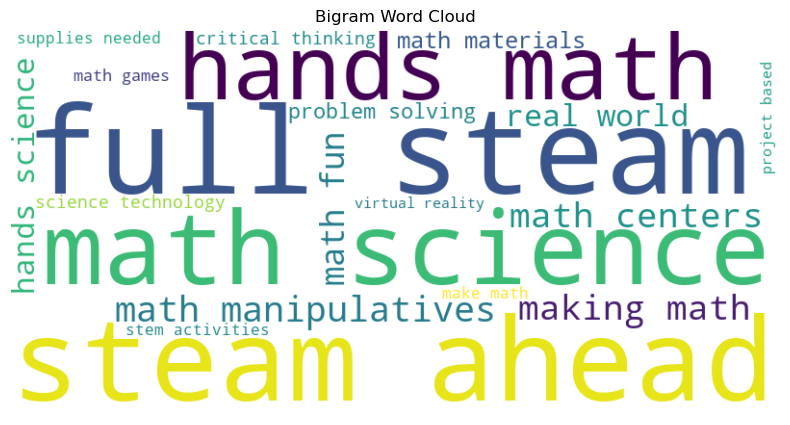

printing top 20 trigrams.....................
{('building', 'life', 'science'): 1, ('life', 'science', 'experiences'): 1, ('stem', 'capitalize', 'technology'): 1, ('stem', 'made', 'simple'): 1, ('made', 'simple', 'sensible'): 1, ('simple', 'sensible', 'integrated'): 1, ('sensible', 'integrated', 'meaningful'): 1, ('integrated', 'meaningful', 'purposeful'): 1, ('meaningful', 'purposeful', 'engaging'): 1, ('immersion', 'trip', 'outdoor'): 1, ('trip', 'outdoor', 'gear'): 1, ('kindergarten', 'stem', 'stations'): 1, ('national', 'parks', 'outer'): 1, ('parks', 'outer', 'space'): 1, ('becoming', 'architects', 'engineers'): 1, ('architects', 'engineers', 'builders'): 1, ('engineers', 'builders', 'age'): 1, ('open', 'window', 'technology'): 1, ('go', 'go', 'google'): 1, ('go', 'google', 'gadgets'): 1}
#######################################################################################################
Approved cleaned_titles  specialneeds


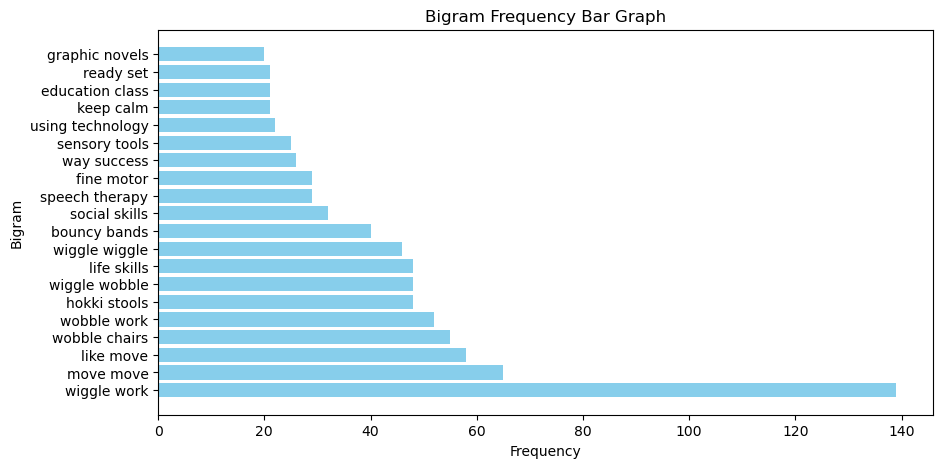

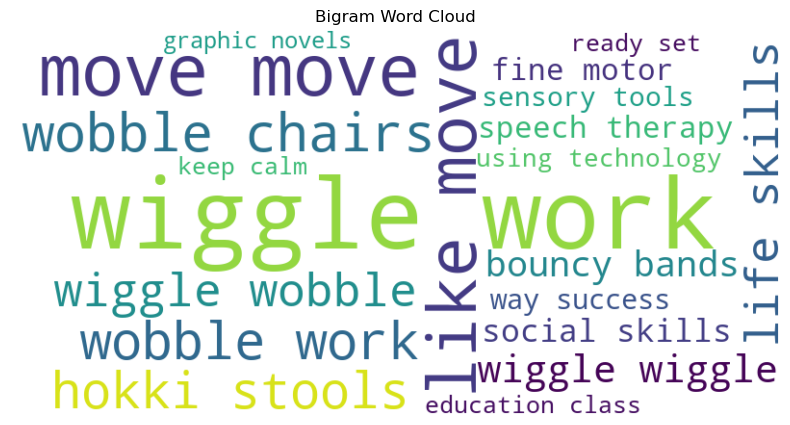

printing top 20 trigrams.....................
{('mrs', 'jarvis', 'terrific'): 1, ('jarvis', 'terrific', 'third'): 1, ('terrific', 'third', 'graders'): 1, ('chromebooks', 'education', 'program'): 1, ('everyone', 'deserves', 'heard'): 1, ('making', 'great', 'leap'): 1, ('great', 'leap', 'leapfrog'): 1, ('exploring', 'graphic', 'novels'): 1, ('understand', 'like', 'everyone'): 1, ('like', 'everyone', 'else'): 1, ('start', 'year', 'strong'): 1, ('diminish', 'digitial', 'divide'): 1, ('easy', 'eyes', 'nose'): 1, ('bring', 'projects', 'life'): 1, ('projects', 'life', 'color'): 1, ('music', 'please', 'motivation'): 1, ('please', 'motivation', 'needed'): 1, ('motivation', 'needed', 'vigorous'): 1, ('needed', 'vigorous', 'physical'): 1, ('vigorous', 'physical', 'activity'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  specialneeds


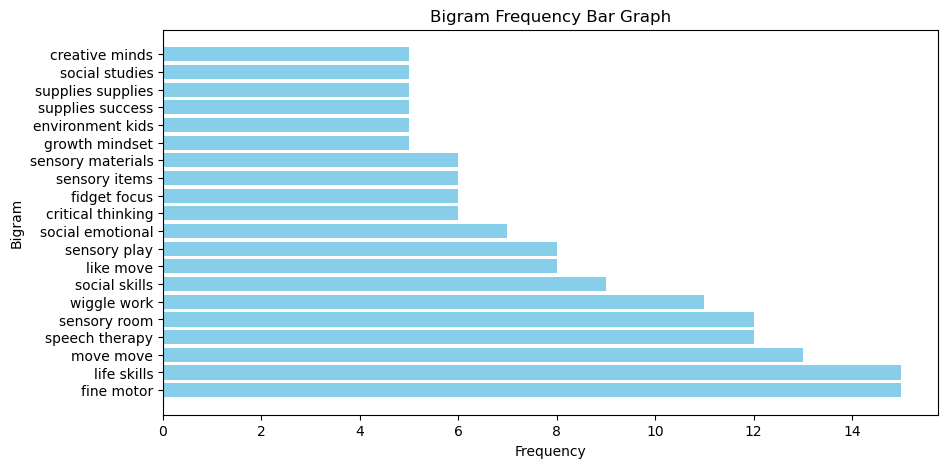

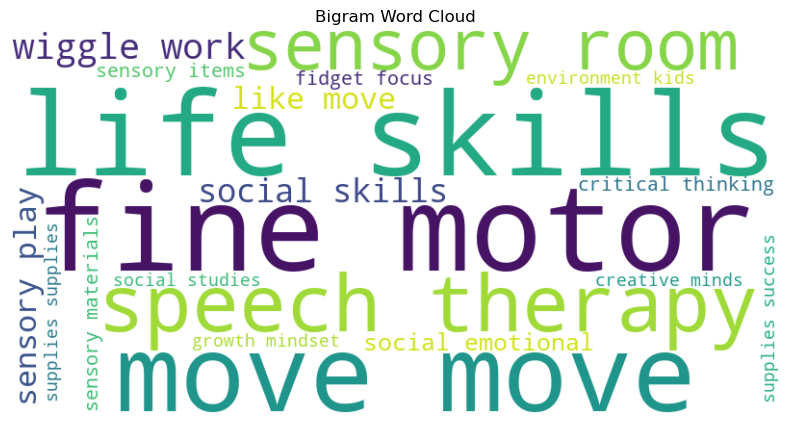

printing top 20 trigrams.....................
{('keep', 'computer', 'lab'): 1, ('computer', 'lab', 'nice'): 1, ('growth', 'mindset', 'future'): 1, ('alternative', 'comfy', 'classrooms'): 1, ('fidget', 'toys', 'chairs'): 1, ('toys', 'chairs', 'middle'): 1, ('chairs', 'middle', 'kids'): 1, ('like', 'move', 'move'): 1, ('technology', 'alternative', 'experience'): 1, ('critical', 'thinking', 'sensory'): 1, ('thinking', 'sensory', 'play'): 1, ('ict', 'class', 'chromebook'): 1, ('play', 'adapted', 'sports'): 1, ('show', 'money', 'matters'): 1, ('reaching', 'goals', 'fitness'): 1, ('goals', 'fitness', 'mindfulness'): 1, ('math', 'mania', 'math'): 1, ('mania', 'math', 'better'): 1, ('math', 'better', 'path'): 1, ('overcome', 'sensory', 'deficits'): 1}
#######################################################################################################
Approved cleaned_titles  sports


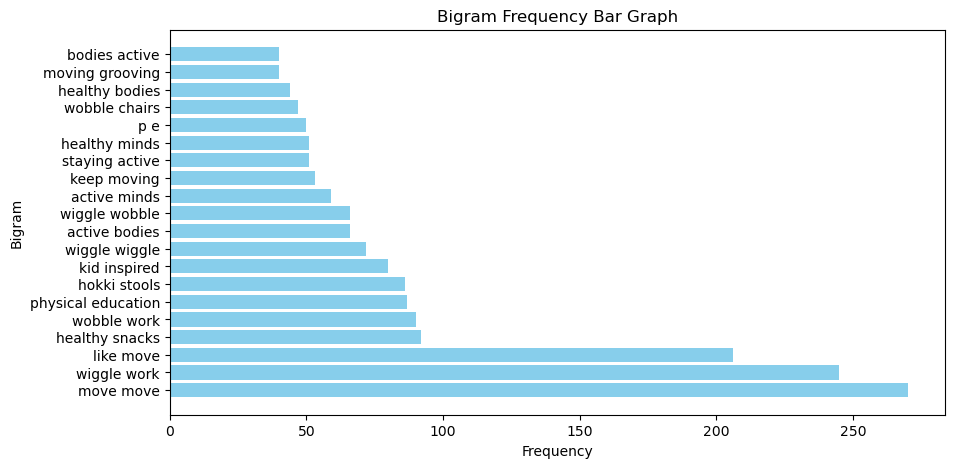

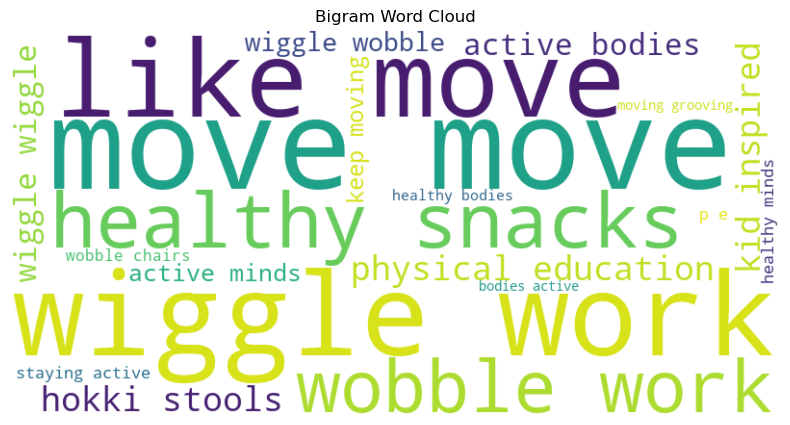

printing top 20 trigrams.....................
{('wanted', 'projector', 'hungry'): 1, ('targeting', 'success', 'class'): 1, ('making', 'recess', 'active'): 1, ('wiggling', 'way', 'success'): 1, ('target', 'kids', 'printer'): 1, ('kids', 'printer', 'ink'): 1, ('kinders', 'inspired', 'target'): 1, ('inspired', 'target', 'fitness'): 1, ('target', 'fitness', 'part'): 1, ('fitness', 'part', 'one'): 1, ('rainy', 'day', 'run'): 1, ('day', 'run', 'around'): 1, ('swim', 'life', 'ymca'): 1, ('picnic', 'table', 'make'): 1, ('table', 'make', 'able'): 1, ('targeting', 'baseball', 'hitting'): 1, ('baseball', 'hitting', 'bulls'): 1, ('hitting', 'bulls', 'eye'): 1, ('chicka', 'chicka', 'boom'): 1, ('chicka', 'boom', 'boom'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  sports


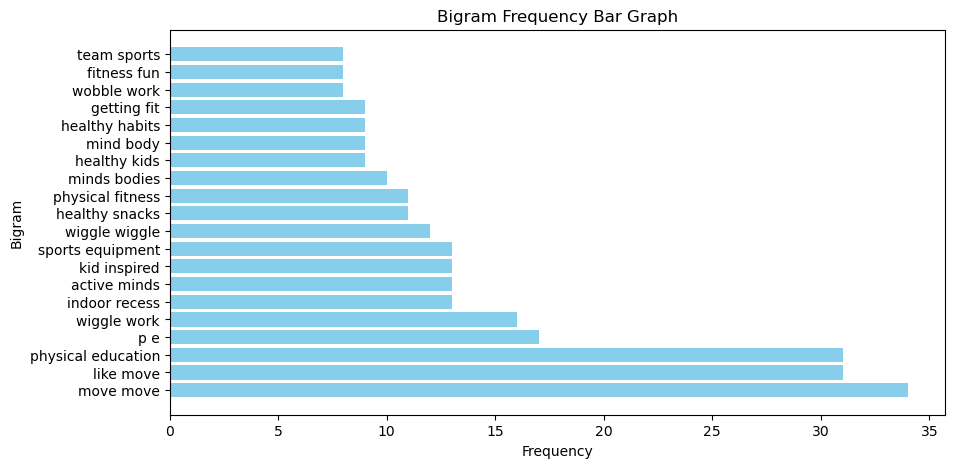

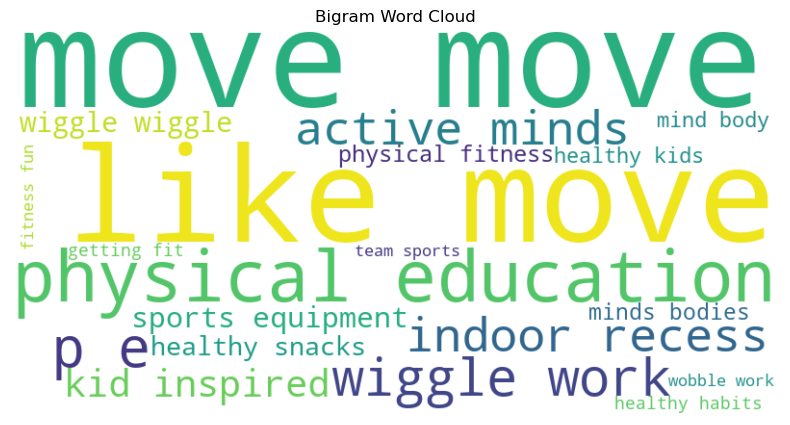

printing top 20 trigrams.....................
{('soccer', 'equipment', 'awesome'): 1, ('equipment', 'awesome', 'middle'): 1, ('fun', 'physically', 'fit'): 1, ('healthy', 'snack', 'attacks'): 1, ('like', 'move', 'move'): 1, ('oodles', 'outdoor', 'fun'): 1, ('ifit', 'going', 'gold'): 1, ('going', 'gold', 'part'): 1, ('gold', 'part', 'ii'): 1, ('getting', 'staying', 'healthy'): 1, ('art', 'teaching', 'kids'): 1, ('teaching', 'kids', 'zen'): 1, ('kids', 'zen', 'art'): 1, ('keep', 'garden', 'alive'): 1, ('garden', 'alive', 'thriving'): 1, ('play', 'adapted', 'sports'): 1, ('never', 'young', 'healthy'): 1, ('reaching', 'goals', 'fitness'): 1, ('goals', 'fitness', 'mindfulness'): 1, ('live', 'oak', 'eagle'): 1}
#######################################################################################################
Approved cleaned_titles  warmth


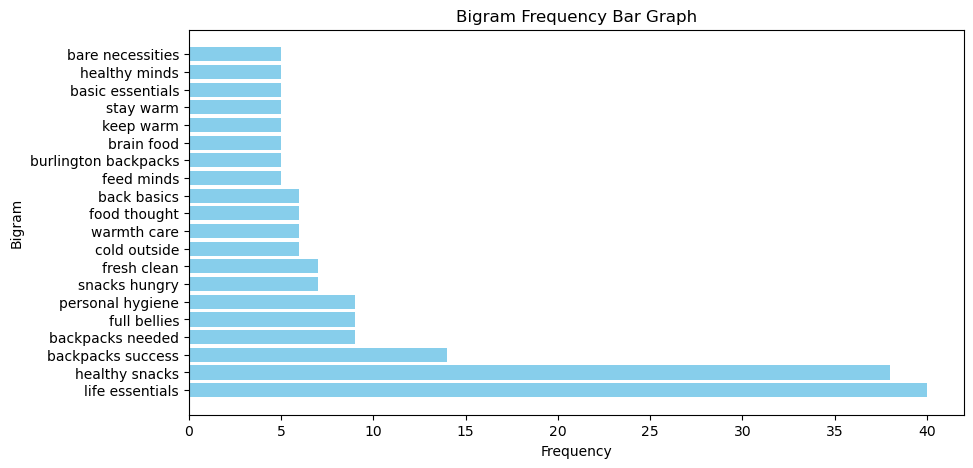

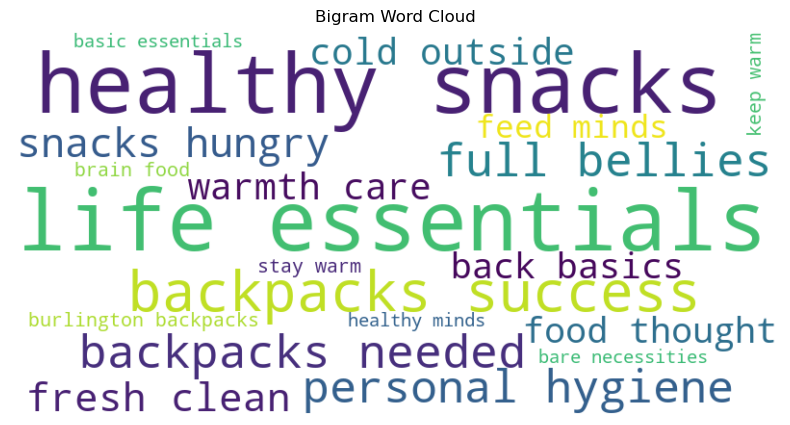

printing top 20 trigrams.....................
{('keep', 'closet', 'open'): 1, ('clean', 'tidy', 'ready'): 1, ('taking', 'care', 'bodies'): 1, ('care', 'bodies', 'one'): 1, ('bodies', 'one', 'less'): 1, ('one', 'less', 'concern'): 1, ('tummies', 'rumble', 'empty'): 1, ('right', 'track', 'backpacks'): 1, ('feed', 'minds', 'hungry'): 1, ('minds', 'hungry', 'snacks'): 1, ('burlington', 'backpacks', 'win'): 1, ('backpacks', 'organized', 'scholars'): 1, ('keeping', 'teeth', 'clean'): 1, ('teeth', 'clean', 'stomachs'): 1, ('clean', 'stomachs', 'full'): 1, ('essential', 'snack', 'hungry'): 1, ('start', 'day', 'supplying'): 1, ('day', 'supplying', 'life'): 1, ('supplying', 'life', 'essentials'): 1, ('life', 'essentials', 'children'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_titles  warmth


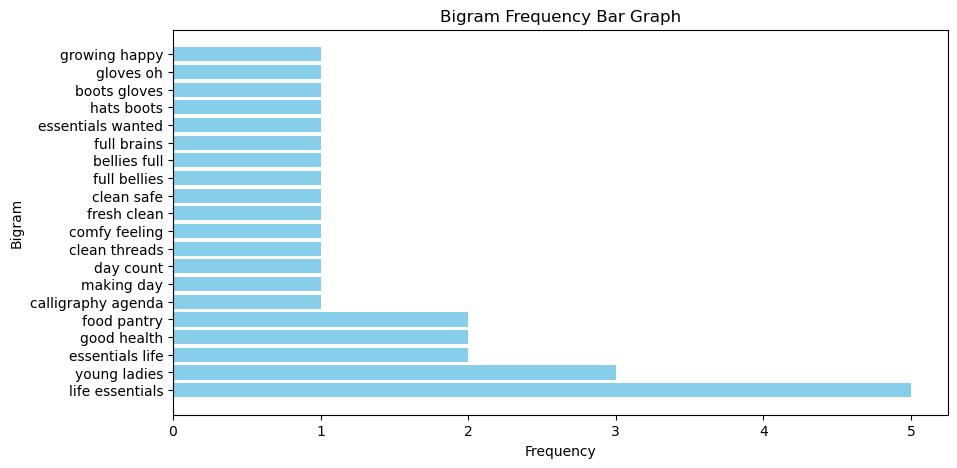

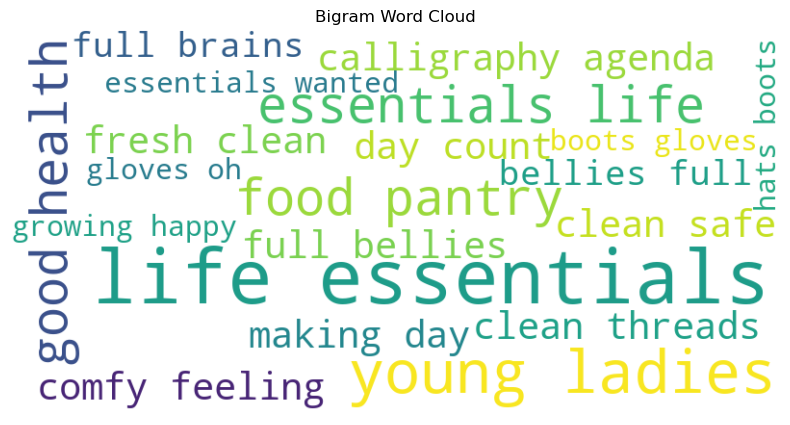

printing top 20 trigrams.....................
{('making', 'day', 'count'): 1, ('fresh', 'clean', 'safe'): 1, ('full', 'bellies', 'full'): 1, ('bellies', 'full', 'brains'): 1, ('hats', 'boots', 'gloves'): 1, ('boots', 'gloves', 'oh'): 1, ('growing', 'happy', 'kids'): 1, ('happy', 'kids', 'positive'): 1, ('kids', 'positive', 'mindset'): 1, ('4th', 'organizers', 'supplies'): 1, ('survival', 'skill', 'preschool'): 1, ('setting', 'successful', 'environment'): 1, ('health', 'hygiene', 'happiness'): 1, ('clean', 'healthy', 'kids'): 1, ('magic', 'carpet', 'ride'): 1, ('loving', 'litter', 'bugs'): 1, ('wearing', 'chinese', 'chinese'): 1, ('jet', 'fuel', 'super'): 1, ('fuel', 'super', 'rocket'): 1, ('super', 'rocket', 'scholars'): 1}
#######################################################################################################
Approved cleaned_essays  appliedlearning


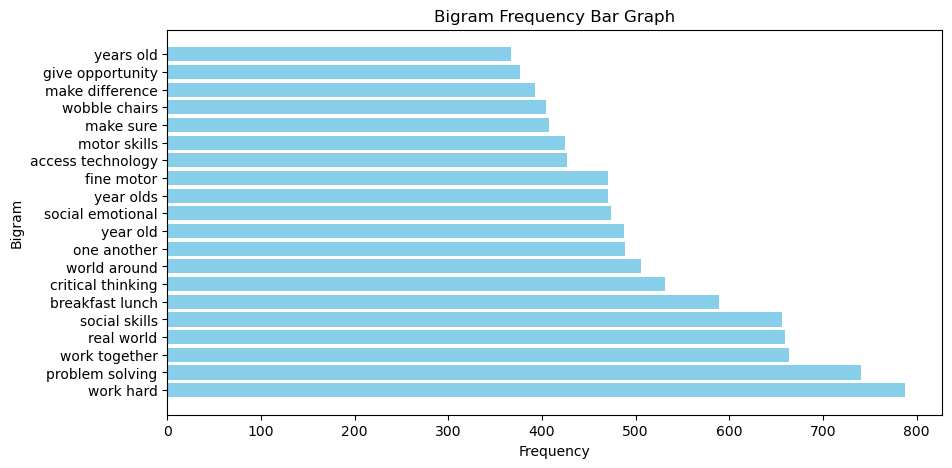

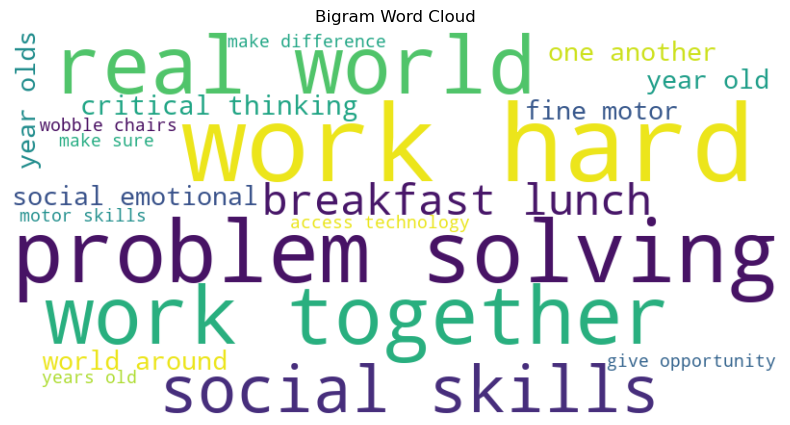

printing top 20 trigrams.....................
{('breakfast', 'lunch', 'care'): 1, ('lunch', 'care', 'struggle'): 1, ('care', 'struggle', 'life'): 1, ('struggle', 'life', 'great'): 1, ('life', 'great', 'kids'): 1, ('great', 'kids', 'young'): 1, ('kids', 'young', 'minds'): 1, ('young', 'minds', 'eager'): 1, ('minds', 'eager', 'waiting'): 1, ('eager', 'waiting', 'opportunities'): 1, ('waiting', 'opportunities', 'succeed'): 1, ('opportunities', 'succeed', 'wonderful'): 1, ('succeed', 'wonderful', 'around'): 1, ('wonderful', 'around', 'really'): 1, ('around', 'really', 'enjoy'): 1, ('really', 'enjoy', 'spending'): 1, ('enjoy', 'spending', 'time'): 1, ('spending', 'time', 'friends'): 1, ('time', 'friends', 'teachers'): 1, ('friends', 'teachers', 'community'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  appliedlearning


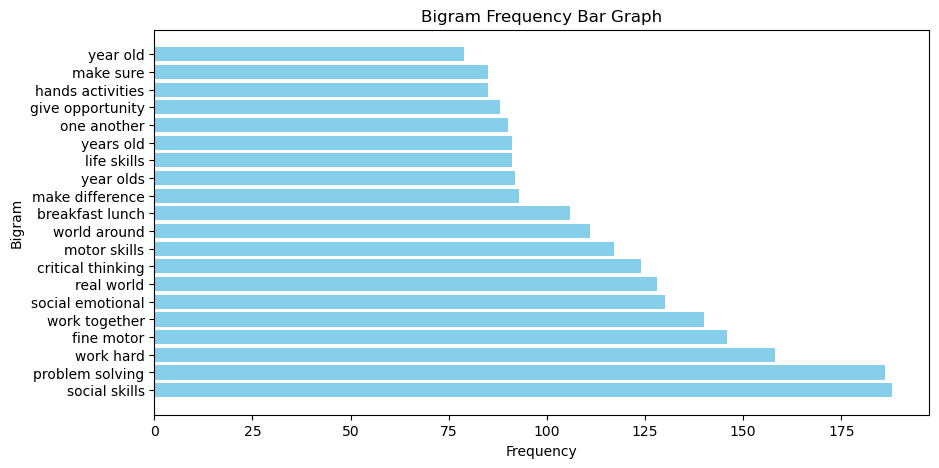

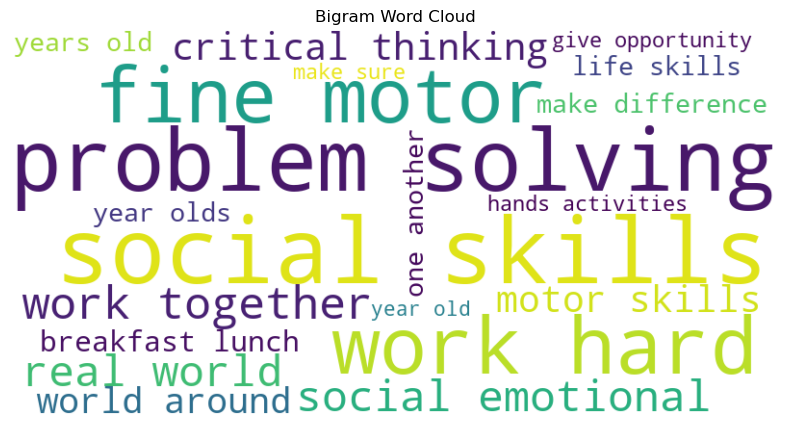

printing top 20 trigrams.....................
{('counselor', 'amazing', 'variety'): 1, ('amazing', 'variety', 'socioeconomic'): 1, ('variety', 'socioeconomic', 'cultural'): 1, ('socioeconomic', 'cultural', 'backgrounds'): 1, ('cultural', 'backgrounds', 'title'): 1, ('backgrounds', 'title', 'lunch'): 1, ('title', 'lunch', 'qualify'): 1, ('lunch', 'qualify', 'fee'): 1, ('qualify', 'fee', 'waivers'): 1, ('fee', 'waivers', 'pay'): 1, ('waivers', 'pay', 'college'): 1, ('pay', 'college', 'applications'): 1, ('college', 'applications', 'entrance'): 1, ('applications', 'entrance', 'exams'): 1, ('entrance', 'exams', 'financial'): 1, ('exams', 'financial', 'aid'): 1, ('financial', 'aid', 'driven'): 1, ('aid', 'driven', 'hardworking'): 1, ('driven', 'hardworking', 'likely'): 1, ('hardworking', 'likely', 'family'): 1}
#######################################################################################################
Approved cleaned_essays  arts


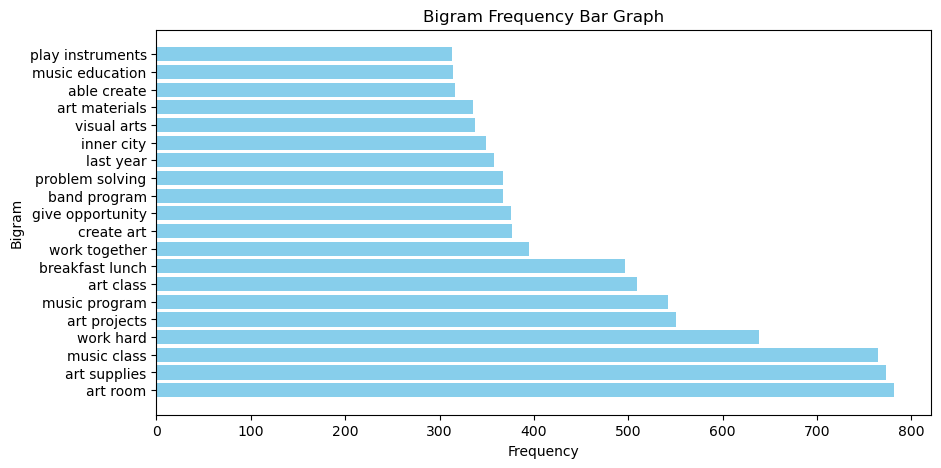

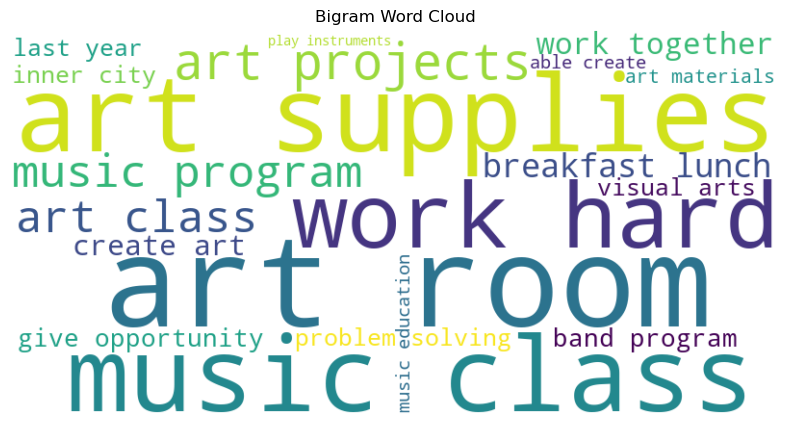

printing top 20 trigrams.....................
{('musical', 'eat', 'breakfast'): 1, ('eat', 'breakfast', 'lunch'): 1, ('breakfast', 'lunch', 'rothschild'): 1, ('lunch', 'rothschild', 'enthusiasm'): 1, ('rothschild', 'enthusiasm', 'however'): 1, ('enthusiasm', 'however', 'bring'): 1, ('however', 'bring', 'making'): 1, ('bring', 'making', 'music'): 1, ('making', 'music', 'exceptional'): 1, ('music', 'exceptional', 'creating'): 1, ('exceptional', 'creating', 'dimensional'): 1, ('creating', 'dimensional', 'orchestra'): 1, ('dimensional', 'orchestra', 'provides'): 1, ('orchestra', 'provides', 'classical'): 1, ('provides', 'classical', 'hip'): 1, ('classical', 'hip', 'hop'): 1, ('hip', 'hop', 'experiences'): 1, ('hop', 'experiences', 'work'): 1, ('experiences', 'work', 'tirelessly'): 1, ('work', 'tirelessly', 'everyday'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  arts


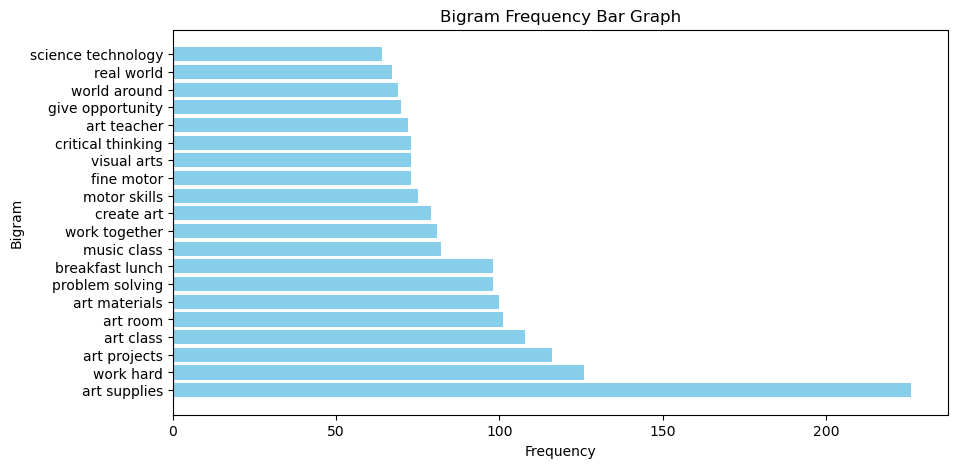

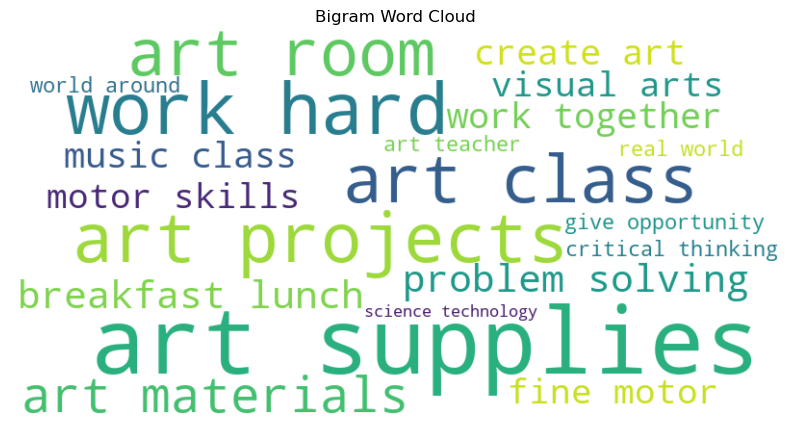

printing top 20 trigrams.....................
{('though', 'schools', 'like'): 1, ('schools', 'like', 'highlight'): 1, ('like', 'highlight', 'diversity'): 1, ('highlight', 'diversity', 'campus'): 1, ('diversity', 'campus', 'truly'): 1, ('campus', 'truly', 'unique'): 1, ('truly', 'unique', 'immigrants'): 1, ('unique', 'immigrants', 'generation'): 1, ('immigrants', 'generation', 'americans'): 1, ('generation', 'americans', 'collectively'): 1, ('americans', 'collectively', 'speak'): 1, ('collectively', 'speak', 'different'): 1, ('speak', 'different', 'languages'): 1, ('different', 'languages', 'giving'): 1, ('languages', 'giving', 'rich'): 1, ('giving', 'rich', 'variety'): 1, ('rich', 'variety', 'cultures'): 1, ('variety', 'cultures', 'explore'): 1, ('cultures', 'explore', 'music'): 1, ('explore', 'music', 'dance'): 1}
#######################################################################################################
Approved cleaned_essays  care


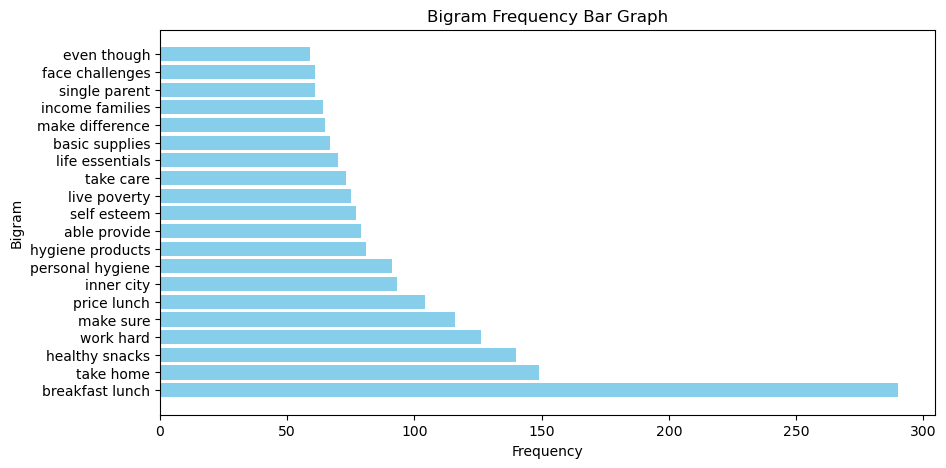

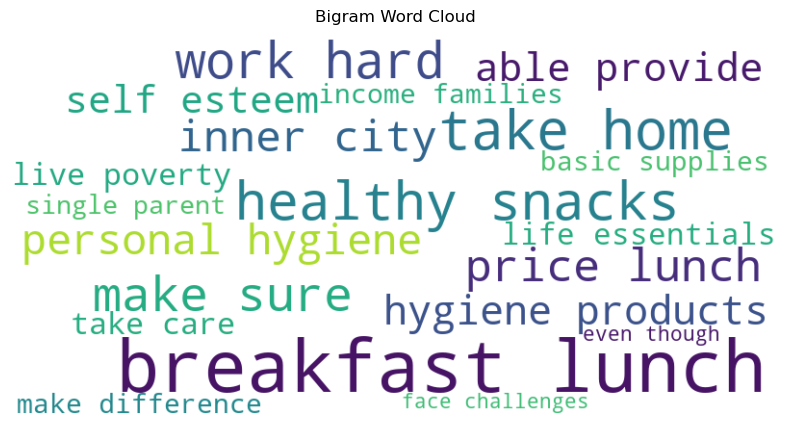

printing top 20 trigrams.....................
{('work', 'hard', 'best'): 1, ('hard', 'best', 'leaders'): 1, ('best', 'leaders', 'located'): 1, ('leaders', 'located', 'memphis'): 1, ('located', 'memphis', 'tennessee'): 1, ('memphis', 'tennessee', 'homes'): 1, ('tennessee', 'homes', 'obstacles'): 1, ('homes', 'obstacles', 'overcome'): 1, ('obstacles', 'overcome', 'single'): 1, ('overcome', 'single', 'parent'): 1, ('single', 'parent', 'households'): 1, ('parent', 'households', 'live'): 1, ('households', 'live', 'poverty'): 1, ('live', 'poverty', 'make'): 1, ('poverty', 'make', 'goal'): 1, ('make', 'goal', 'take'): 1, ('goal', 'take', 'reality'): 1, ('take', 'reality', 'despite'): 1, ('reality', 'despite', 'obstacles'): 1, ('despite', 'obstacles', 'rise'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  care


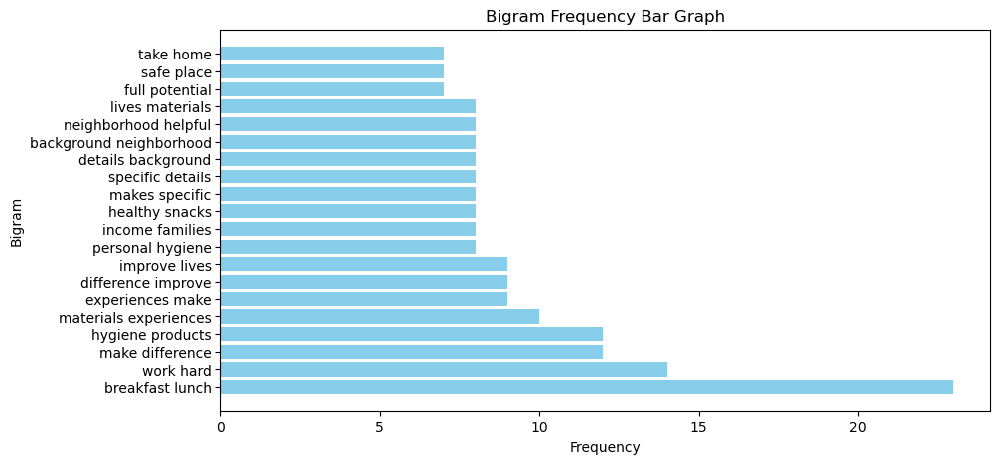

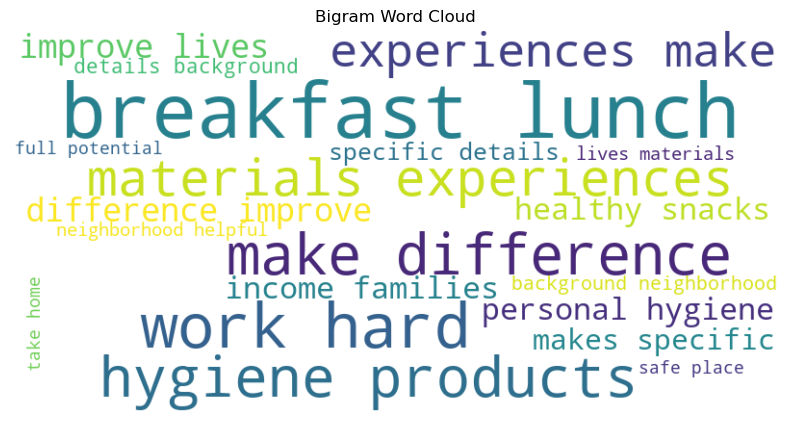

printing top 20 trigrams.....................
{('teach', 'poverty', 'middle'): 1, ('poverty', 'middle', 'silicon'): 1, ('middle', 'silicon', 'valley'): 1, ('silicon', 'valley', 'east'): 1, ('valley', 'east', 'palo'): 1, ('east', 'palo', 'alto'): 1, ('palo', 'alto', 'california'): 1, ('alto', 'california', 'ninety'): 1, ('california', 'ninety', 'nine'): 1, ('ninety', 'nine', 'percent'): 1, ('nine', 'percent', 'lunch'): 1, ('percent', 'lunch', 'starling'): 1, ('lunch', 'starling', 'number'): 1, ('starling', 'number', 'considered'): 1, ('number', 'considered', 'homeless'): 1, ('considered', 'homeless', 'due'): 1, ('homeless', 'due', 'living'): 1, ('due', 'living', 'conditions'): 1, ('living', 'conditions', 'particularly'): 1, ('conditions', 'particularly', 'families'): 1}
#######################################################################################################
Approved cleaned_essays  civics


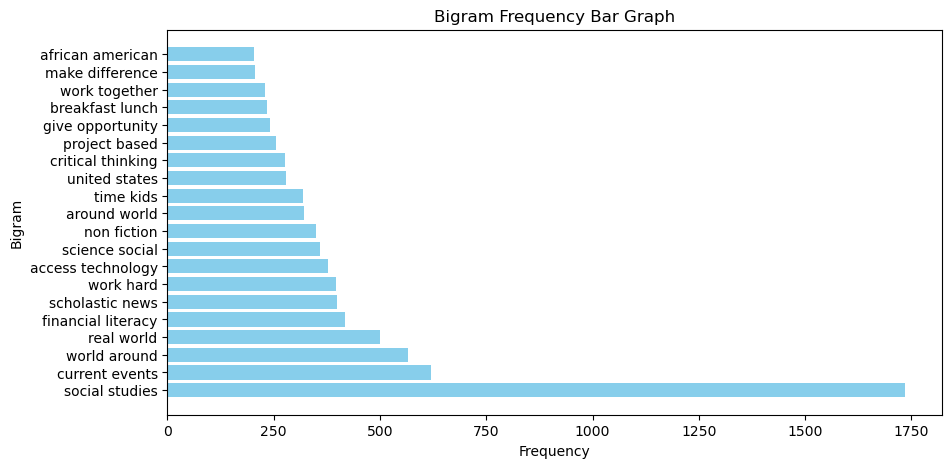

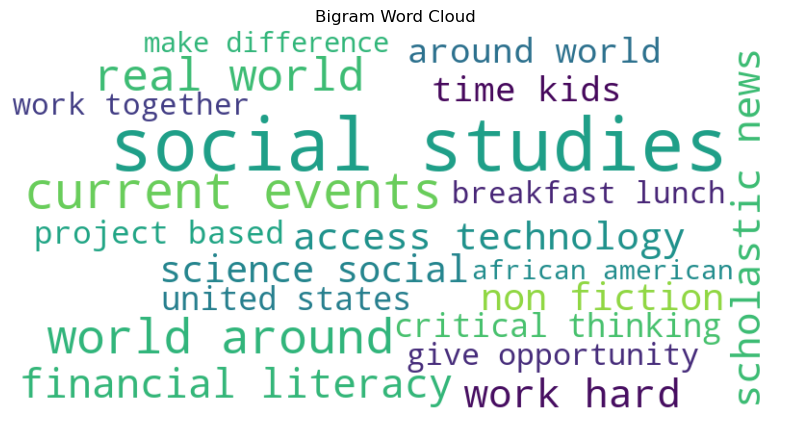

printing top 20 trigrams.....................
{('arrive', 'eager', 'polite'): 1, ('eager', 'polite', 'generous'): 1, ('polite', 'generous', 'strive'): 1, ('generous', 'strive', 'best'): 1, ('strive', 'best', 'know'): 1, ('best', 'know', 'education'): 1, ('know', 'education', 'succeed'): 1, ('education', 'succeed', 'life'): 1, ('succeed', 'life', 'improve'): 1, ('life', 'improve', 'lives'): 1, ('improve', 'lives', 'focuses'): 1, ('lives', 'focuses', 'families'): 1, ('focuses', 'families', 'incomes'): 1, ('families', 'incomes', 'tries'): 1, ('incomes', 'tries', 'give'): 1, ('tries', 'give', 'education'): 1, ('give', 'education', 'deserve'): 1, ('education', 'deserve', 'much'): 1, ('deserve', 'much', 'materials'): 1, ('much', 'materials', 'given'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  civics


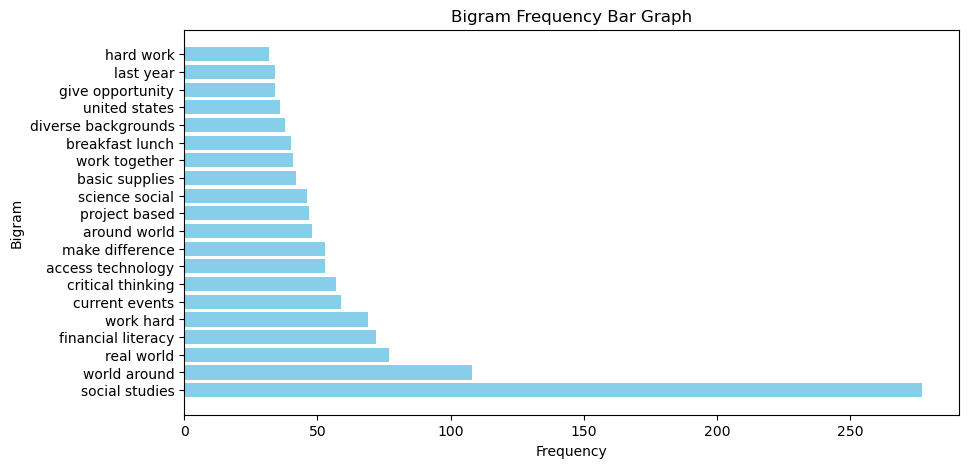

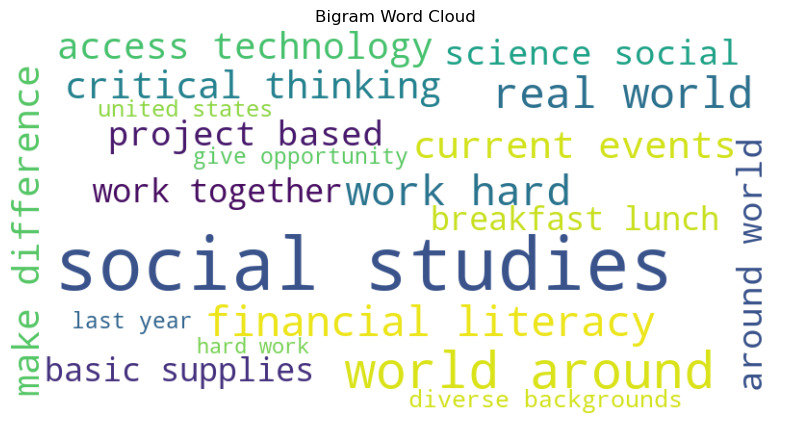

printing top 20 trigrams.....................
{('teach', 'title', 'qualify'): 1, ('title', 'qualify', 'lunches'): 1, ('qualify', 'lunches', 'families'): 1, ('lunches', 'families', 'comprise'): 1, ('families', 'comprise', 'multitude'): 1, ('comprise', 'multitude', 'cultures'): 1, ('multitude', 'cultures', 'including'): 1, ('cultures', 'including', 'migrant'): 1, ('including', 'migrant', 'families'): 1, ('migrant', 'families', 'significant'): 1, ('families', 'significant', 'portion'): 1, ('significant', 'portion', 'require'): 1, ('portion', 'require', 'materials'): 1, ('require', 'materials', 'differentiated'): 1, ('materials', 'differentiated', 'instruction'): 1, ('differentiated', 'instruction', 'limited'): 1, ('instruction', 'limited', 'funds'): 1, ('limited', 'funds', 'able'): 1, ('funds', 'able', 'meet'): 1, ('able', 'meet', 'challenging'): 1}
#######################################################################################################
Approved cleaned_essays  health


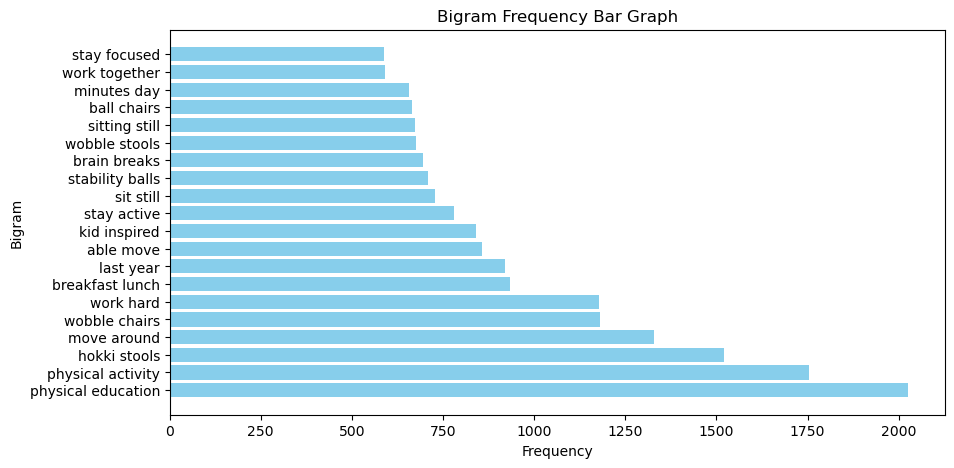

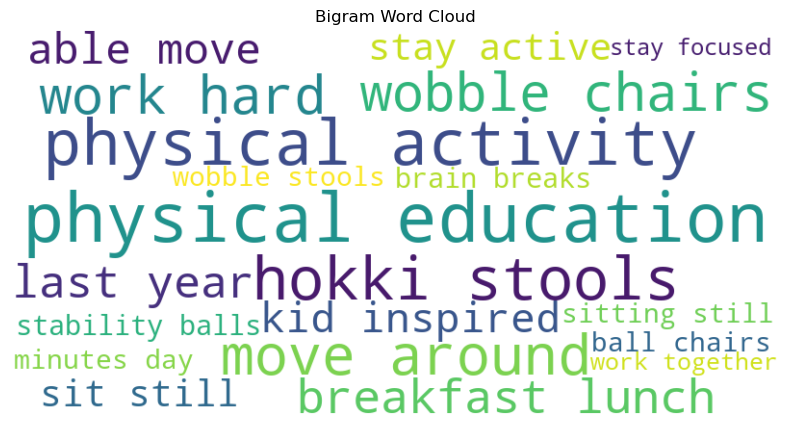

printing top 20 trigrams.....................
{('arrive', 'eager', 'polite'): 1, ('eager', 'polite', 'generous'): 1, ('polite', 'generous', 'strive'): 1, ('generous', 'strive', 'best'): 1, ('strive', 'best', 'know'): 1, ('best', 'know', 'education'): 1, ('know', 'education', 'succeed'): 1, ('education', 'succeed', 'life'): 1, ('succeed', 'life', 'improve'): 1, ('life', 'improve', 'lives'): 1, ('improve', 'lives', 'focuses'): 1, ('lives', 'focuses', 'families'): 1, ('focuses', 'families', 'incomes'): 1, ('families', 'incomes', 'tries'): 1, ('incomes', 'tries', 'give'): 1, ('tries', 'give', 'education'): 1, ('give', 'education', 'deserve'): 1, ('education', 'deserve', 'much'): 1, ('deserve', 'much', 'materials'): 1, ('much', 'materials', 'given'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  health


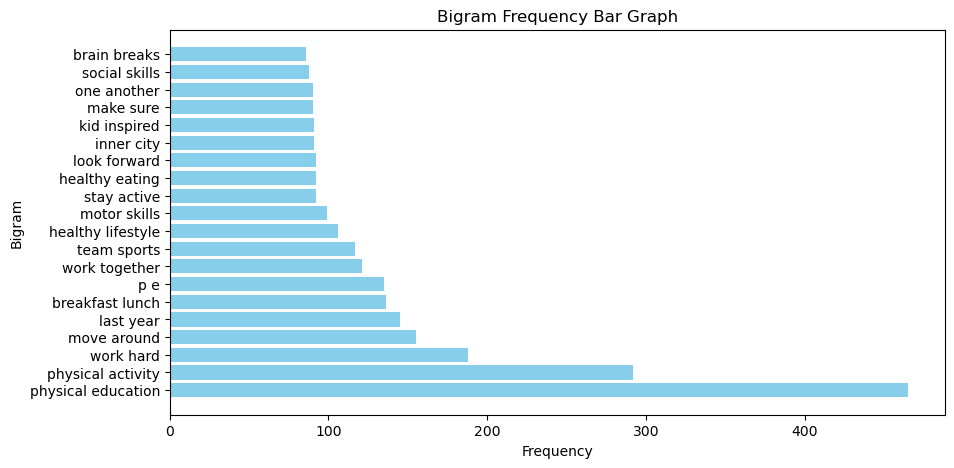

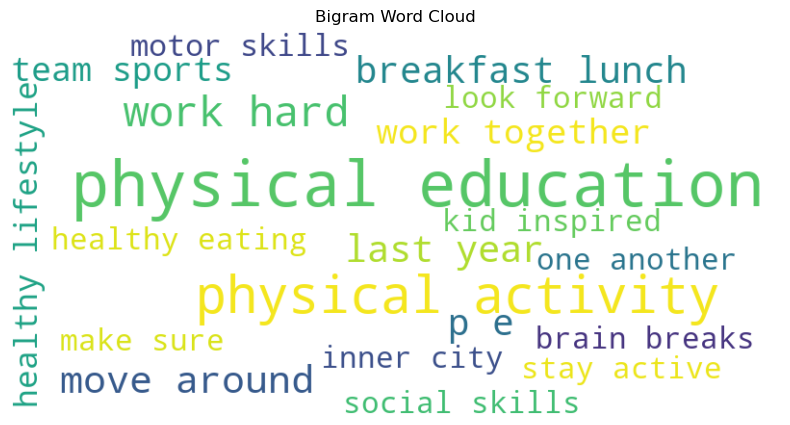

printing top 20 trigrams.....................
{('true', 'champions', 'always'): 1, ('champions', 'always', 'ones'): 1, ('always', 'ones', 'win'): 1, ('ones', 'win', 'guts'): 1, ('win', 'guts', 'mia'): 1, ('guts', 'mia', 'hamm'): 1, ('mia', 'hamm', 'quote'): 1, ('hamm', 'quote', 'best'): 1, ('quote', 'best', 'describes'): 1, ('best', 'describes', 'cholla'): 1, ('describes', 'cholla', 'middle'): 1, ('cholla', 'middle', 'approach'): 1, ('middle', 'approach', 'playing'): 1, ('approach', 'playing', 'sports'): 1, ('playing', 'sports', 'especially'): 1, ('sports', 'especially', 'girls'): 1, ('especially', 'girls', 'boys'): 1, ('girls', 'boys', 'soccer'): 1, ('boys', 'soccer', 'teams'): 1, ('soccer', 'teams', 'teams'): 1}
#######################################################################################################
Approved cleaned_essays  history


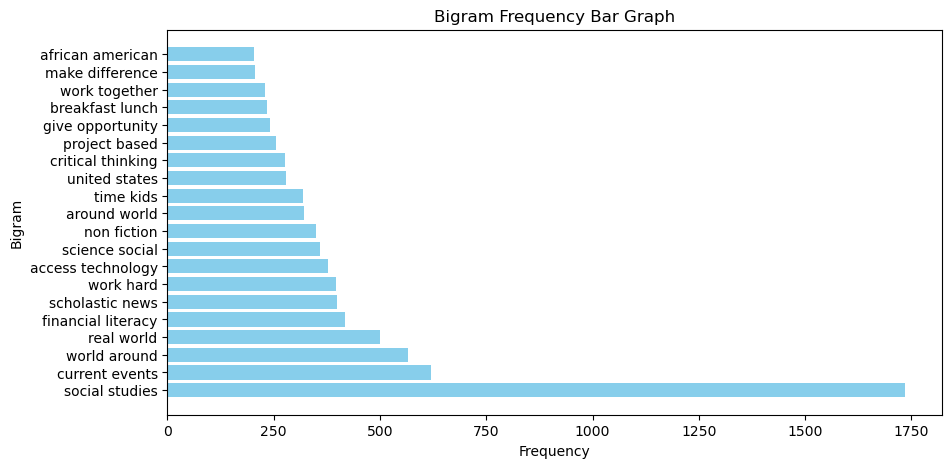

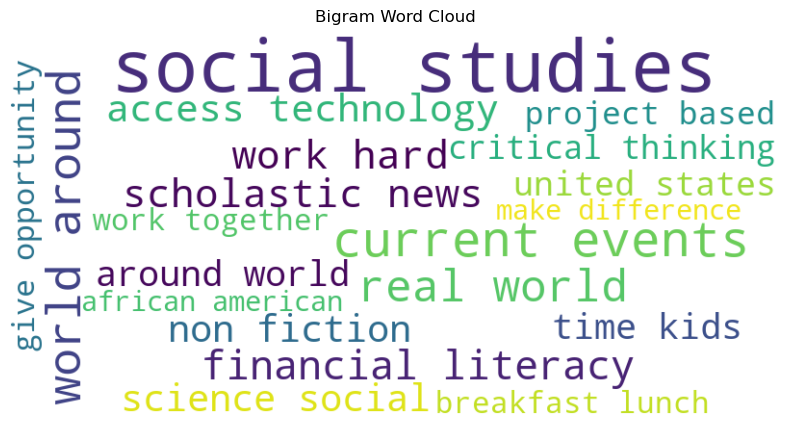

printing top 20 trigrams.....................
{('arrive', 'eager', 'polite'): 1, ('eager', 'polite', 'generous'): 1, ('polite', 'generous', 'strive'): 1, ('generous', 'strive', 'best'): 1, ('strive', 'best', 'know'): 1, ('best', 'know', 'education'): 1, ('know', 'education', 'succeed'): 1, ('education', 'succeed', 'life'): 1, ('succeed', 'life', 'improve'): 1, ('life', 'improve', 'lives'): 1, ('improve', 'lives', 'focuses'): 1, ('lives', 'focuses', 'families'): 1, ('focuses', 'families', 'incomes'): 1, ('families', 'incomes', 'tries'): 1, ('incomes', 'tries', 'give'): 1, ('tries', 'give', 'education'): 1, ('give', 'education', 'deserve'): 1, ('education', 'deserve', 'much'): 1, ('deserve', 'much', 'materials'): 1, ('much', 'materials', 'given'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  history


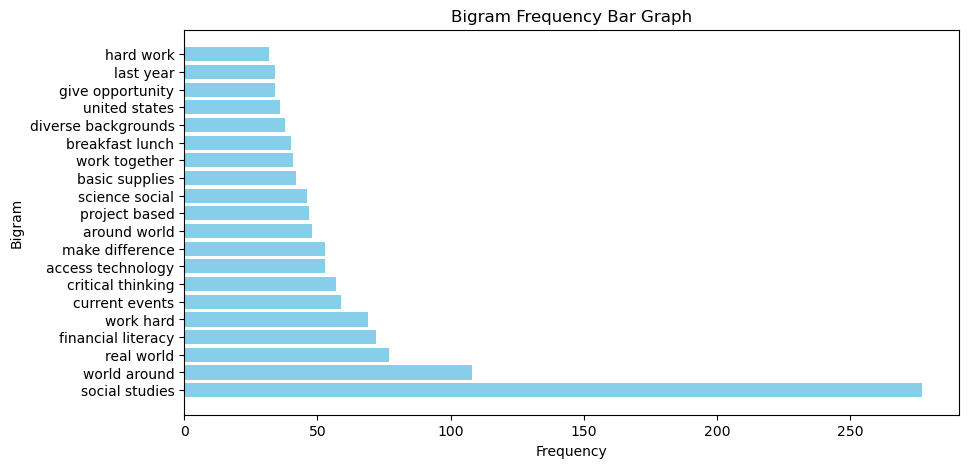

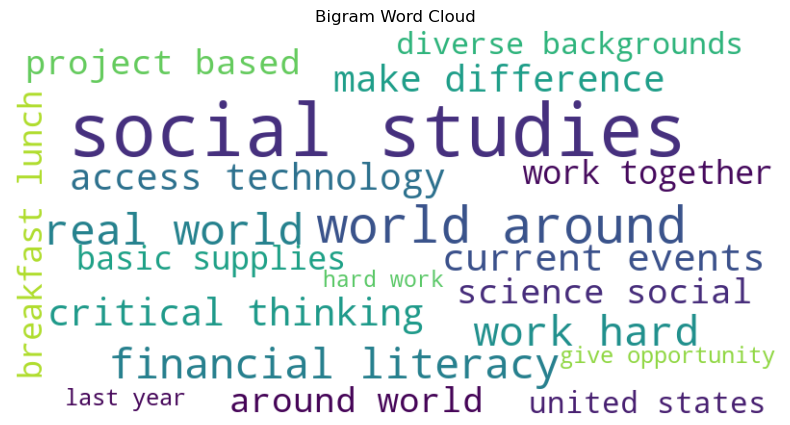

printing top 20 trigrams.....................
{('teach', 'title', 'qualify'): 1, ('title', 'qualify', 'lunches'): 1, ('qualify', 'lunches', 'families'): 1, ('lunches', 'families', 'comprise'): 1, ('families', 'comprise', 'multitude'): 1, ('comprise', 'multitude', 'cultures'): 1, ('multitude', 'cultures', 'including'): 1, ('cultures', 'including', 'migrant'): 1, ('including', 'migrant', 'families'): 1, ('migrant', 'families', 'significant'): 1, ('families', 'significant', 'portion'): 1, ('significant', 'portion', 'require'): 1, ('portion', 'require', 'materials'): 1, ('require', 'materials', 'differentiated'): 1, ('materials', 'differentiated', 'instruction'): 1, ('differentiated', 'instruction', 'limited'): 1, ('instruction', 'limited', 'funds'): 1, ('limited', 'funds', 'able'): 1, ('funds', 'able', 'meet'): 1, ('able', 'meet', 'challenging'): 1}
#######################################################################################################
Approved cleaned_essays  hunger


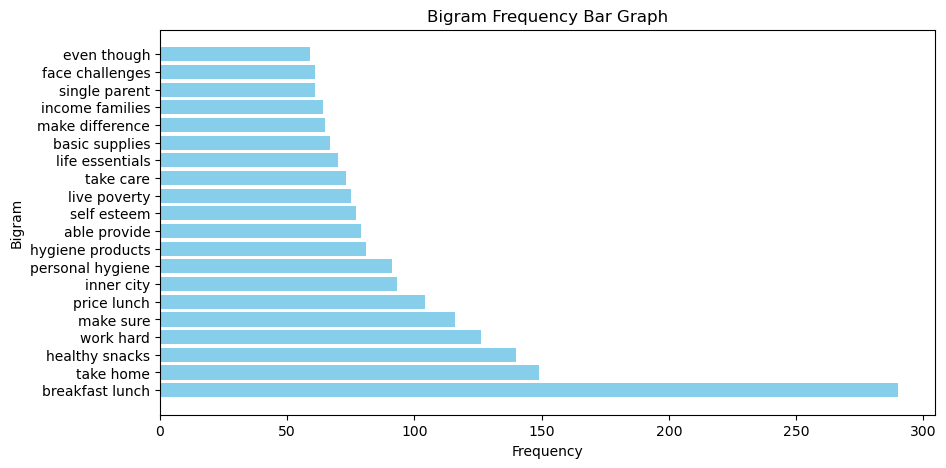

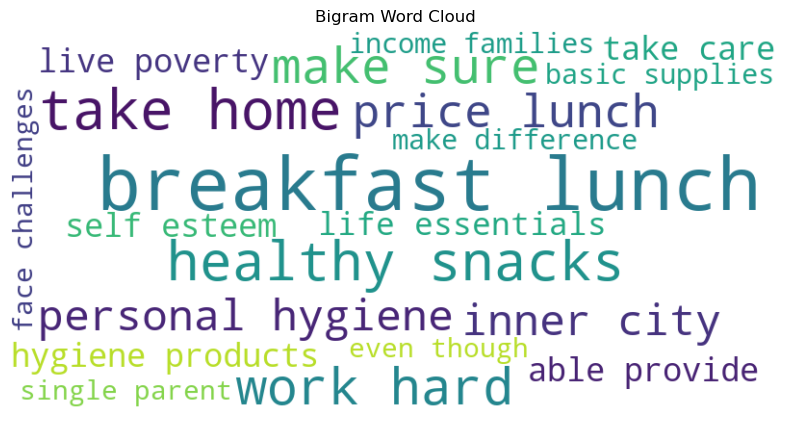

printing top 20 trigrams.....................
{('work', 'hard', 'best'): 1, ('hard', 'best', 'leaders'): 1, ('best', 'leaders', 'located'): 1, ('leaders', 'located', 'memphis'): 1, ('located', 'memphis', 'tennessee'): 1, ('memphis', 'tennessee', 'homes'): 1, ('tennessee', 'homes', 'obstacles'): 1, ('homes', 'obstacles', 'overcome'): 1, ('obstacles', 'overcome', 'single'): 1, ('overcome', 'single', 'parent'): 1, ('single', 'parent', 'households'): 1, ('parent', 'households', 'live'): 1, ('households', 'live', 'poverty'): 1, ('live', 'poverty', 'make'): 1, ('poverty', 'make', 'goal'): 1, ('make', 'goal', 'take'): 1, ('goal', 'take', 'reality'): 1, ('take', 'reality', 'despite'): 1, ('reality', 'despite', 'obstacles'): 1, ('despite', 'obstacles', 'rise'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  hunger


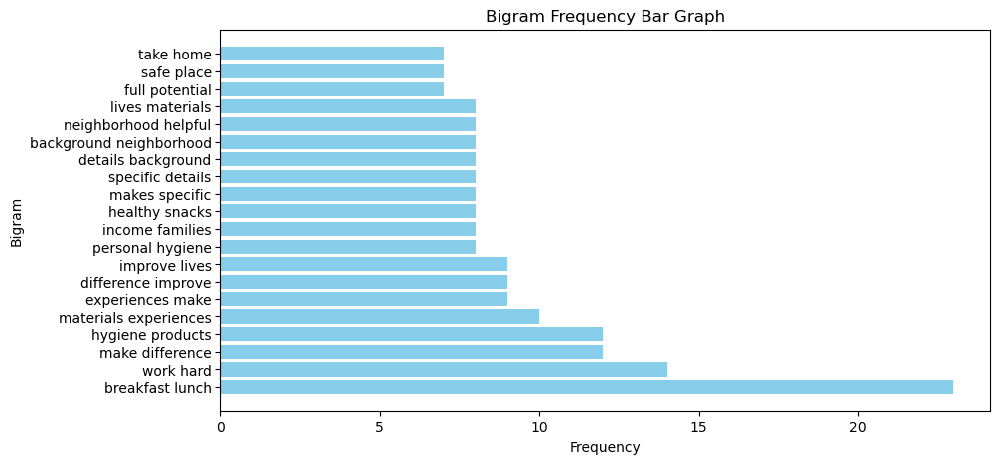

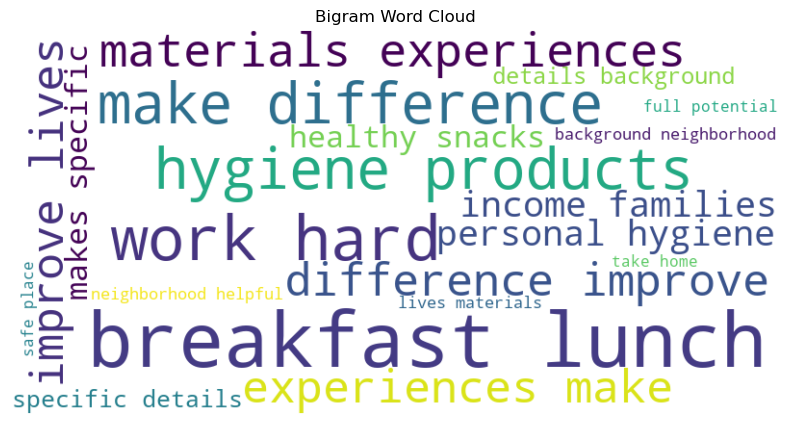

printing top 20 trigrams.....................
{('teach', 'poverty', 'middle'): 1, ('poverty', 'middle', 'silicon'): 1, ('middle', 'silicon', 'valley'): 1, ('silicon', 'valley', 'east'): 1, ('valley', 'east', 'palo'): 1, ('east', 'palo', 'alto'): 1, ('palo', 'alto', 'california'): 1, ('alto', 'california', 'ninety'): 1, ('california', 'ninety', 'nine'): 1, ('ninety', 'nine', 'percent'): 1, ('nine', 'percent', 'lunch'): 1, ('percent', 'lunch', 'starling'): 1, ('lunch', 'starling', 'number'): 1, ('starling', 'number', 'considered'): 1, ('number', 'considered', 'homeless'): 1, ('considered', 'homeless', 'due'): 1, ('homeless', 'due', 'living'): 1, ('due', 'living', 'conditions'): 1, ('living', 'conditions', 'particularly'): 1, ('conditions', 'particularly', 'families'): 1}
#######################################################################################################
Approved cleaned_essays  language


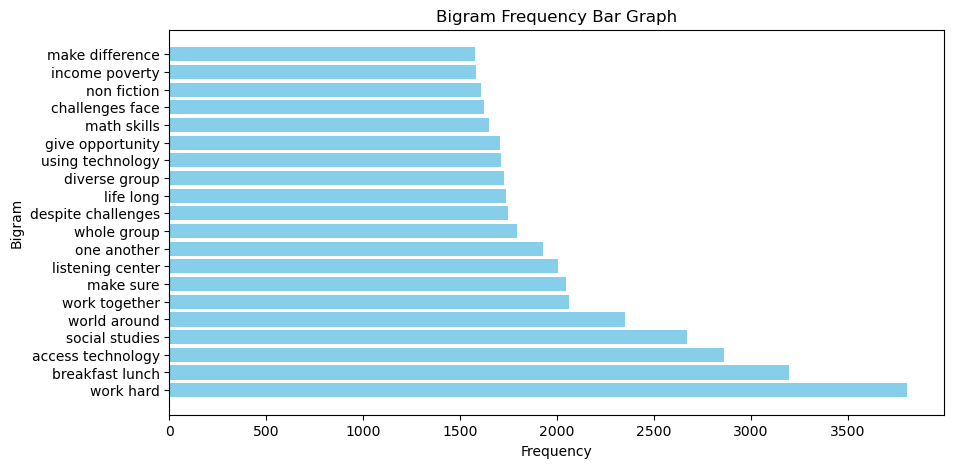

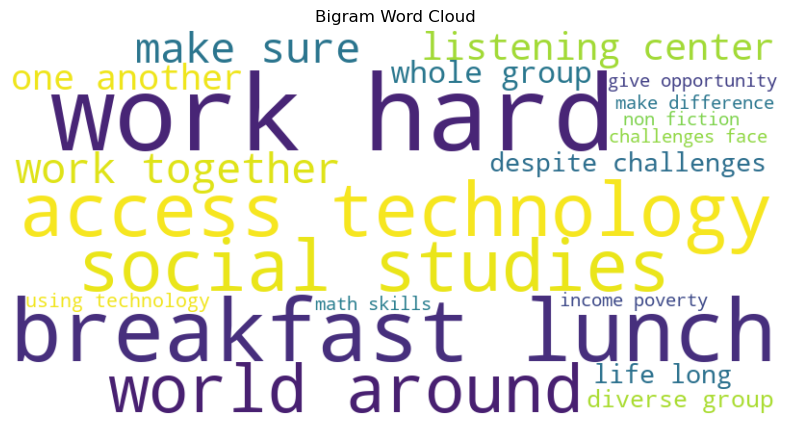

printing top 20 trigrams.....................
{('work', 'unique', 'filled'): 1, ('unique', 'filled', 'esl'): 1, ('filled', 'esl', 'poverty'): 1, ('esl', 'poverty', 'individual'): 1, ('poverty', 'individual', 'personal'): 1, ('individual', 'personal', 'struggles'): 1, ('personal', 'struggles', 'break'): 1, ('struggles', 'break', 'heart'): 1, ('break', 'heart', 'step'): 1, ('heart', 'step', 'doors'): 1, ('step', 'doors', 'notice'): 1, ('doors', 'notice', 'anything'): 1, ('notice', 'anything', 'positive'): 1, ('anything', 'positive', 'resilient'): 1, ('positive', 'resilient', 'attitude'): 1, ('resilient', 'attitude', 'support'): 1, ('attitude', 'support', 'aspect'): 1, ('support', 'aspect', 'journey'): 1, ('aspect', 'journey', 'world'): 1, ('journey', 'world', 'speaking'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  language


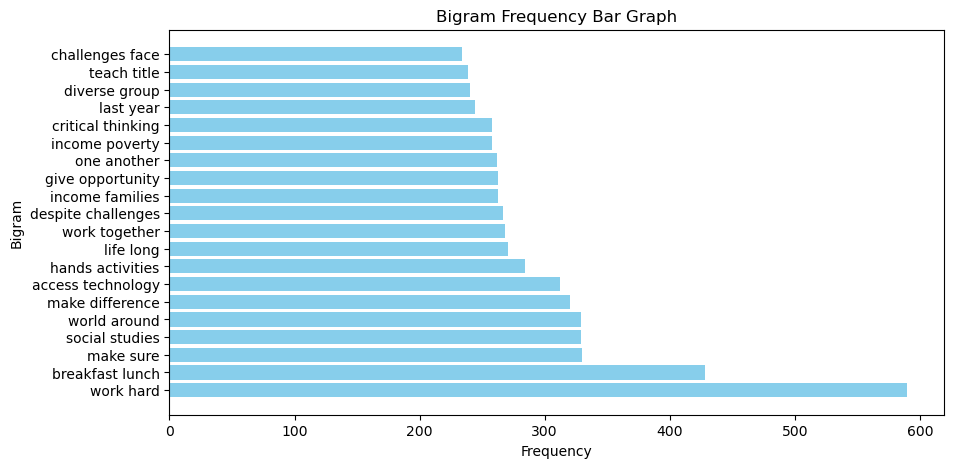

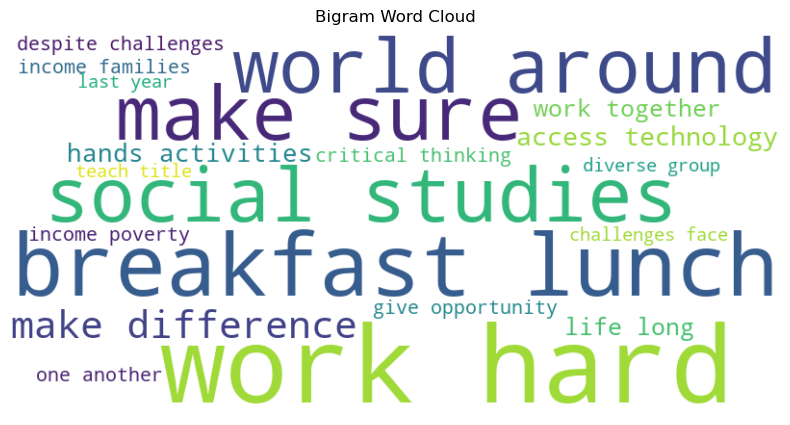

printing top 20 trigrams.....................
{('third', 'languages', 'melting'): 1, ('languages', 'melting', 'pot'): 1, ('melting', 'pot', 'refugees'): 1, ('pot', 'refugees', 'immigrants'): 1, ('refugees', 'immigrants', 'native'): 1, ('immigrants', 'native', 'born'): 1, ('native', 'born', 'americans'): 1, ('born', 'americans', 'bringing'): 1, ('americans', 'bringing', 'gift'): 1, ('bringing', 'gift', 'languages'): 1, ('gift', 'languages', 'represented'): 1, ('languages', 'represented', 'learner'): 1, ('represented', 'learner', 'program'): 1, ('learner', 'program', 'level'): 1, ('program', 'level', 'mastery'): 1, ('level', 'mastery', 'also'): 1, ('mastery', 'also', 'countries'): 1, ('also', 'countries', 'represented'): 1, ('countries', 'represented', 'families'): 1, ('represented', 'families', 'within'): 1}
#######################################################################################################
Approved cleaned_essays  literacy


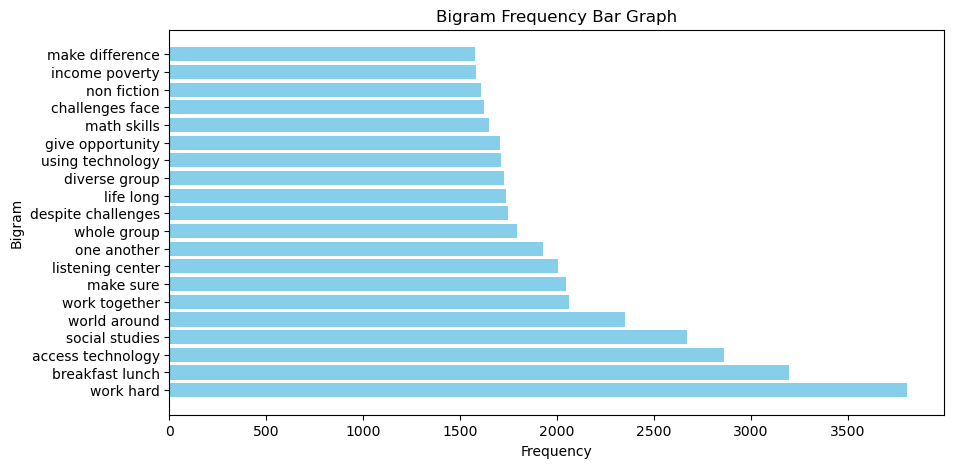

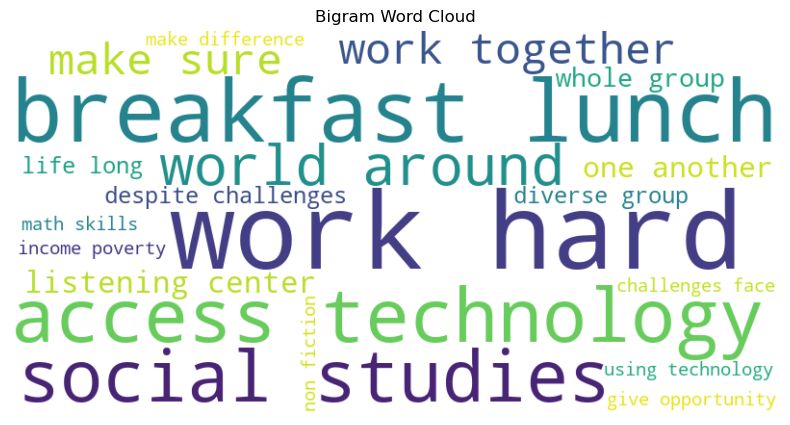

printing top 20 trigrams.....................
{('work', 'unique', 'filled'): 1, ('unique', 'filled', 'esl'): 1, ('filled', 'esl', 'poverty'): 1, ('esl', 'poverty', 'individual'): 1, ('poverty', 'individual', 'personal'): 1, ('individual', 'personal', 'struggles'): 1, ('personal', 'struggles', 'break'): 1, ('struggles', 'break', 'heart'): 1, ('break', 'heart', 'step'): 1, ('heart', 'step', 'doors'): 1, ('step', 'doors', 'notice'): 1, ('doors', 'notice', 'anything'): 1, ('notice', 'anything', 'positive'): 1, ('anything', 'positive', 'resilient'): 1, ('positive', 'resilient', 'attitude'): 1, ('resilient', 'attitude', 'support'): 1, ('attitude', 'support', 'aspect'): 1, ('support', 'aspect', 'journey'): 1, ('aspect', 'journey', 'world'): 1, ('journey', 'world', 'speaking'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  literacy


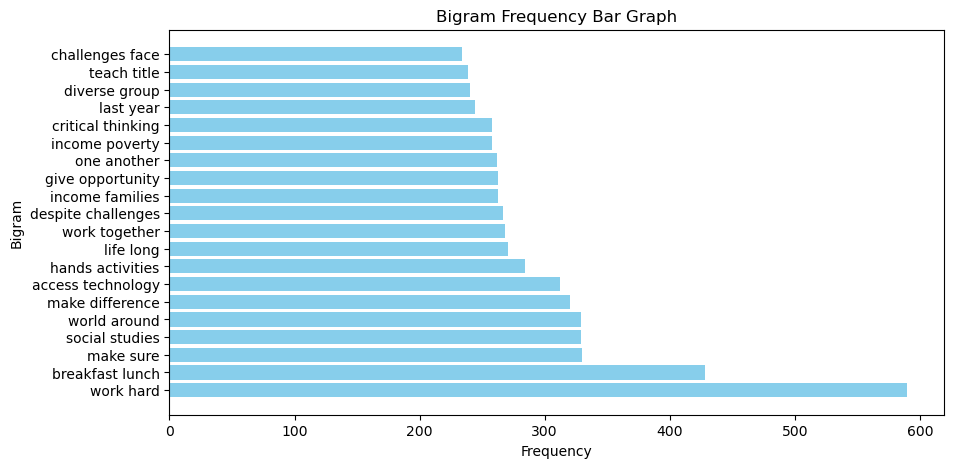

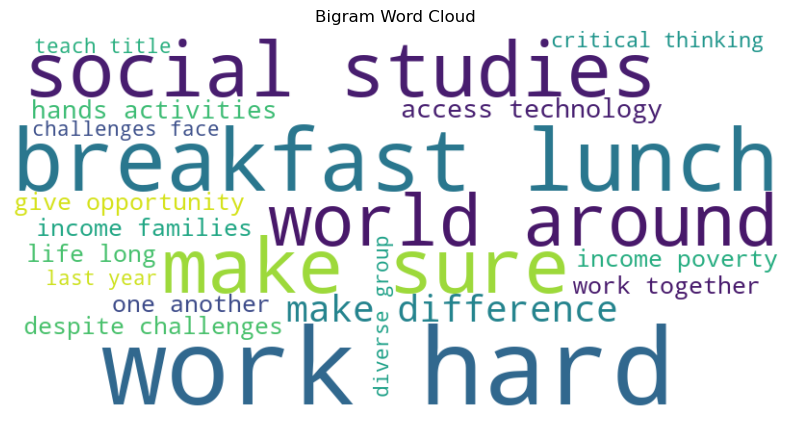

printing top 20 trigrams.....................
{('third', 'languages', 'melting'): 1, ('languages', 'melting', 'pot'): 1, ('melting', 'pot', 'refugees'): 1, ('pot', 'refugees', 'immigrants'): 1, ('refugees', 'immigrants', 'native'): 1, ('immigrants', 'native', 'born'): 1, ('native', 'born', 'americans'): 1, ('born', 'americans', 'bringing'): 1, ('americans', 'bringing', 'gift'): 1, ('bringing', 'gift', 'languages'): 1, ('gift', 'languages', 'represented'): 1, ('languages', 'represented', 'learner'): 1, ('represented', 'learner', 'program'): 1, ('learner', 'program', 'level'): 1, ('program', 'level', 'mastery'): 1, ('level', 'mastery', 'also'): 1, ('mastery', 'also', 'countries'): 1, ('also', 'countries', 'represented'): 1, ('countries', 'represented', 'families'): 1, ('represented', 'families', 'within'): 1}
#######################################################################################################
Approved cleaned_essays  math


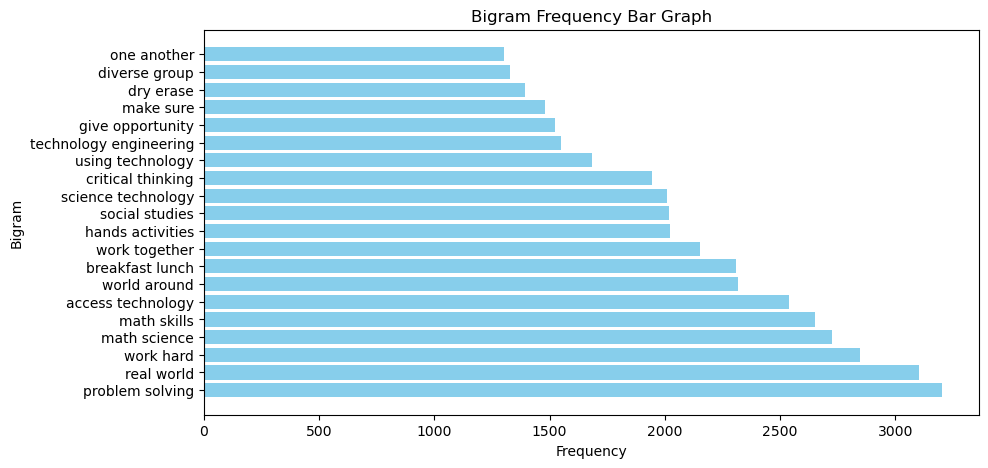

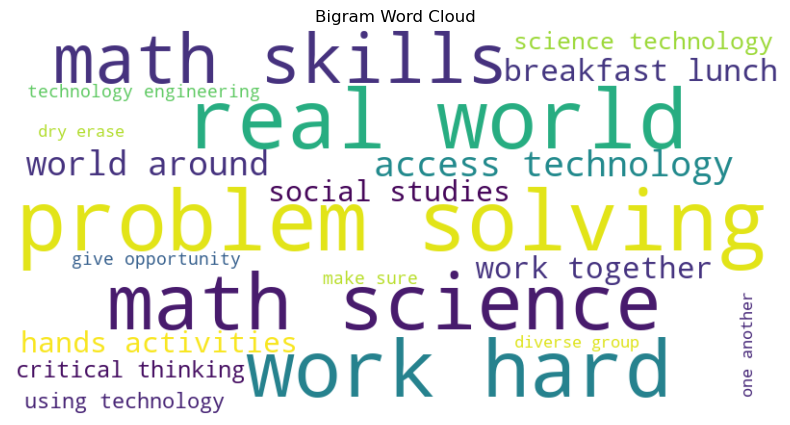

printing top 20 trigrams.....................
{('work', 'unique', 'filled'): 1, ('unique', 'filled', 'esl'): 1, ('filled', 'esl', 'poverty'): 1, ('esl', 'poverty', 'individual'): 1, ('poverty', 'individual', 'personal'): 1, ('individual', 'personal', 'struggles'): 1, ('personal', 'struggles', 'break'): 1, ('struggles', 'break', 'heart'): 1, ('break', 'heart', 'step'): 1, ('heart', 'step', 'doors'): 1, ('step', 'doors', 'notice'): 1, ('doors', 'notice', 'anything'): 1, ('notice', 'anything', 'positive'): 1, ('anything', 'positive', 'resilient'): 1, ('positive', 'resilient', 'attitude'): 1, ('resilient', 'attitude', 'support'): 1, ('attitude', 'support', 'aspect'): 1, ('support', 'aspect', 'journey'): 1, ('aspect', 'journey', 'world'): 1, ('journey', 'world', 'speaking'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  math


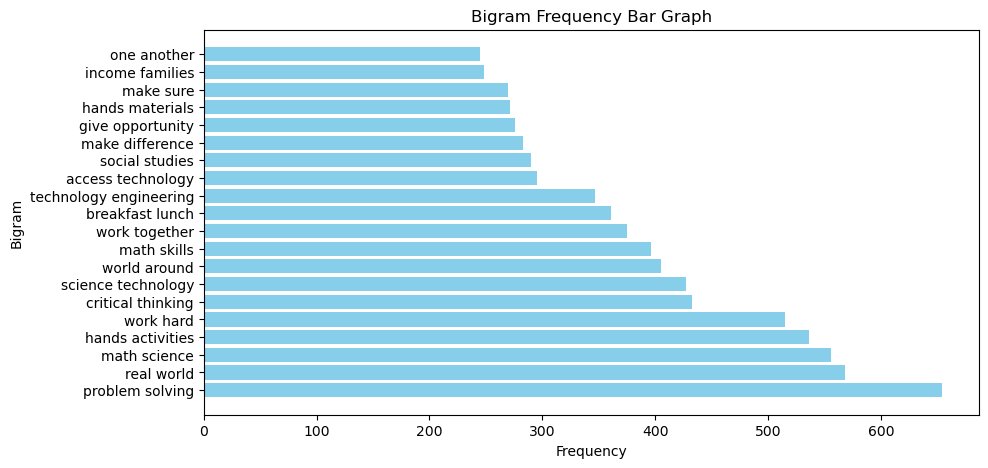

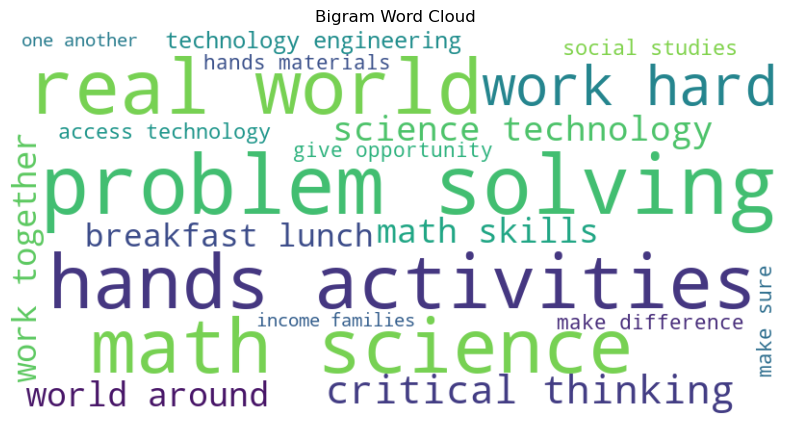

printing top 20 trigrams.....................
{('always', 'projects', 'time'): 1, ('projects', 'time', 'want'): 1, ('time', 'want', 'work'): 1, ('want', 'work', 'enviornment'): 1, ('work', 'enviornment', 'connection'): 1, ('enviornment', 'connection', 'ecosystem'): 1, ('connection', 'ecosystem', 'takes'): 1, ('ecosystem', 'takes', 'time'): 1, ('takes', 'time', 'hard'): 1, ('time', 'hard', 'work'): 1, ('hard', 'work', 'great'): 1, ('work', 'great', 'year'): 1, ('great', 'year', 'cells'): 1, ('year', 'cells', 'bodies'): 1, ('cells', 'bodies', 'organ'): 1, ('bodies', 'organ', 'systems'): 1, ('organ', 'systems', 'class'): 1, ('systems', 'class', 'ready'): 1, ('class', 'ready', 'hands'): 1, ('ready', 'hands', 'experience'): 1}
#######################################################################################################
Approved cleaned_essays  music


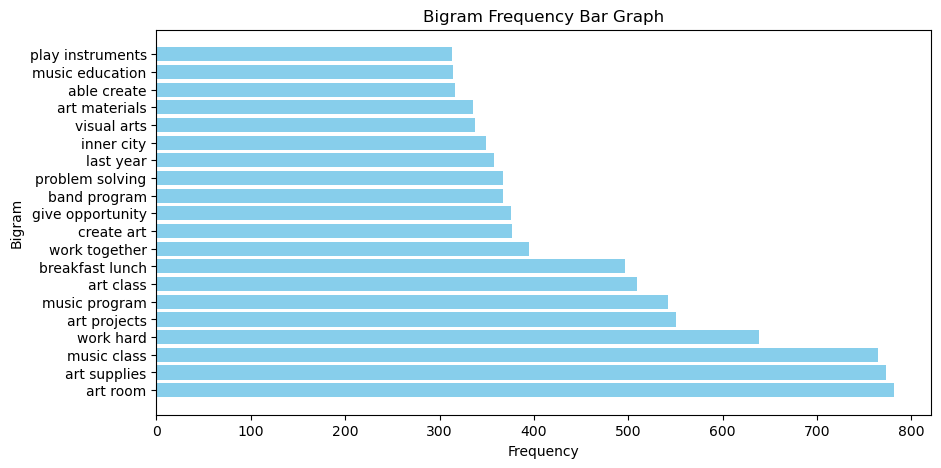

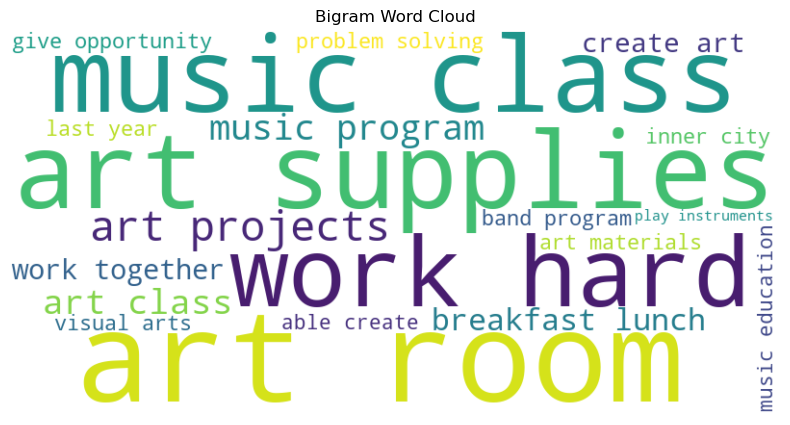

printing top 20 trigrams.....................
{('musical', 'eat', 'breakfast'): 1, ('eat', 'breakfast', 'lunch'): 1, ('breakfast', 'lunch', 'rothschild'): 1, ('lunch', 'rothschild', 'enthusiasm'): 1, ('rothschild', 'enthusiasm', 'however'): 1, ('enthusiasm', 'however', 'bring'): 1, ('however', 'bring', 'making'): 1, ('bring', 'making', 'music'): 1, ('making', 'music', 'exceptional'): 1, ('music', 'exceptional', 'creating'): 1, ('exceptional', 'creating', 'dimensional'): 1, ('creating', 'dimensional', 'orchestra'): 1, ('dimensional', 'orchestra', 'provides'): 1, ('orchestra', 'provides', 'classical'): 1, ('provides', 'classical', 'hip'): 1, ('classical', 'hip', 'hop'): 1, ('hip', 'hop', 'experiences'): 1, ('hop', 'experiences', 'work'): 1, ('experiences', 'work', 'tirelessly'): 1, ('work', 'tirelessly', 'everyday'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  music


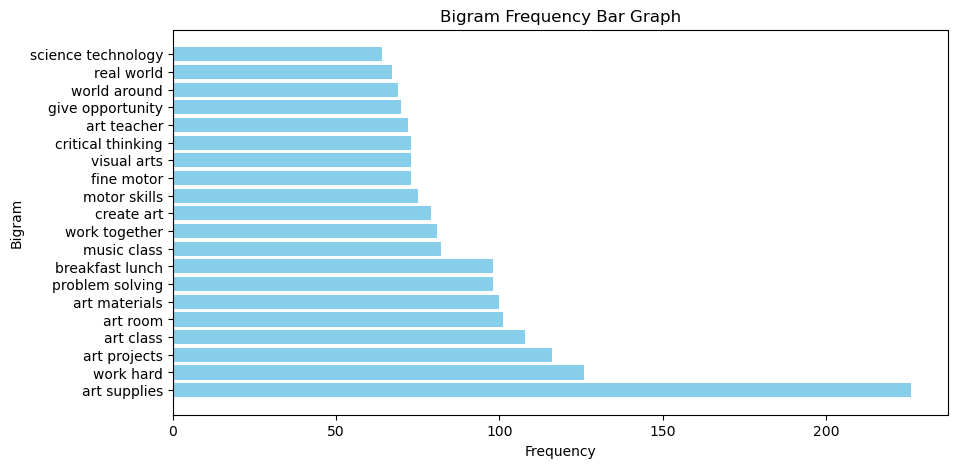

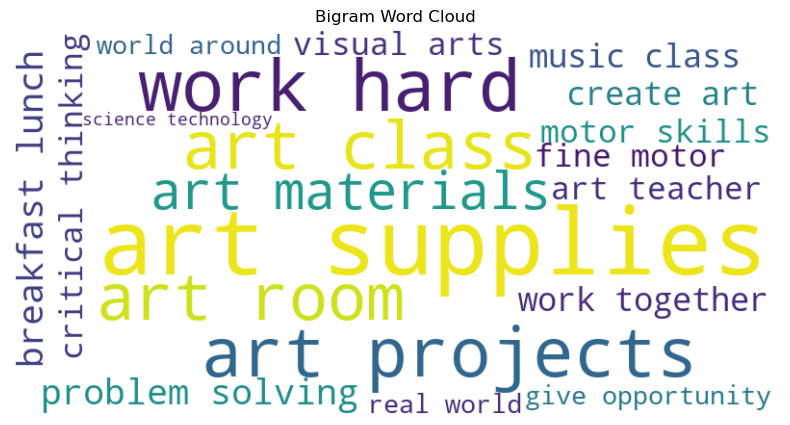

printing top 20 trigrams.....................
{('though', 'schools', 'like'): 1, ('schools', 'like', 'highlight'): 1, ('like', 'highlight', 'diversity'): 1, ('highlight', 'diversity', 'campus'): 1, ('diversity', 'campus', 'truly'): 1, ('campus', 'truly', 'unique'): 1, ('truly', 'unique', 'immigrants'): 1, ('unique', 'immigrants', 'generation'): 1, ('immigrants', 'generation', 'americans'): 1, ('generation', 'americans', 'collectively'): 1, ('americans', 'collectively', 'speak'): 1, ('collectively', 'speak', 'different'): 1, ('speak', 'different', 'languages'): 1, ('different', 'languages', 'giving'): 1, ('languages', 'giving', 'rich'): 1, ('giving', 'rich', 'variety'): 1, ('rich', 'variety', 'cultures'): 1, ('variety', 'cultures', 'explore'): 1, ('cultures', 'explore', 'music'): 1, ('explore', 'music', 'dance'): 1}
#######################################################################################################
Approved cleaned_essays  science


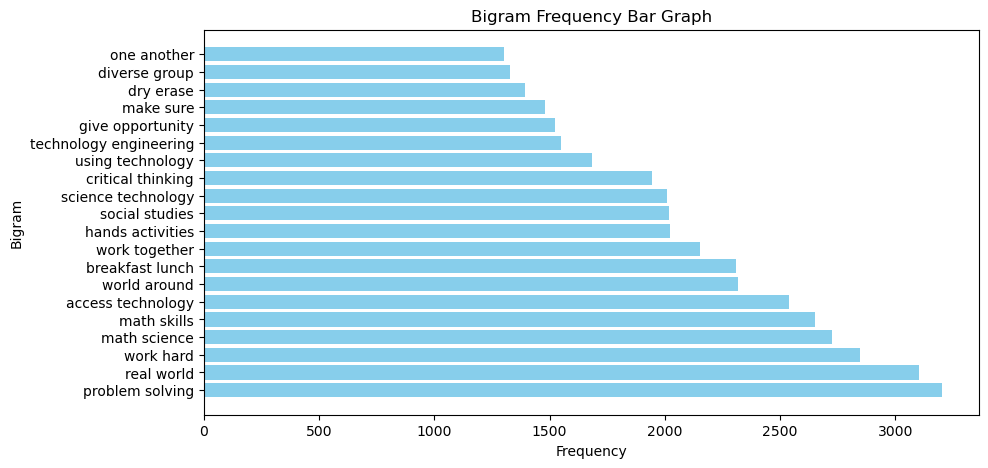

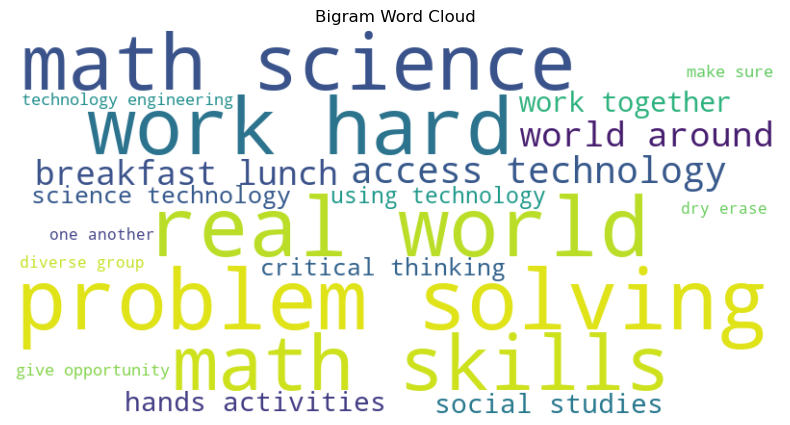

printing top 20 trigrams.....................
{('work', 'unique', 'filled'): 1, ('unique', 'filled', 'esl'): 1, ('filled', 'esl', 'poverty'): 1, ('esl', 'poverty', 'individual'): 1, ('poverty', 'individual', 'personal'): 1, ('individual', 'personal', 'struggles'): 1, ('personal', 'struggles', 'break'): 1, ('struggles', 'break', 'heart'): 1, ('break', 'heart', 'step'): 1, ('heart', 'step', 'doors'): 1, ('step', 'doors', 'notice'): 1, ('doors', 'notice', 'anything'): 1, ('notice', 'anything', 'positive'): 1, ('anything', 'positive', 'resilient'): 1, ('positive', 'resilient', 'attitude'): 1, ('resilient', 'attitude', 'support'): 1, ('attitude', 'support', 'aspect'): 1, ('support', 'aspect', 'journey'): 1, ('aspect', 'journey', 'world'): 1, ('journey', 'world', 'speaking'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  science


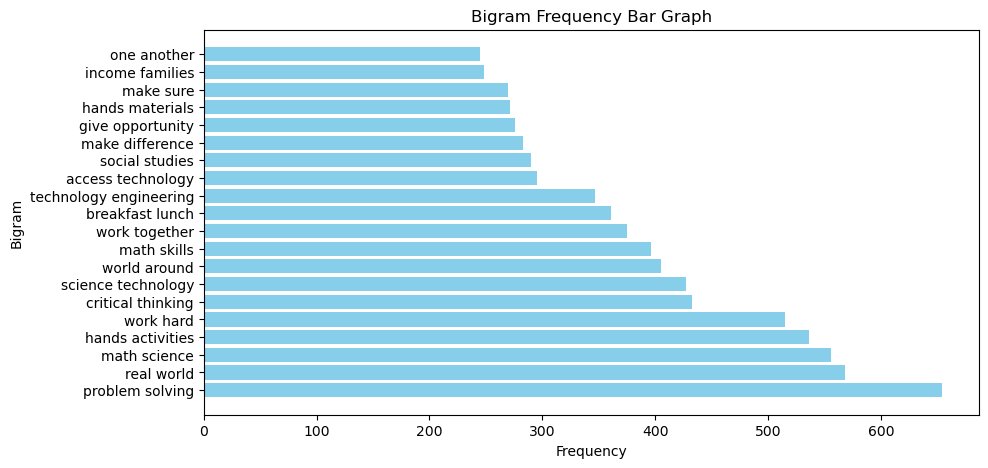

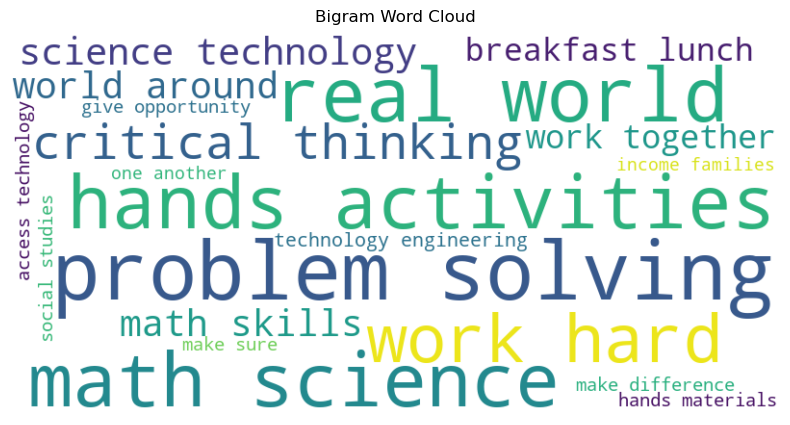

printing top 20 trigrams.....................
{('always', 'projects', 'time'): 1, ('projects', 'time', 'want'): 1, ('time', 'want', 'work'): 1, ('want', 'work', 'enviornment'): 1, ('work', 'enviornment', 'connection'): 1, ('enviornment', 'connection', 'ecosystem'): 1, ('connection', 'ecosystem', 'takes'): 1, ('ecosystem', 'takes', 'time'): 1, ('takes', 'time', 'hard'): 1, ('time', 'hard', 'work'): 1, ('hard', 'work', 'great'): 1, ('work', 'great', 'year'): 1, ('great', 'year', 'cells'): 1, ('year', 'cells', 'bodies'): 1, ('cells', 'bodies', 'organ'): 1, ('bodies', 'organ', 'systems'): 1, ('organ', 'systems', 'class'): 1, ('systems', 'class', 'ready'): 1, ('class', 'ready', 'hands'): 1, ('ready', 'hands', 'experience'): 1}
#######################################################################################################
Approved cleaned_essays  specialneeds


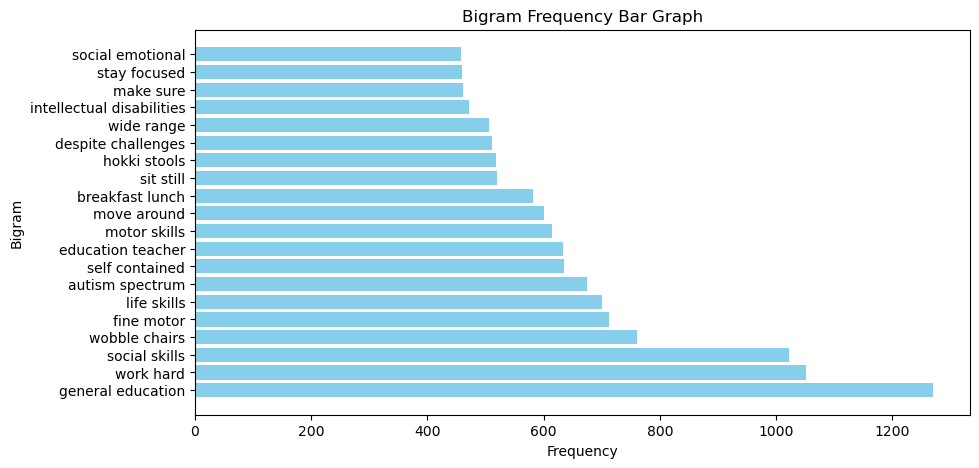

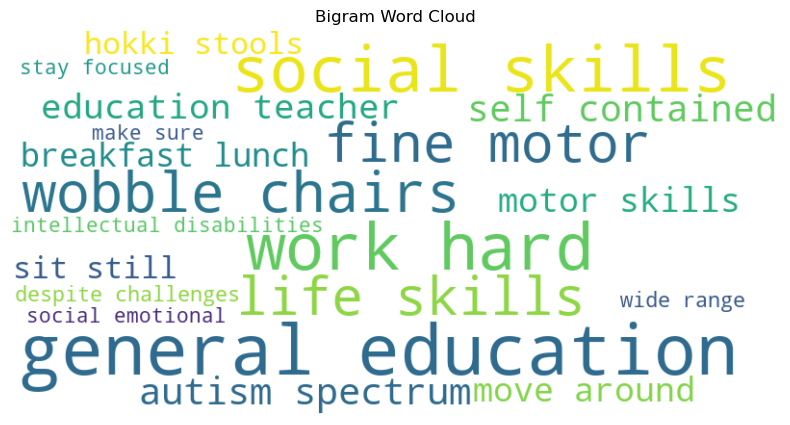

printing top 20 trigrams.....................
{('moving', '2nd', '3rd'): 1, ('2nd', '3rd', 'beginning'): 1, ('3rd', 'beginning', 'next'): 1, ('beginning', 'next', 'year'): 1, ('next', 'year', 'takings'): 1, ('year', 'takings', 'current'): 1, ('takings', 'current', 'move'): 1, ('current', 'move', 'teach'): 1, ('move', 'teach', 'inclusion'): 1, ('teach', 'inclusion', 'includes'): 1, ('inclusion', 'includes', 'adhd'): 1, ('includes', 'adhd', 'sld'): 1, ('adhd', 'sld', 'well'): 1, ('sld', 'well', 'autistic'): 1, ('well', 'autistic', 'work'): 1, ('autistic', 'work', 'hard'): 1, ('work', 'hard', 'achieving'): 1, ('hard', 'achieving', 'goals'): 1, ('achieving', 'goals', 'matter'): 1, ('goals', 'matter', 'struggles'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  specialneeds


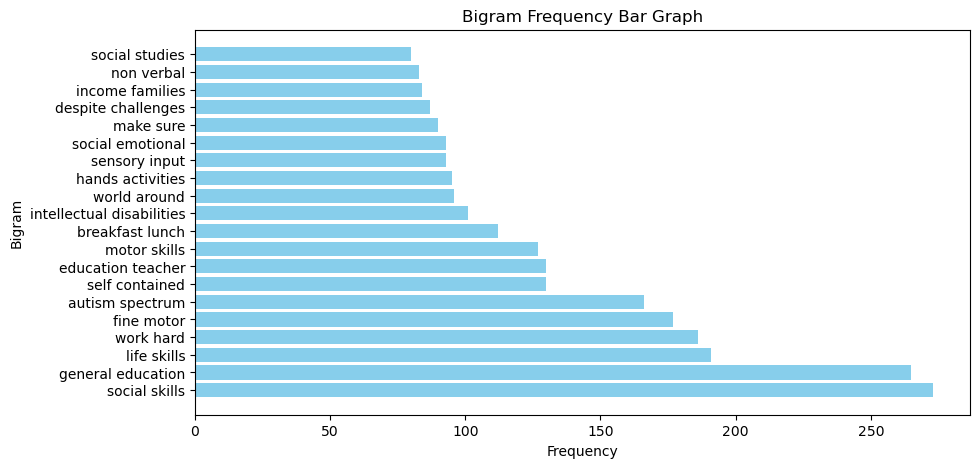

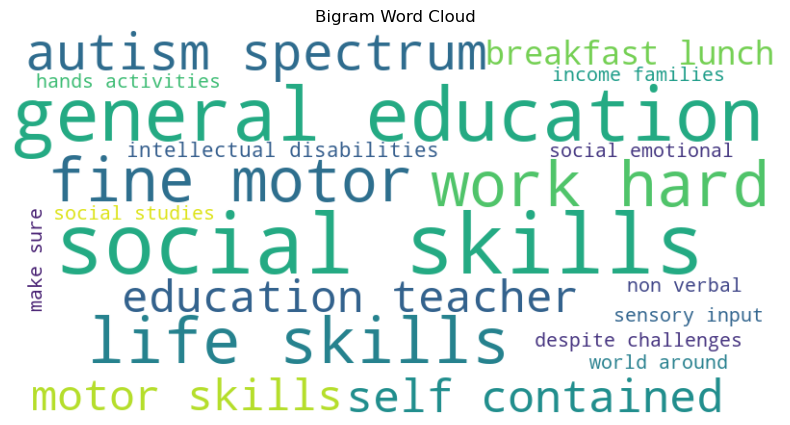

printing top 20 trigrams.....................
{('primary', 'diagnosis', 'autism'): 1, ('diagnosis', 'autism', 'secondary'): 1, ('autism', 'secondary', 'tertiary'): 1, ('secondary', 'tertiary', 'diagnoses'): 1, ('tertiary', 'diagnoses', 'live'): 1, ('diagnoses', 'live', 'military'): 1, ('live', 'military', 'town'): 1, ('military', 'town', 'transiency'): 1, ('town', 'transiency', 'big'): 1, ('transiency', 'big', 'issue'): 1, ('big', 'issue', 'require'): 1, ('issue', 'require', 'regular'): 1, ('require', 'regular', 'practice'): 1, ('regular', 'practice', 'frequent'): 1, ('practice', 'frequent', 'review'): 1, ('frequent', 'review', 'learned'): 1, ('review', 'learned', 'material'): 1, ('learned', 'material', 'exceptional'): 1, ('material', 'exceptional', 'go'): 1, ('exceptional', 'go', 'title'): 1}
#######################################################################################################
Approved cleaned_essays  sports


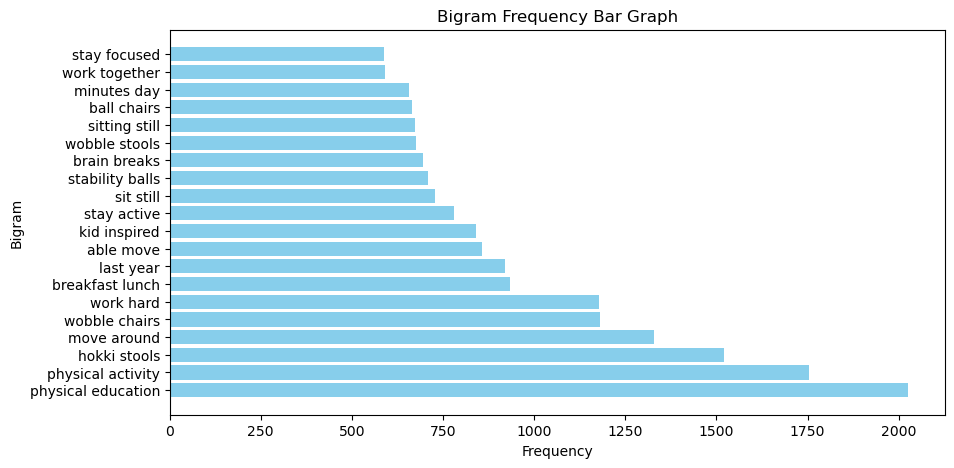

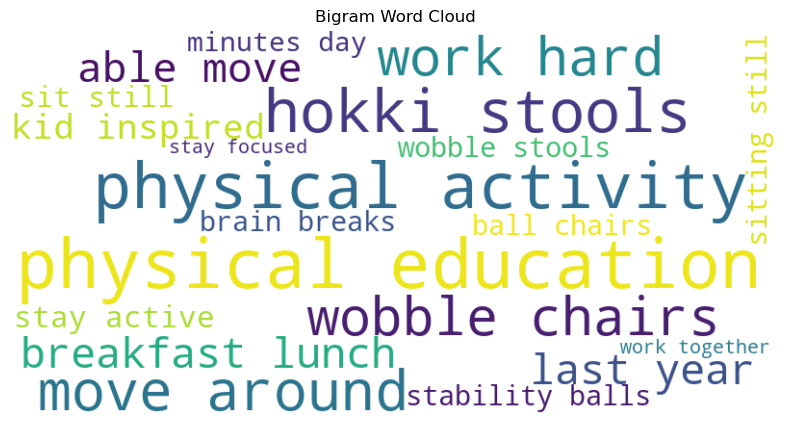

printing top 20 trigrams.....................
{('arrive', 'eager', 'polite'): 1, ('eager', 'polite', 'generous'): 1, ('polite', 'generous', 'strive'): 1, ('generous', 'strive', 'best'): 1, ('strive', 'best', 'know'): 1, ('best', 'know', 'education'): 1, ('know', 'education', 'succeed'): 1, ('education', 'succeed', 'life'): 1, ('succeed', 'life', 'improve'): 1, ('life', 'improve', 'lives'): 1, ('improve', 'lives', 'focuses'): 1, ('lives', 'focuses', 'families'): 1, ('focuses', 'families', 'incomes'): 1, ('families', 'incomes', 'tries'): 1, ('incomes', 'tries', 'give'): 1, ('tries', 'give', 'education'): 1, ('give', 'education', 'deserve'): 1, ('education', 'deserve', 'much'): 1, ('deserve', 'much', 'materials'): 1, ('much', 'materials', 'given'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  sports


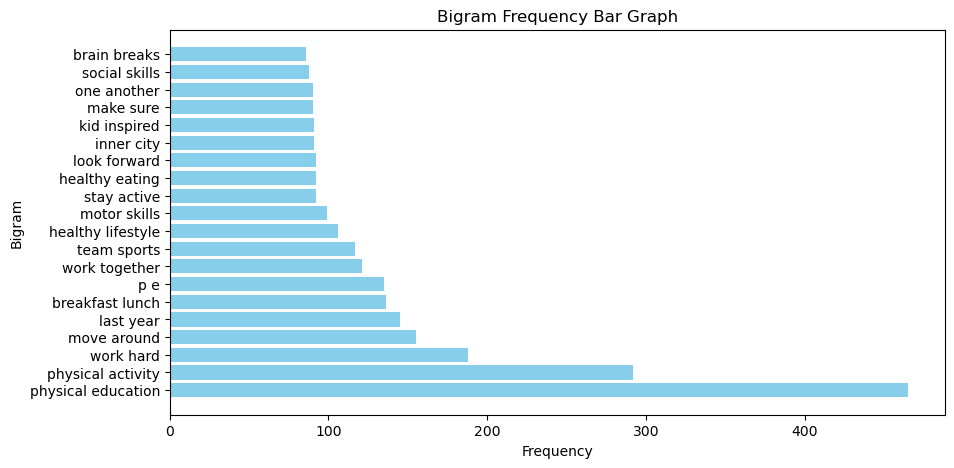

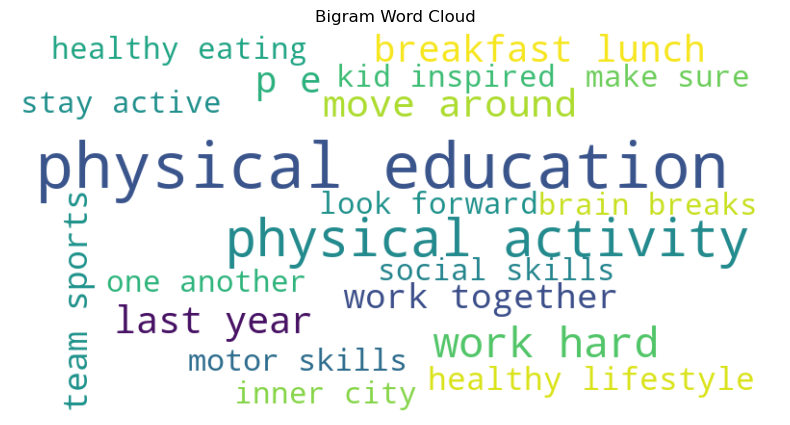

printing top 20 trigrams.....................
{('true', 'champions', 'always'): 1, ('champions', 'always', 'ones'): 1, ('always', 'ones', 'win'): 1, ('ones', 'win', 'guts'): 1, ('win', 'guts', 'mia'): 1, ('guts', 'mia', 'hamm'): 1, ('mia', 'hamm', 'quote'): 1, ('hamm', 'quote', 'best'): 1, ('quote', 'best', 'describes'): 1, ('best', 'describes', 'cholla'): 1, ('describes', 'cholla', 'middle'): 1, ('cholla', 'middle', 'approach'): 1, ('middle', 'approach', 'playing'): 1, ('approach', 'playing', 'sports'): 1, ('playing', 'sports', 'especially'): 1, ('sports', 'especially', 'girls'): 1, ('especially', 'girls', 'boys'): 1, ('girls', 'boys', 'soccer'): 1, ('boys', 'soccer', 'teams'): 1, ('soccer', 'teams', 'teams'): 1}
#######################################################################################################
Approved cleaned_essays  warmth


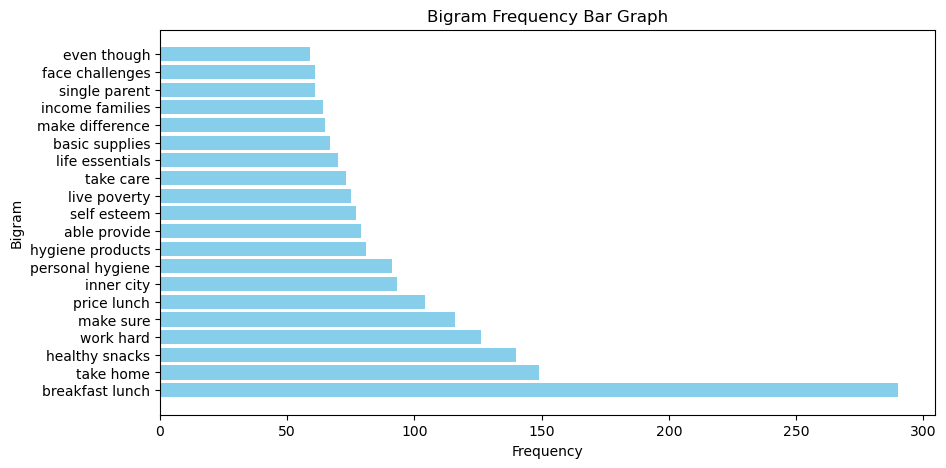

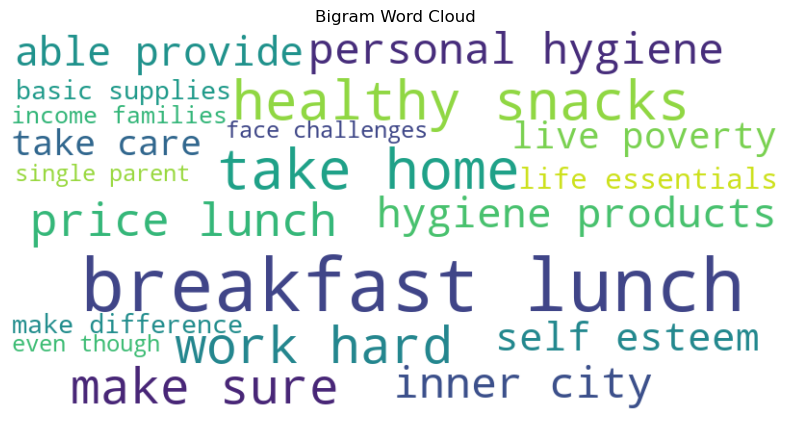

printing top 20 trigrams.....................
{('work', 'hard', 'best'): 1, ('hard', 'best', 'leaders'): 1, ('best', 'leaders', 'located'): 1, ('leaders', 'located', 'memphis'): 1, ('located', 'memphis', 'tennessee'): 1, ('memphis', 'tennessee', 'homes'): 1, ('tennessee', 'homes', 'obstacles'): 1, ('homes', 'obstacles', 'overcome'): 1, ('obstacles', 'overcome', 'single'): 1, ('overcome', 'single', 'parent'): 1, ('single', 'parent', 'households'): 1, ('parent', 'households', 'live'): 1, ('households', 'live', 'poverty'): 1, ('live', 'poverty', 'make'): 1, ('poverty', 'make', 'goal'): 1, ('make', 'goal', 'take'): 1, ('goal', 'take', 'reality'): 1, ('take', 'reality', 'despite'): 1, ('reality', 'despite', 'obstacles'): 1, ('despite', 'obstacles', 'rise'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_essays  warmth


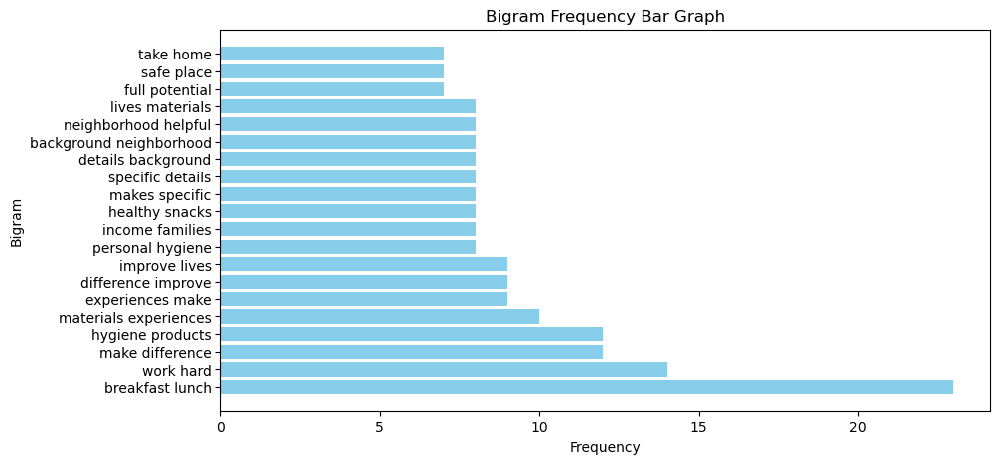

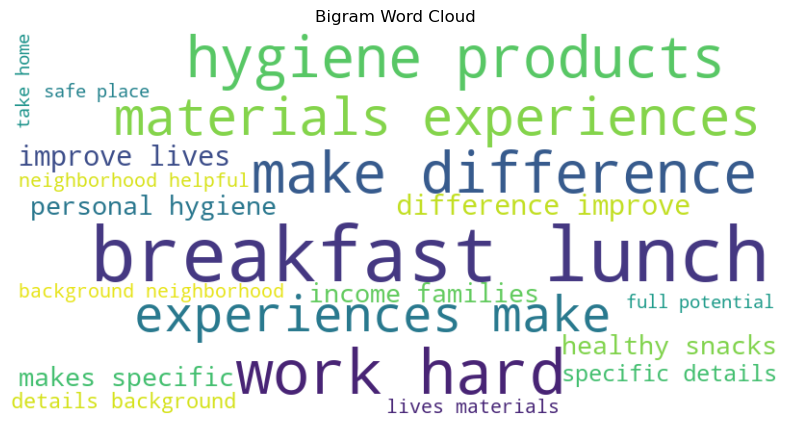

printing top 20 trigrams.....................
{('teach', 'poverty', 'middle'): 1, ('poverty', 'middle', 'silicon'): 1, ('middle', 'silicon', 'valley'): 1, ('silicon', 'valley', 'east'): 1, ('valley', 'east', 'palo'): 1, ('east', 'palo', 'alto'): 1, ('palo', 'alto', 'california'): 1, ('alto', 'california', 'ninety'): 1, ('california', 'ninety', 'nine'): 1, ('ninety', 'nine', 'percent'): 1, ('nine', 'percent', 'lunch'): 1, ('percent', 'lunch', 'starling'): 1, ('lunch', 'starling', 'number'): 1, ('starling', 'number', 'considered'): 1, ('number', 'considered', 'homeless'): 1, ('considered', 'homeless', 'due'): 1, ('homeless', 'due', 'living'): 1, ('due', 'living', 'conditions'): 1, ('living', 'conditions', 'particularly'): 1, ('conditions', 'particularly', 'families'): 1}
#######################################################################################################
Approved cleaned_summary  appliedlearning


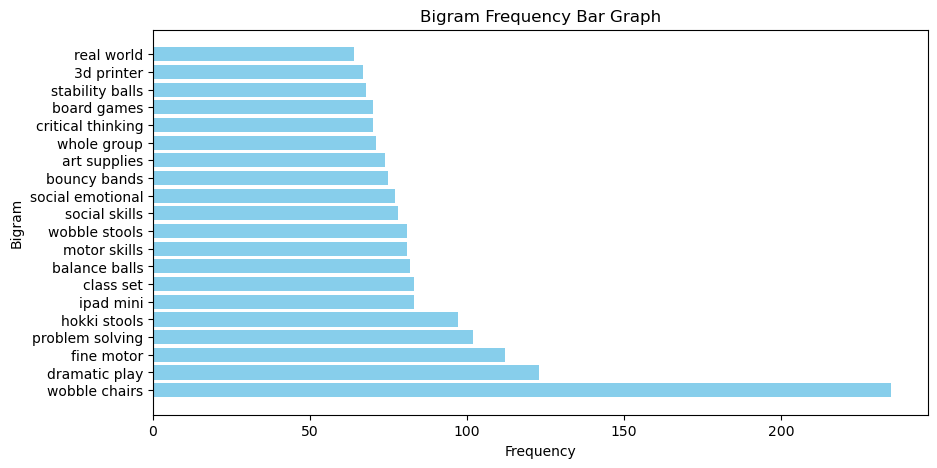

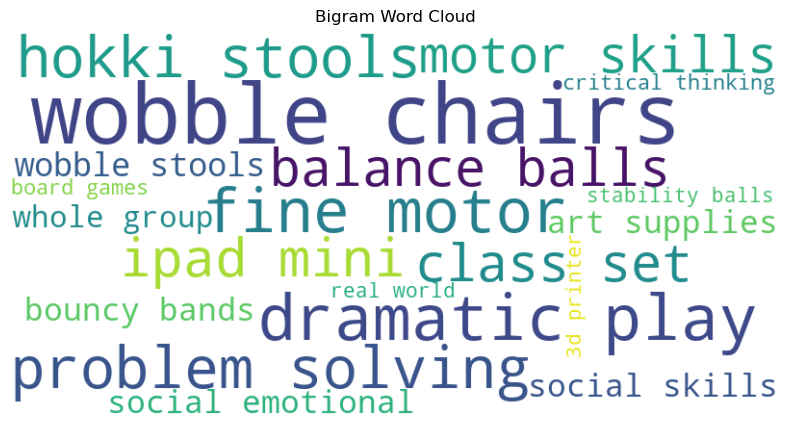

printing top 20 trigrams.....................
{('paper', 'three', 'chromebooks'): 1, ('three', 'chromebooks', 'keyboard'): 1, ('chromebooks', 'keyboard', 'cover'): 1, ('keyboard', 'cover', 'enhance'): 1, ('cover', 'enhance', 'center'): 1, ('enhance', 'center', 'introduce'): 1, ('center', 'introduce', 'parents'): 1, ('introduce', 'parents', 'technology'): 1, ('parents', 'technology', 'programs'): 1, ('technology', 'programs', 'used'): 1, ('programs', 'used', 'site'): 1, ('privacy', 'partitions', 'testing'): 1, ('partitions', 'testing', 'independent'): 1, ('testing', 'independent', 'work'): 1, ('basic', 'supplies', 'pencils'): 1, ('supplies', 'pencils', 'pencil'): 1, ('pencils', 'pencil', 'top'): 1, ('pencil', 'top', 'erasers'): 1, ('top', 'erasers', 'glue'): 1, ('erasers', 'glue', 'sticks'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  appliedlearning


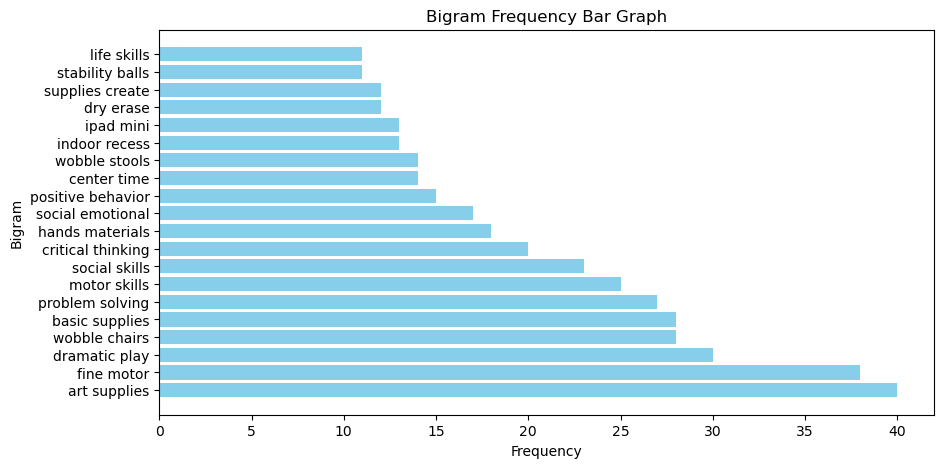

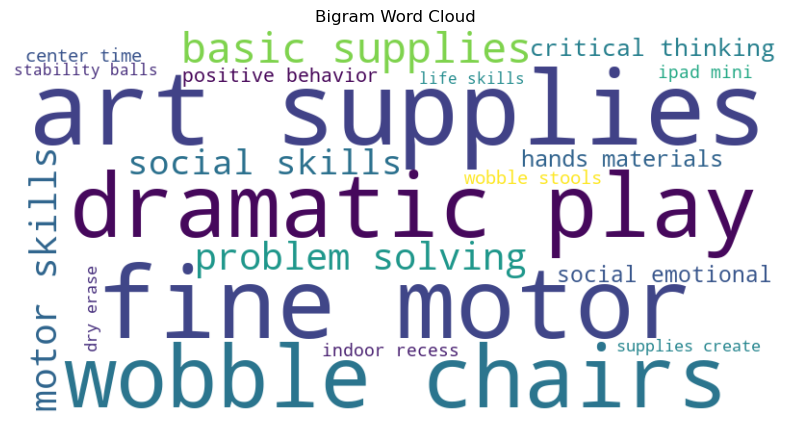

printing top 20 trigrams.....................
{('supplies', 'go', 'college'): 1, ('go', 'college', 'hope'): 1, ('college', 'hope', 'raffle'): 1, ('hope', 'raffle', 'dorm'): 1, ('raffle', 'dorm', 'items'): 1, ('dorm', 'items', 'college'): 1, ('items', 'college', 'signing'): 1, ('college', 'signing', 'rally'): 1, ('interactive', 'games', 'focused'): 1, ('games', 'focused', 'growth'): 1, ('focused', 'growth', 'mindset'): 1, ('growth', 'mindset', 'persevere'): 1, ('mindset', 'persevere', 'work'): 1, ('persevere', 'work', 'hard'): 1, ('work', 'hard', 'want'): 1, ('hard', 'want', 'requesting'): 1, ('want', 'requesting', 'growth'): 1, ('requesting', 'growth', 'mindset'): 1, ('growth', 'mindset', 'curriculum'): 1, ('mindset', 'curriculum', 'interactive'): 1}
#######################################################################################################
Approved cleaned_summary  arts


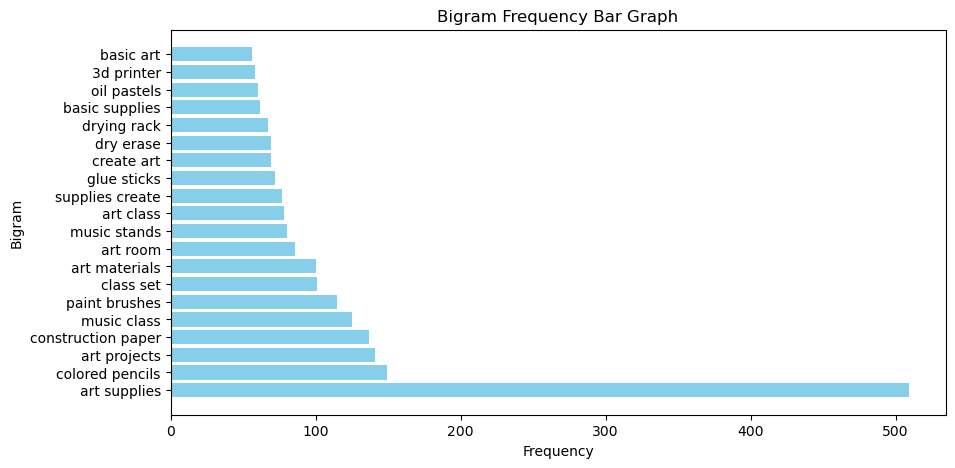

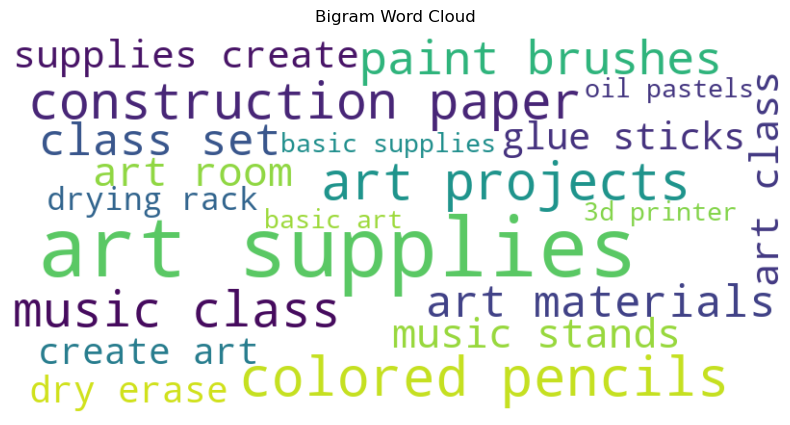

printing top 20 trigrams.....................
{('instruments', 'give', 'tools'): 1, ('give', 'tools', 'grow'): 1, ('tools', 'grow', 'musically'): 1, ('two', 'chromebooks', 'chromecast'): 1, ('chromebooks', 'chromecast', 'colored'): 1, ('chromecast', 'colored', 'printer'): 1, ('colored', 'printer', 'ink'): 1, ('ink', 'continue', 'make'): 1, ('continue', 'make', 'fine'): 1, ('make', 'fine', 'art'): 1, ('fine', 'art', 'glicee'): 1, ('art', 'glicee', 'prints'): 1, ('glicee', 'prints', 'photographic'): 1, ('prints', 'photographic', 'images'): 1, ('artist', 'resource', 'art'): 1, ('resource', 'art', 'history'): 1, ('art', 'history', 'posters'): 1, ('history', 'posters', 'create'): 1, ('posters', 'create', 'solid'): 1, ('create', 'solid', 'understanding'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  arts


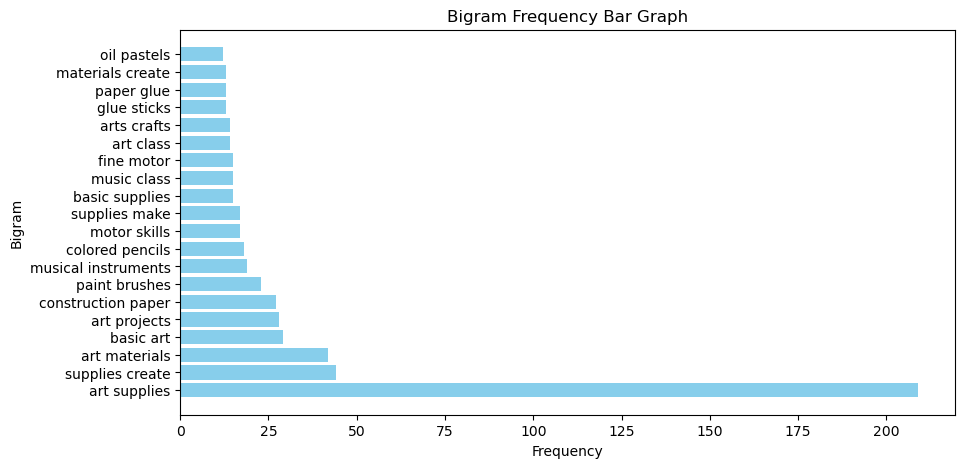

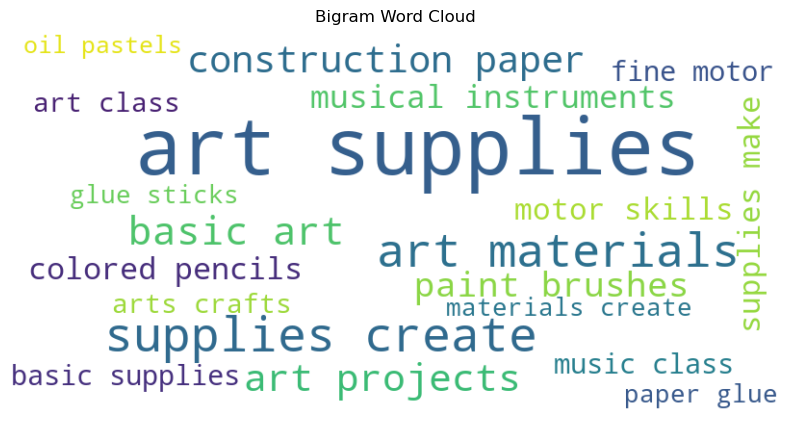

printing top 20 trigrams.....................
{('orff', 'instruments', 'guitars'): 1, ('instruments', 'guitars', 'ukuleles'): 1, ('guitars', 'ukuleles', 'brand'): 1, ('ukuleles', 'brand', 'music'): 1, ('brand', 'music', 'program'): 1, ('safety', 'basic', 'equipment'): 1, ('basic', 'equipment', 'start'): 1, ('equipment', 'start', 'ceramics'): 1, ('start', 'ceramics', 'program'): 1, ('guitar', 'picks', 'guitar'): 1, ('picks', 'guitar', 'tuners'): 1, ('guitar', 'tuners', 'brand'): 1, ('tuners', 'brand', 'guitar'): 1, ('brand', 'guitar', 'course'): 1, ('guitar', 'course', 'often'): 1, ('course', 'often', 'afford'): 1, ('often', 'afford', 'thank'): 1, ('afford', 'thank', 'generous'): 1, ('thank', 'generous', 'support'): 1, ('essentials', 'like', 'glue'): 1}
#######################################################################################################
Approved cleaned_summary  care


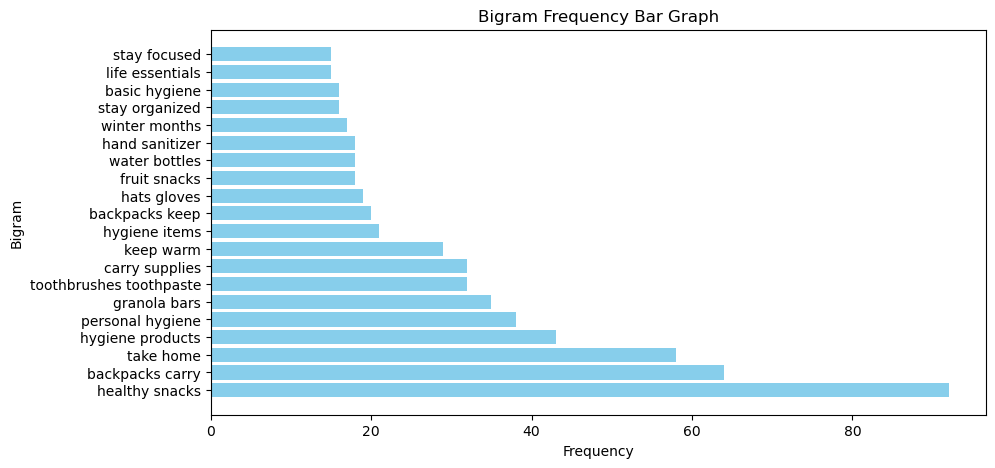

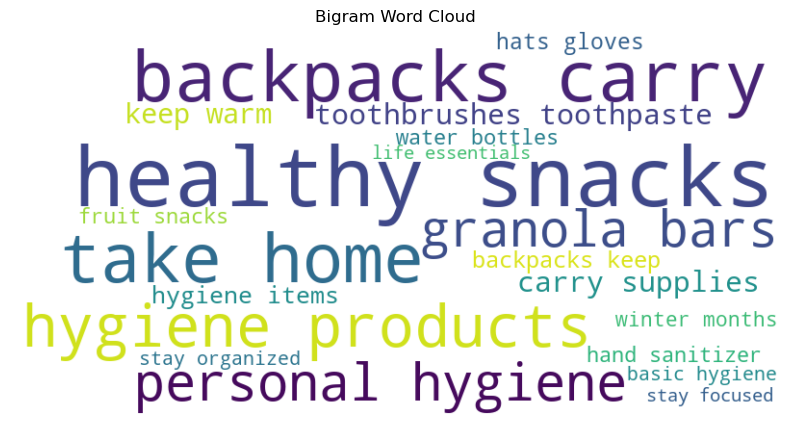

printing top 20 trigrams.....................
{('sanitary', 'napkins', 'wipes'): 1, ('napkins', 'wipes', 'lotion'): 1, ('wipes', 'lotion', 'soap'): 1, ('lotion', 'soap', 'keep'): 1, ('soap', 'keep', 'clean'): 1, ('following', 'life', 'essentials'): 1, ('life', 'essentials', 'tshirts'): 1, ('essentials', 'tshirts', 'hoodies'): 1, ('tshirts', 'hoodies', 'umbrellas'): 1, ('hoodies', 'umbrellas', 'rain'): 1, ('umbrellas', 'rain', 'boots'): 1, ('rain', 'boots', 'improve'): 1, ('boots', 'improve', 'quality'): 1, ('improve', 'quality', 'life'): 1, ('safe', 'environment', 'feel'): 1, ('environment', 'feel', 'cared'): 1, ('feel', 'cared', 'secure'): 1, ('cared', 'secure', 'loved'): 1, ('secure', 'loved', 'appropriate'): 1, ('loved', 'appropriate', 'furnishings'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  care


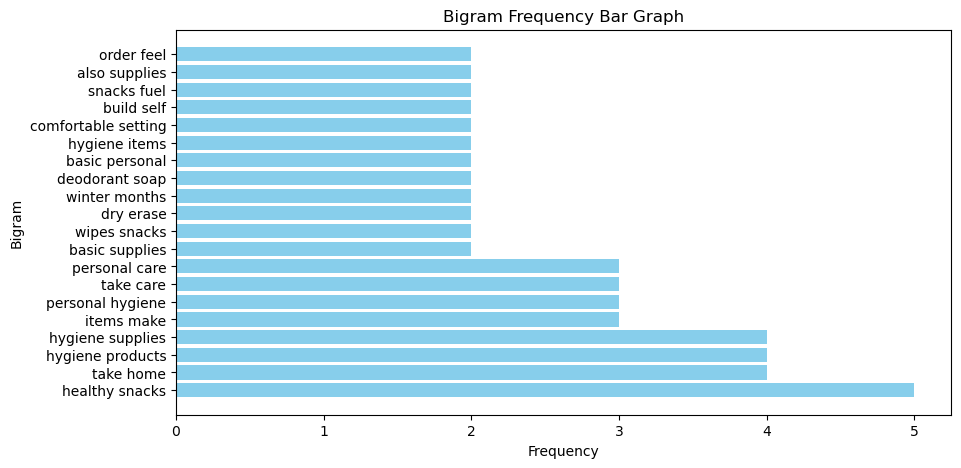

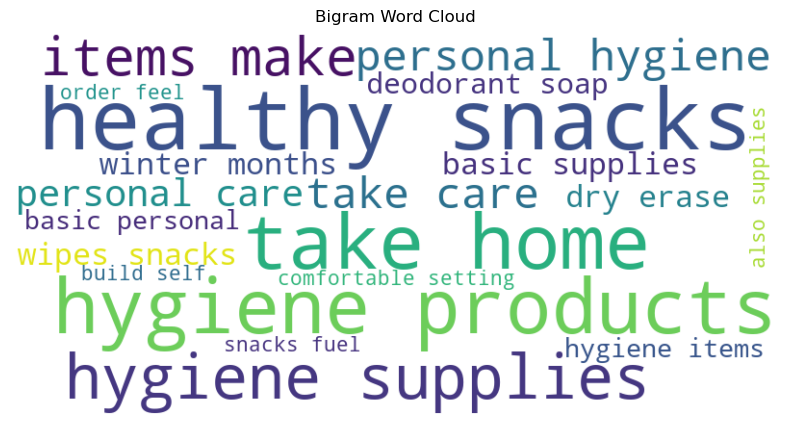

printing top 20 trigrams.....................
{('supplies', 'art', 'calligraphy'): 1, ('essentials', 'houselessness', 'including'): 1, ('houselessness', 'including', 'travel'): 1, ('including', 'travel', 'bag'): 1, ('travel', 'bag', 'essentials'): 1, ('bag', 'essentials', 'printed'): 1, ('essentials', 'printed', 'information'): 1, ('printed', 'information', 'community'): 1, ('information', 'community', 'resources'): 1, ('community', 'resources', 'accessing'): 1, ('resources', 'accessing', 'additional'): 1, ('accessing', 'additional', 'basic'): 1, ('additional', 'basic', 'supplies'): 1, ('dry', 'goods', 'make'): 1, ('goods', 'make', 'laundry'): 1, ('make', 'laundry', 'soap'): 1, ('options', 'accommodate', 'feel'): 1, ('accommodate', 'feel', 'safe'): 1, ('feel', 'safe', 'comfortable'): 1, ('safe', 'comfortable', 'provide'): 1}
#######################################################################################################
Approved cleaned_summary  civics


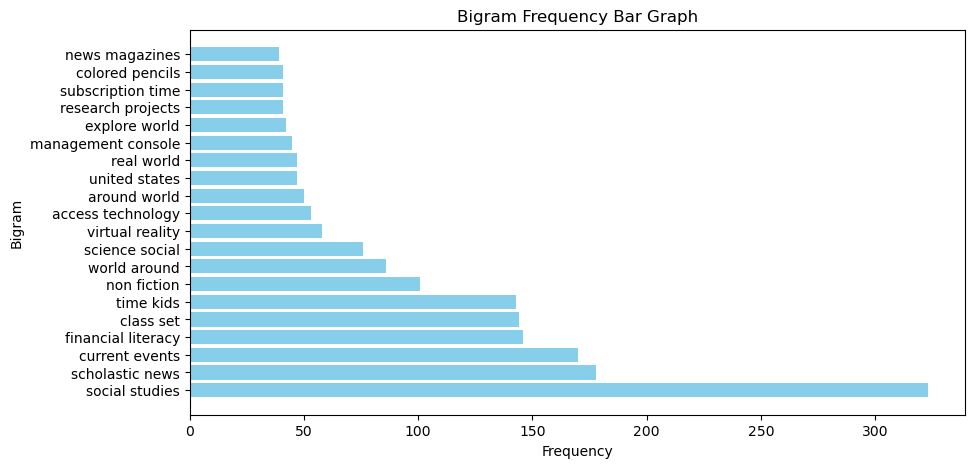

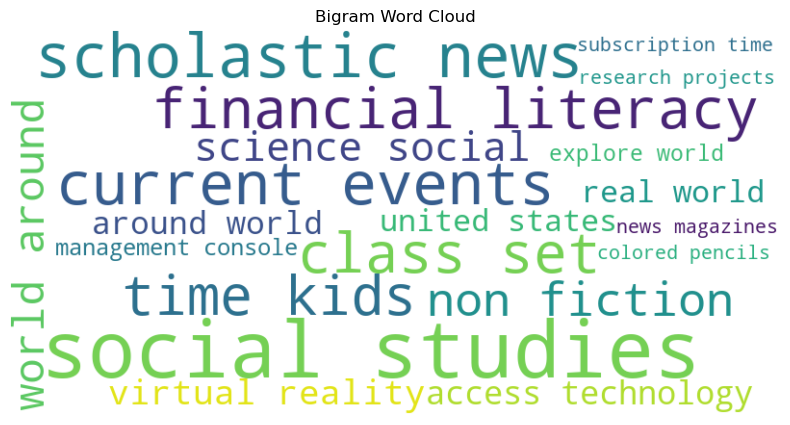

printing top 20 trigrams.....................
{('projector', 'viewing', 'educational'): 1, ('viewing', 'educational', 'programs'): 1, ('work', 'station', 'move'): 1, ('station', 'move', 'sit'): 1, ('move', 'sit', 'stand'): 1, ('sit', 'stand', 'desks'): 1, ('stand', 'desks', 'easily'): 1, ('desks', 'easily', 'adjust'): 1, ('easily', 'adjust', 'feel'): 1, ('adjust', 'feel', 'stand'): 1, ('feel', 'stand', 'sit'): 1, ('stand', 'sit', 'lesson'): 1, ('sit', 'lesson', 'desk'): 1, ('lesson', 'desk', 'group'): 1, ('desk', 'group', 'work'): 1, ('fiction', 'non', 'fiction'): 1, ('non', 'fiction', 'provide'): 1, ('fiction', 'provide', 'insight'): 1, ('provide', 'insight', 'encourage'): 1, ('insight', 'encourage', 'conversation'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  civics


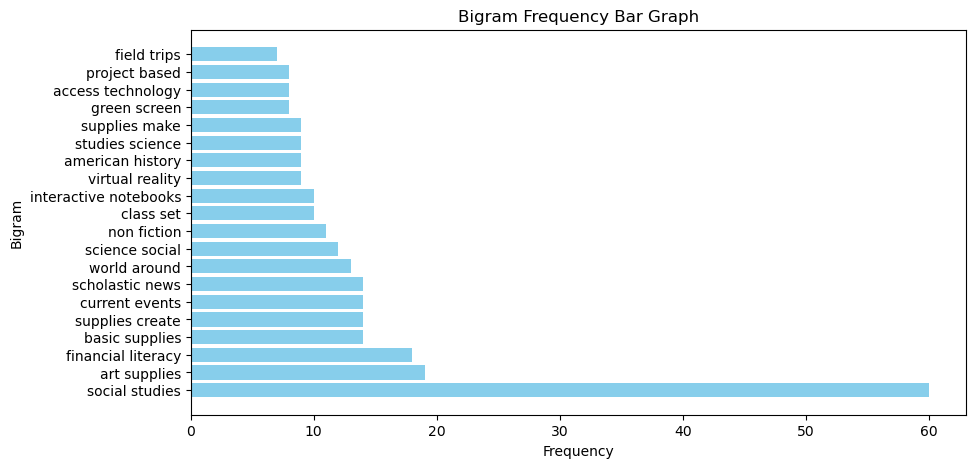

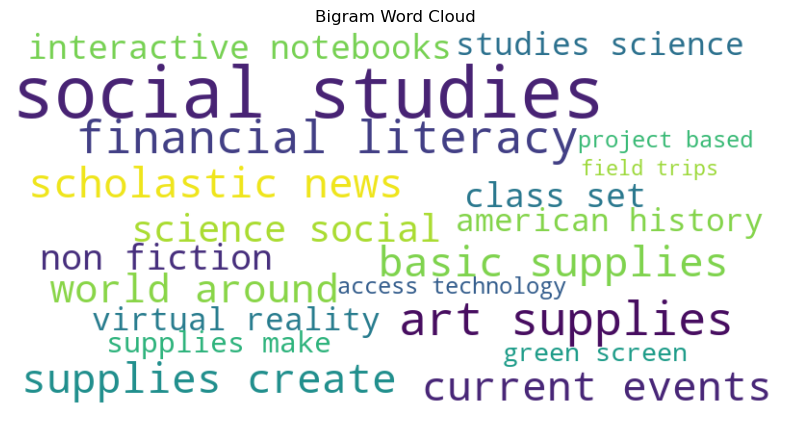

printing top 20 trigrams.....................
{('national', 'parks', 'planets'): 1, ('parks', 'planets', 'supplement'): 1, ('planets', 'supplement', 'class'): 1, ('literature', 'interactive', 'games'): 1, ('interactive', 'games', 'reinforce'): 1, ('games', 'reinforce', 'social'): 1, ('reinforce', 'social', 'studies'): 1, ('social', 'studies', 'concepts'): 1, ('ipad', 'teach', 'age'): 1, ('teach', 'age', 'programs'): 1, ('age', 'programs', 'pages'): 1, ('programs', 'pages', 'numbers'): 1, ('pages', 'numbers', 'keynotes'): 1, ('shirts', 'markers', 'create'): 1, ('markers', 'create', 'shirts'): 1, ('create', 'shirts', 'local'): 1, ('shirts', 'local', 'landmarks'): 1, ('local', 'landmarks', 'artwork'): 1, ('landmarks', 'artwork', 'studying'): 1, ('artwork', 'studying', 'city'): 1}
#######################################################################################################
Approved cleaned_summary  health


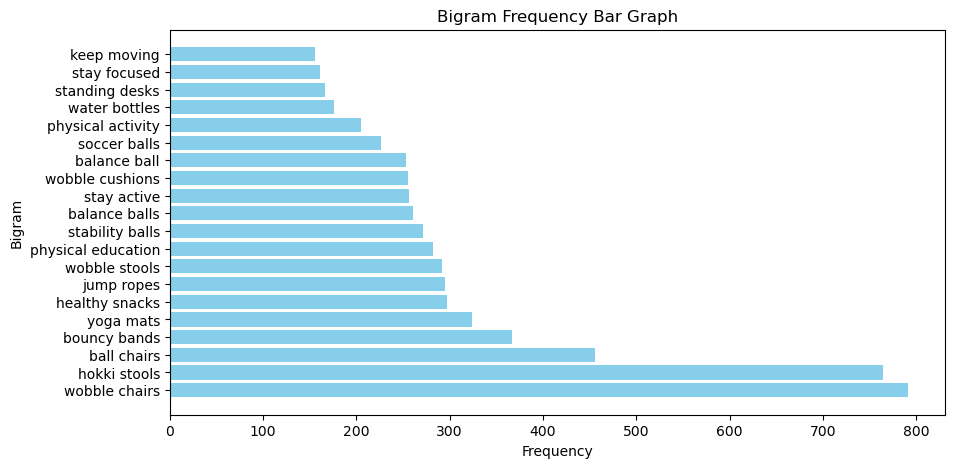

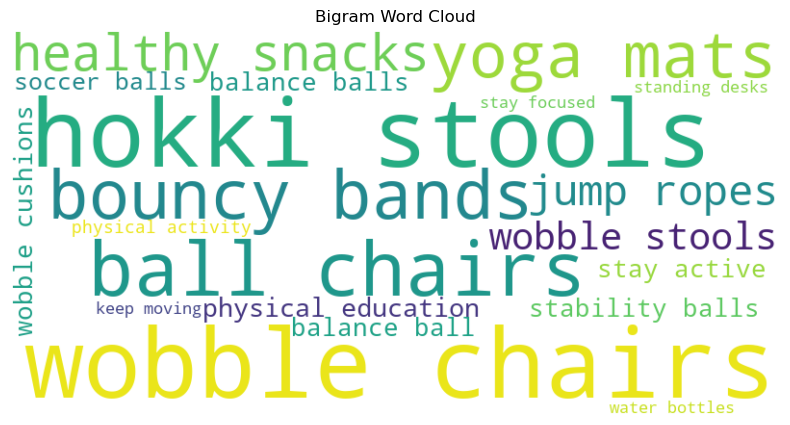

printing top 20 trigrams.....................
{('projector', 'viewing', 'educational'): 1, ('viewing', 'educational', 'programs'): 1, ('three', 'devices', 'three'): 1, ('devices', 'three', 'management'): 1, ('three', 'management', 'licenses'): 1, ('management', 'licenses', 'group'): 1, ('licenses', 'group', 'easy'): 1, ('group', 'easy', 'access'): 1, ('easy', 'access', 'newly'): 1, ('access', 'newly', 'implemented'): 1, ('newly', 'implemented', 'online'): 1, ('implemented', 'online', 'programs'): 1, ('online', 'programs', 'go'): 1, ('programs', 'go', 'noodle'): 1, ('go', 'noodle', 'plus'): 1, ('noodle', 'plus', 'increased'): 1, ('plus', 'increased', 'class'): 1, ('increased', 'class', 'physical'): 1, ('class', 'physical', 'activity'): 1, ('physical', 'activity', 'light'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  health


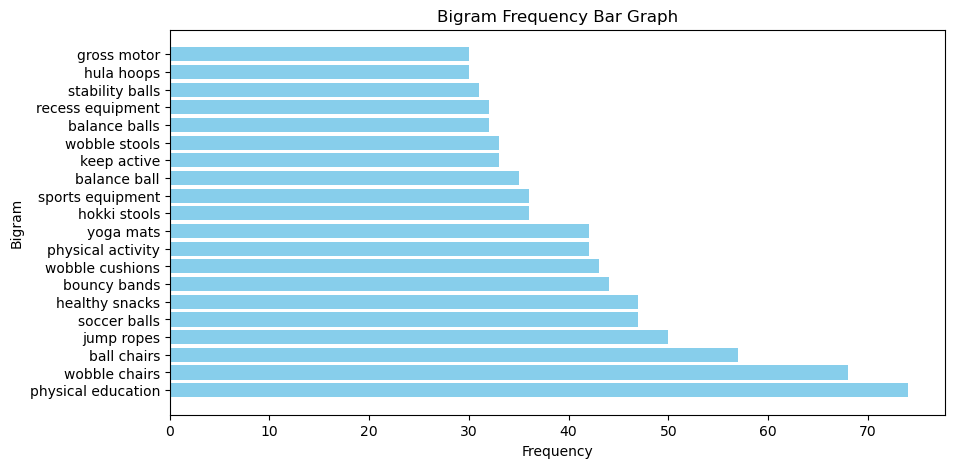

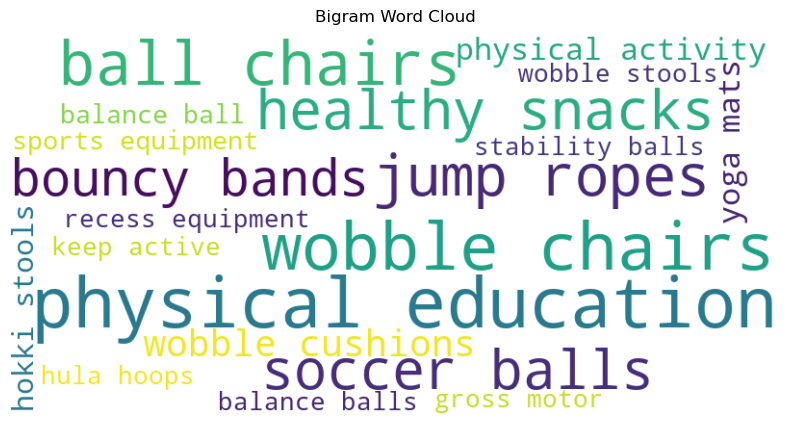

printing top 20 trigrams.....................
{('shine', 'guards', 'athletic'): 1, ('guards', 'athletic', 'socks'): 1, ('athletic', 'socks', 'soccer'): 1, ('socks', 'soccer', 'balls'): 1, ('soccer', 'balls', 'goalie'): 1, ('balls', 'goalie', 'gloves'): 1, ('goalie', 'gloves', 'training'): 1, ('gloves', 'training', 'materials'): 1, ('training', 'materials', 'upcoming'): 1, ('materials', 'upcoming', 'soccer'): 1, ('upcoming', 'soccer', 'season'): 1, ('variety', 'balls', 'balance'): 1, ('balls', 'balance', 'aids'): 1, ('balance', 'aids', 'products'): 1, ('aids', 'products', 'provide'): 1, ('products', 'provide', 'well'): 1, ('provide', 'well', 'rounded'): 1, ('well', 'rounded', 'physical'): 1, ('rounded', 'physical', 'education'): 1, ('physical', 'education', 'experience'): 1}
#######################################################################################################
Approved cleaned_summary  history


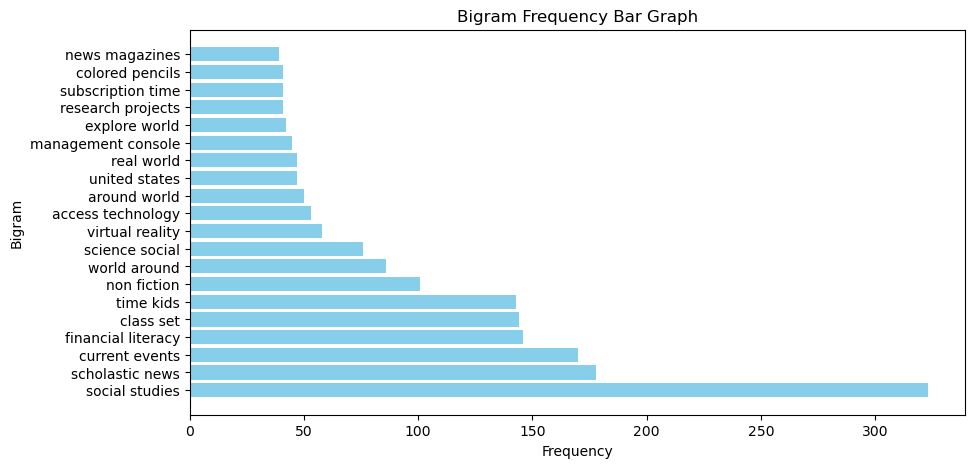

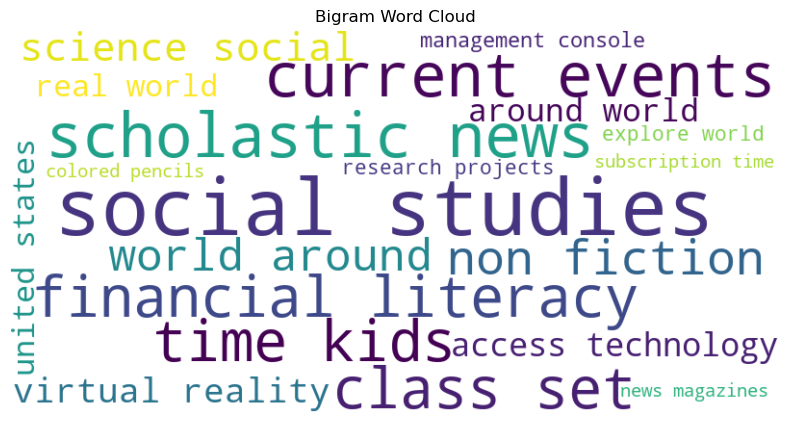

printing top 20 trigrams.....................
{('projector', 'viewing', 'educational'): 1, ('viewing', 'educational', 'programs'): 1, ('work', 'station', 'move'): 1, ('station', 'move', 'sit'): 1, ('move', 'sit', 'stand'): 1, ('sit', 'stand', 'desks'): 1, ('stand', 'desks', 'easily'): 1, ('desks', 'easily', 'adjust'): 1, ('easily', 'adjust', 'feel'): 1, ('adjust', 'feel', 'stand'): 1, ('feel', 'stand', 'sit'): 1, ('stand', 'sit', 'lesson'): 1, ('sit', 'lesson', 'desk'): 1, ('lesson', 'desk', 'group'): 1, ('desk', 'group', 'work'): 1, ('fiction', 'non', 'fiction'): 1, ('non', 'fiction', 'provide'): 1, ('fiction', 'provide', 'insight'): 1, ('provide', 'insight', 'encourage'): 1, ('insight', 'encourage', 'conversation'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  history


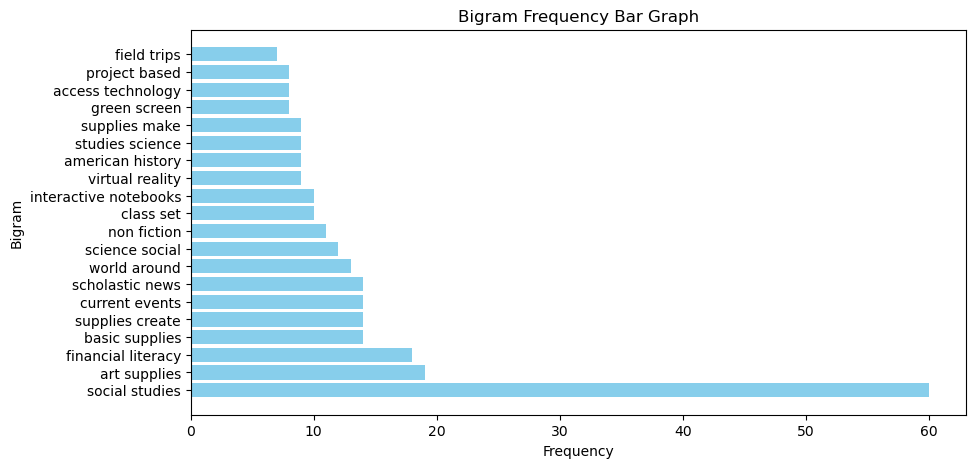

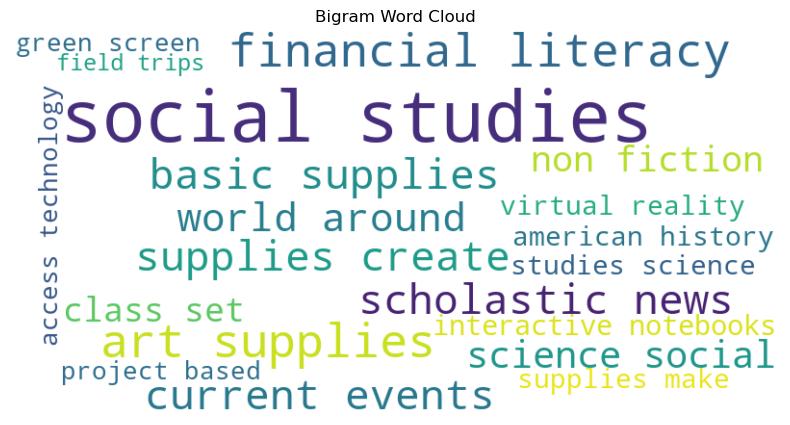

printing top 20 trigrams.....................
{('national', 'parks', 'planets'): 1, ('parks', 'planets', 'supplement'): 1, ('planets', 'supplement', 'class'): 1, ('literature', 'interactive', 'games'): 1, ('interactive', 'games', 'reinforce'): 1, ('games', 'reinforce', 'social'): 1, ('reinforce', 'social', 'studies'): 1, ('social', 'studies', 'concepts'): 1, ('ipad', 'teach', 'age'): 1, ('teach', 'age', 'programs'): 1, ('age', 'programs', 'pages'): 1, ('programs', 'pages', 'numbers'): 1, ('pages', 'numbers', 'keynotes'): 1, ('shirts', 'markers', 'create'): 1, ('markers', 'create', 'shirts'): 1, ('create', 'shirts', 'local'): 1, ('shirts', 'local', 'landmarks'): 1, ('local', 'landmarks', 'artwork'): 1, ('landmarks', 'artwork', 'studying'): 1, ('artwork', 'studying', 'city'): 1}
#######################################################################################################
Approved cleaned_summary  hunger


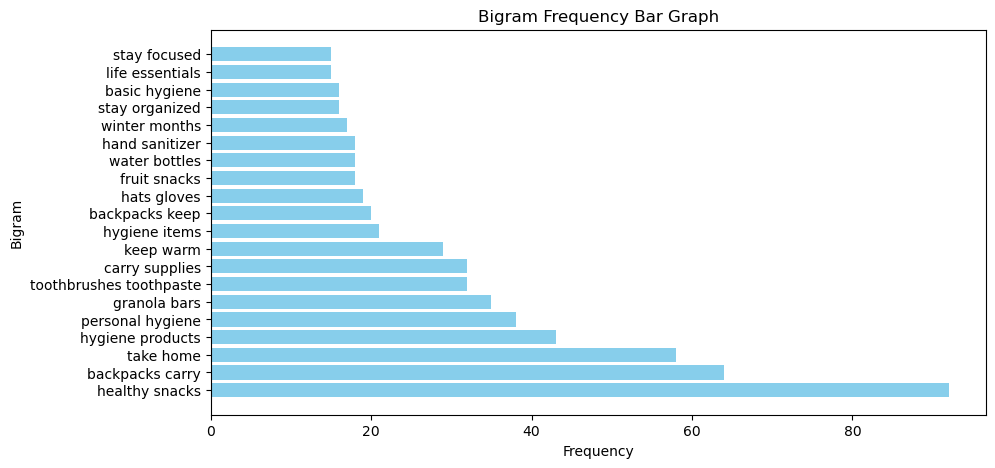

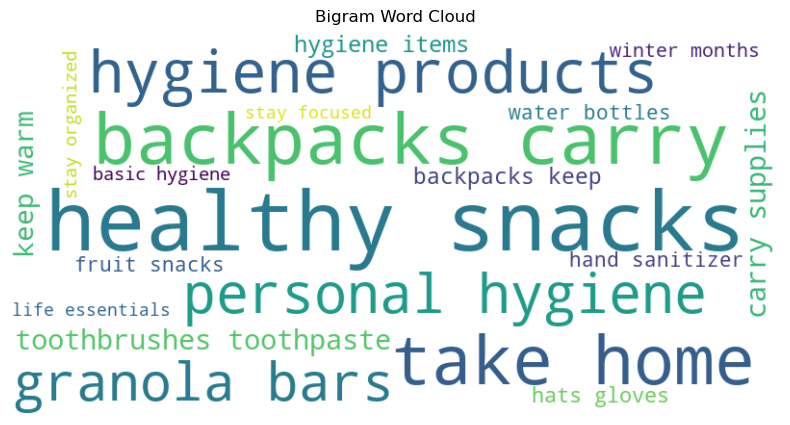

printing top 20 trigrams.....................
{('sanitary', 'napkins', 'wipes'): 1, ('napkins', 'wipes', 'lotion'): 1, ('wipes', 'lotion', 'soap'): 1, ('lotion', 'soap', 'keep'): 1, ('soap', 'keep', 'clean'): 1, ('following', 'life', 'essentials'): 1, ('life', 'essentials', 'tshirts'): 1, ('essentials', 'tshirts', 'hoodies'): 1, ('tshirts', 'hoodies', 'umbrellas'): 1, ('hoodies', 'umbrellas', 'rain'): 1, ('umbrellas', 'rain', 'boots'): 1, ('rain', 'boots', 'improve'): 1, ('boots', 'improve', 'quality'): 1, ('improve', 'quality', 'life'): 1, ('safe', 'environment', 'feel'): 1, ('environment', 'feel', 'cared'): 1, ('feel', 'cared', 'secure'): 1, ('cared', 'secure', 'loved'): 1, ('secure', 'loved', 'appropriate'): 1, ('loved', 'appropriate', 'furnishings'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  hunger


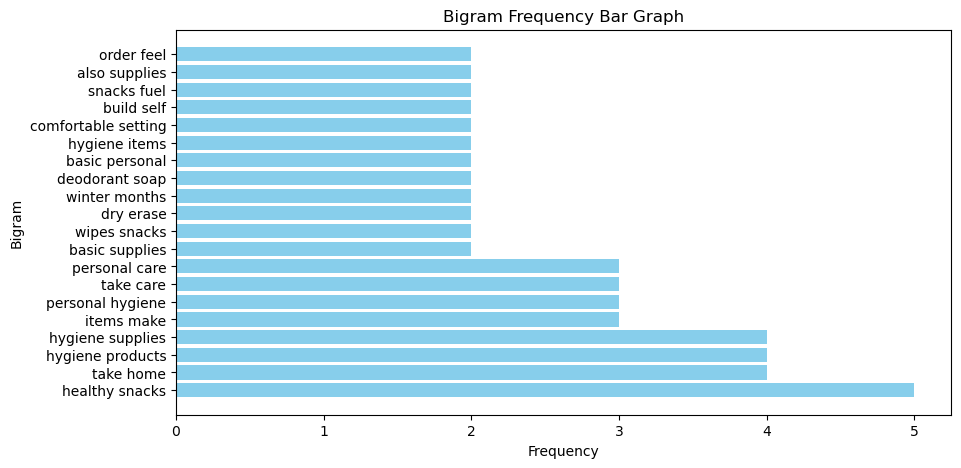

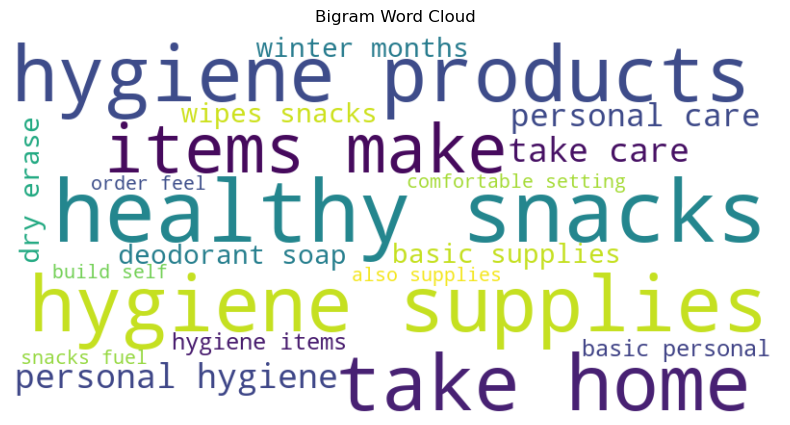

printing top 20 trigrams.....................
{('supplies', 'art', 'calligraphy'): 1, ('essentials', 'houselessness', 'including'): 1, ('houselessness', 'including', 'travel'): 1, ('including', 'travel', 'bag'): 1, ('travel', 'bag', 'essentials'): 1, ('bag', 'essentials', 'printed'): 1, ('essentials', 'printed', 'information'): 1, ('printed', 'information', 'community'): 1, ('information', 'community', 'resources'): 1, ('community', 'resources', 'accessing'): 1, ('resources', 'accessing', 'additional'): 1, ('accessing', 'additional', 'basic'): 1, ('additional', 'basic', 'supplies'): 1, ('dry', 'goods', 'make'): 1, ('goods', 'make', 'laundry'): 1, ('make', 'laundry', 'soap'): 1, ('options', 'accommodate', 'feel'): 1, ('accommodate', 'feel', 'safe'): 1, ('feel', 'safe', 'comfortable'): 1, ('safe', 'comfortable', 'provide'): 1}
#######################################################################################################
Approved cleaned_summary  language


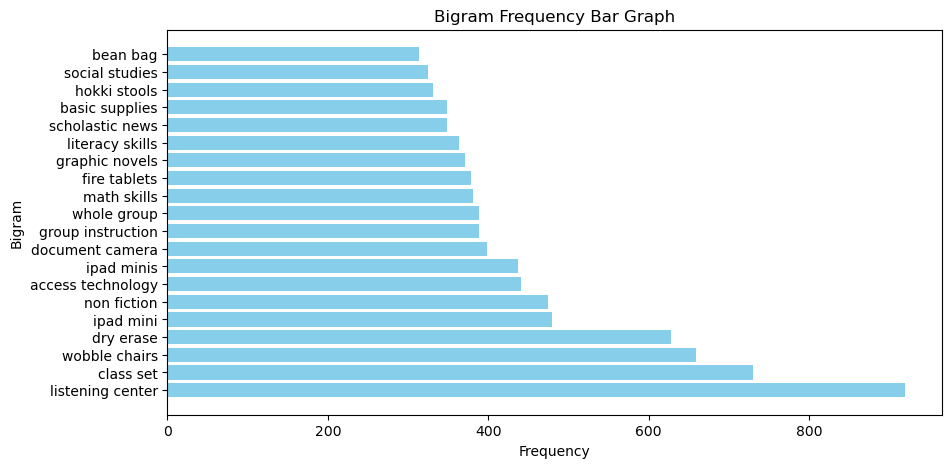

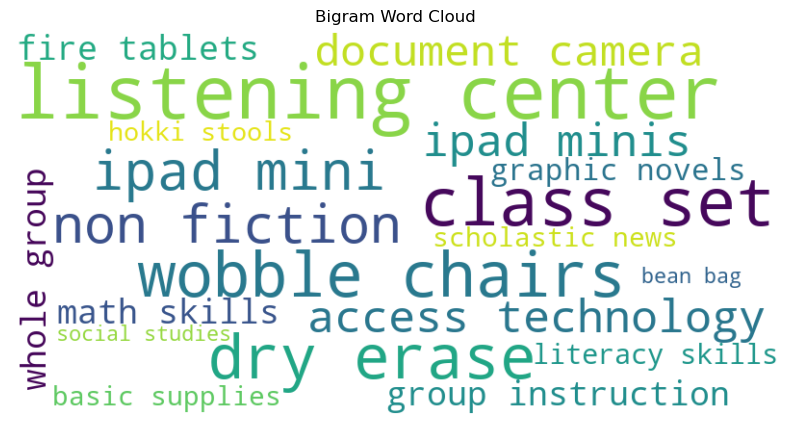

printing top 20 trigrams.....................
{('engage', 'math', 'way'): 1, ('math', 'way', 'inspire'): 1, ('way', 'inspire', 'mini'): 1, ('inspire', 'mini', 'ipads'): 1, ('movement', 'successful', 'variety'): 1, ('successful', 'variety', 'different'): 1, ('variety', 'different', 'types'): 1, ('different', 'types', 'assist'): 1, ('dependable', 'laptops', 'math'): 1, ('great', 'independent', 'alouds'): 1, ('independent', 'alouds', 'partner'): 1, ('alouds', 'partner', 'author'): 1, ('partner', 'author', 'studies'): 1, ('favorite', 'authors', 'like'): 1, ('authors', 'like', 'chris'): 1, ('like', 'chris', 'grabenstein'): 1, ('chris', 'grabenstein', 'raina'): 1, ('grabenstein', 'raina', 'telgemeier'): 1, ('raina', 'telgemeier', 'james'): 1, ('telgemeier', 'james', 'patterson'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  language


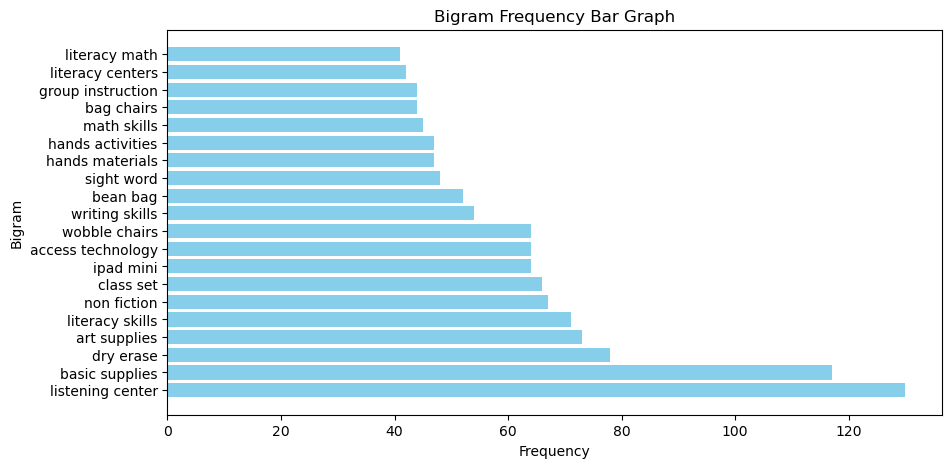

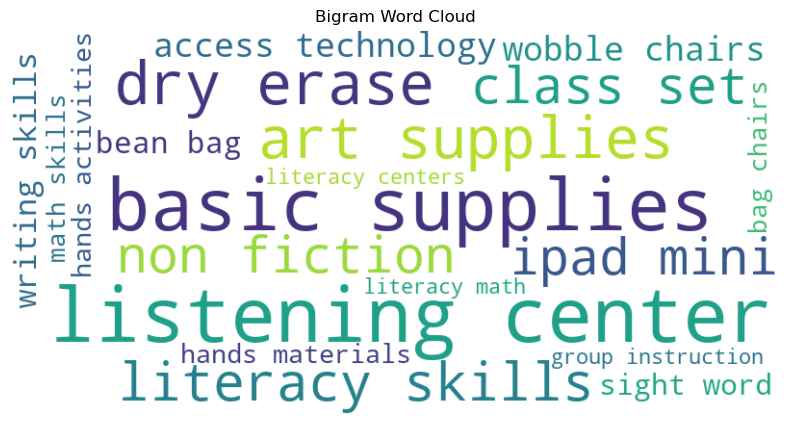

printing top 20 trigrams.....................
{('opportunities', 'practice', 'beginning'): 1, ('practice', 'beginning', 'skills'): 1, ('beginning', 'skills', 'home'): 1, ('tablets', 'technology', 'center'): 1, ('technology', 'center', 'please'): 1, ('become', 'engaged', 'motivated'): 1, ('engaged', 'motivated', 'self'): 1, ('motivated', 'self', 'directed'): 1, ('self', 'directed', 'readers'): 1, ('increase', 'literacy', 'skills'): 1, ('literacy', 'skills', 'hands'): 1, ('skills', 'hands', 'engaging'): 1, ('hands', 'engaging', 'way'): 1, ('appropriate', 'age', 'levels'): 1, ('age', 'levels', 'range'): 1, ('levels', 'range', 'years'): 1, ('range', 'years', 'old'): 1, ('years', 'old', 'young'): 1, ('old', 'young', 'ages'): 1, ('young', 'ages', 'developing'): 1}
#######################################################################################################
Approved cleaned_summary  literacy


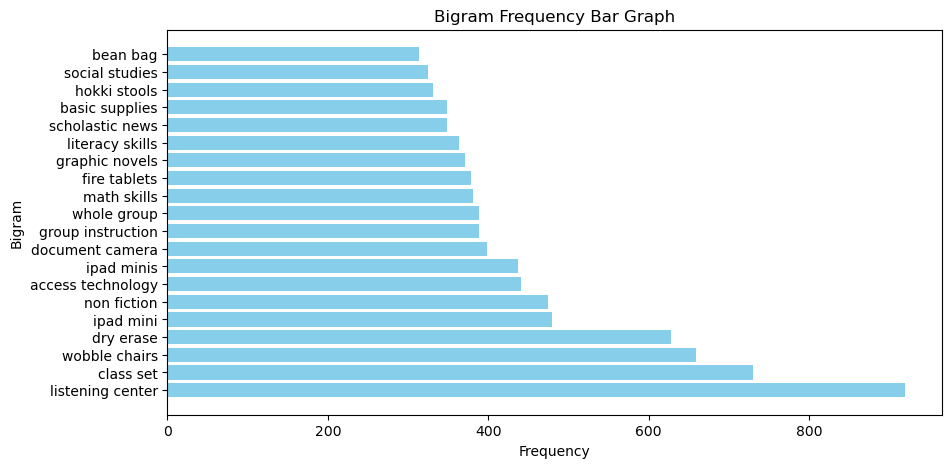

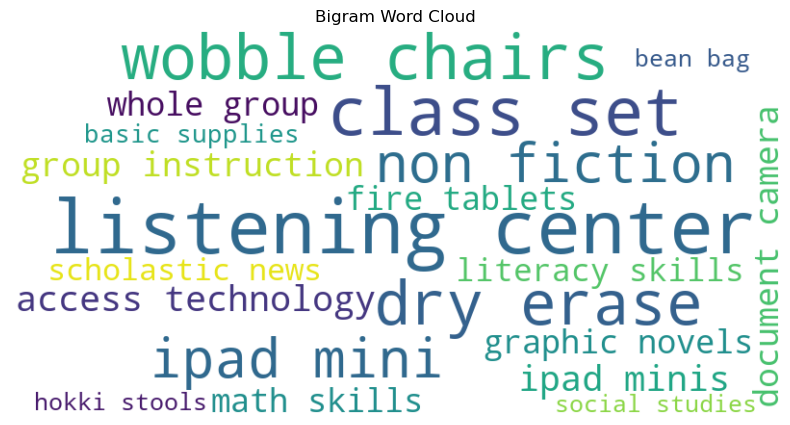

printing top 20 trigrams.....................
{('engage', 'math', 'way'): 1, ('math', 'way', 'inspire'): 1, ('way', 'inspire', 'mini'): 1, ('inspire', 'mini', 'ipads'): 1, ('movement', 'successful', 'variety'): 1, ('successful', 'variety', 'different'): 1, ('variety', 'different', 'types'): 1, ('different', 'types', 'assist'): 1, ('dependable', 'laptops', 'math'): 1, ('great', 'independent', 'alouds'): 1, ('independent', 'alouds', 'partner'): 1, ('alouds', 'partner', 'author'): 1, ('partner', 'author', 'studies'): 1, ('favorite', 'authors', 'like'): 1, ('authors', 'like', 'chris'): 1, ('like', 'chris', 'grabenstein'): 1, ('chris', 'grabenstein', 'raina'): 1, ('grabenstein', 'raina', 'telgemeier'): 1, ('raina', 'telgemeier', 'james'): 1, ('telgemeier', 'james', 'patterson'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  literacy


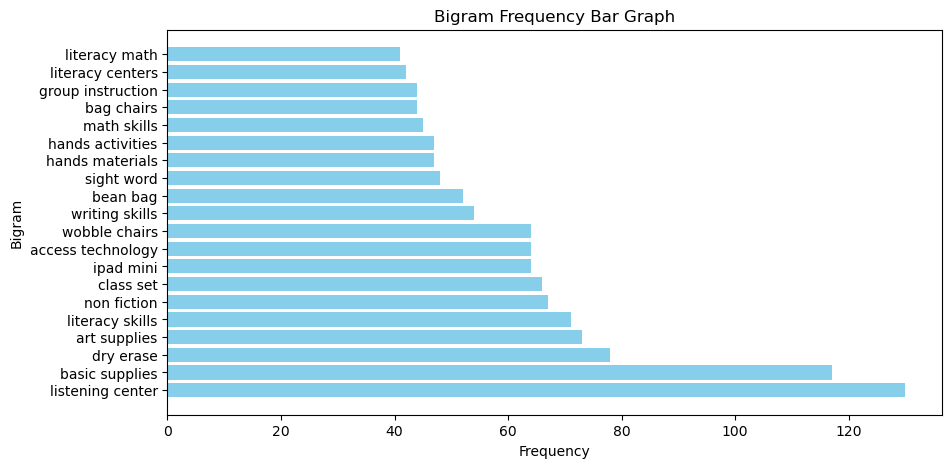

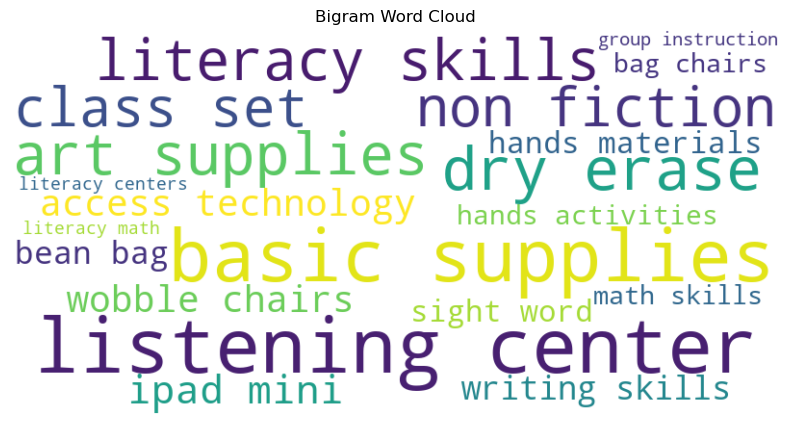

printing top 20 trigrams.....................
{('opportunities', 'practice', 'beginning'): 1, ('practice', 'beginning', 'skills'): 1, ('beginning', 'skills', 'home'): 1, ('tablets', 'technology', 'center'): 1, ('technology', 'center', 'please'): 1, ('become', 'engaged', 'motivated'): 1, ('engaged', 'motivated', 'self'): 1, ('motivated', 'self', 'directed'): 1, ('self', 'directed', 'readers'): 1, ('increase', 'literacy', 'skills'): 1, ('literacy', 'skills', 'hands'): 1, ('skills', 'hands', 'engaging'): 1, ('hands', 'engaging', 'way'): 1, ('appropriate', 'age', 'levels'): 1, ('age', 'levels', 'range'): 1, ('levels', 'range', 'years'): 1, ('range', 'years', 'old'): 1, ('years', 'old', 'young'): 1, ('old', 'young', 'ages'): 1, ('young', 'ages', 'developing'): 1}
#######################################################################################################
Approved cleaned_summary  math


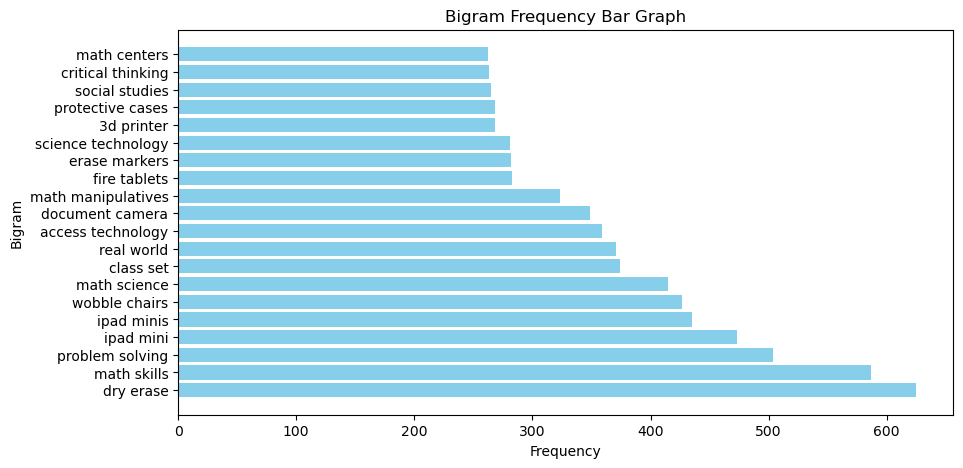

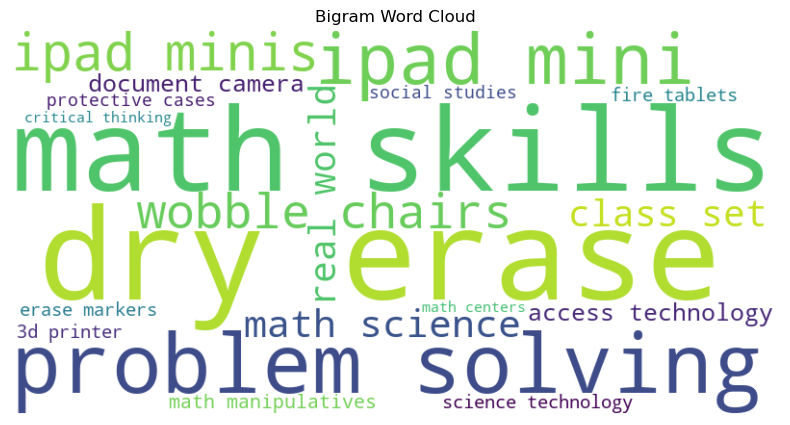

printing top 20 trigrams.....................
{('engage', 'math', 'way'): 1, ('math', 'way', 'inspire'): 1, ('way', 'inspire', 'mini'): 1, ('inspire', 'mini', 'ipads'): 1, ('hands', 'practice', 'mathematics'): 1, ('practice', 'mathematics', 'fun'): 1, ('mathematics', 'fun', 'personalized'): 1, ('fun', 'personalized', 'journals'): 1, ('personalized', 'journals', 'charts'): 1, ('journals', 'charts', 'involved'): 1, ('charts', 'involved', 'math'): 1, ('involved', 'math', 'routines'): 1, ('ipads', 'access', 'world'): 1, ('access', 'world', 'online'): 1, ('world', 'online', 'resources'): 1, ('online', 'resources', 'spark'): 1, ('resources', 'spark', 'interest'): 1, ('chromebooks', 'publish', 'written'): 1, ('publish', 'written', 'work'): 1, ('written', 'work', 'continue'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  math


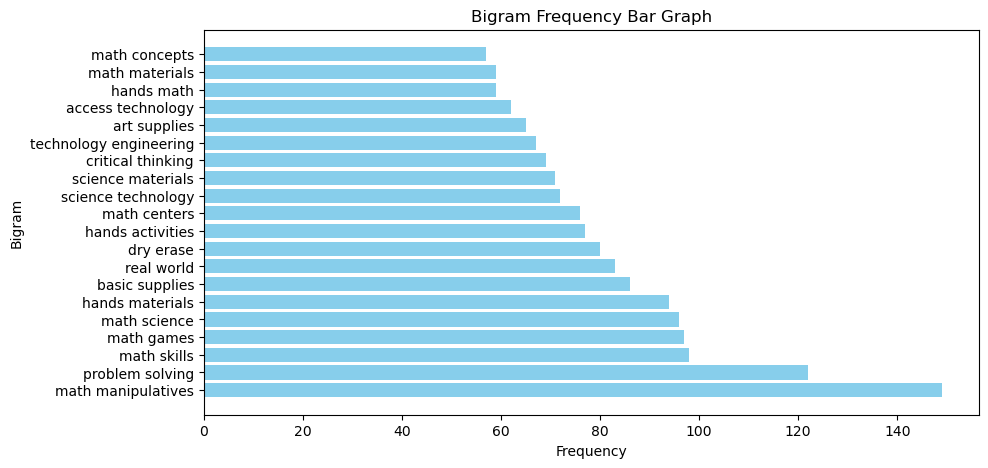

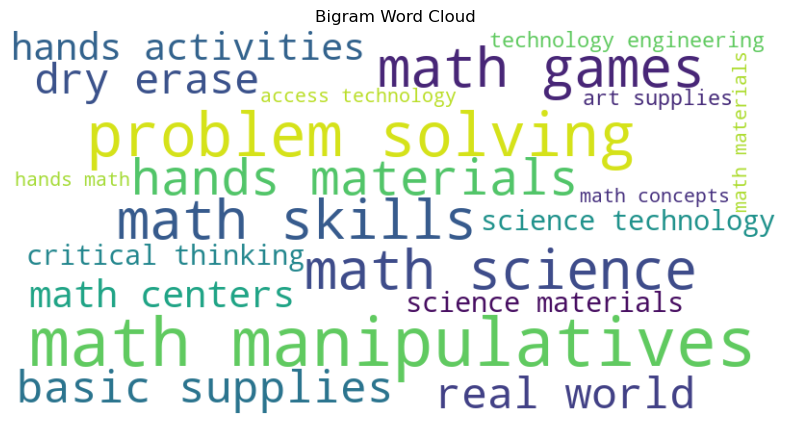

printing top 20 trigrams.....................
{('3d', '4d', 'life'): 1, ('4d', 'life', 'science'): 1, ('life', 'science', 'activity'): 1, ('science', 'activity', 'kits'): 1, ('activity', 'kits', 'full'): 1, ('kits', 'full', 'effect'): 1, ('full', 'effect', 'lessons'): 1, ('effect', 'lessons', 'work'): 1, ('lessons', 'work', 'groups'): 1, ('work', 'groups', 'store'): 1, ('groups', 'store', 'models'): 1, ('store', 'models', 'sturdy'): 1, ('models', 'sturdy', 'bins'): 1, ('centers', 'multiplication', 'kit'): 1, ('multiplication', 'kit', 'become'): 1, ('kit', 'become', 'masters'): 1, ('become', 'masters', '3rd'): 1, ('masters', '3rd', 'math'): 1, ('four', 'hp', 'chromebooks'): 1, ('hp', 'chromebooks', 'ipod'): 1}
#######################################################################################################
Approved cleaned_summary  music


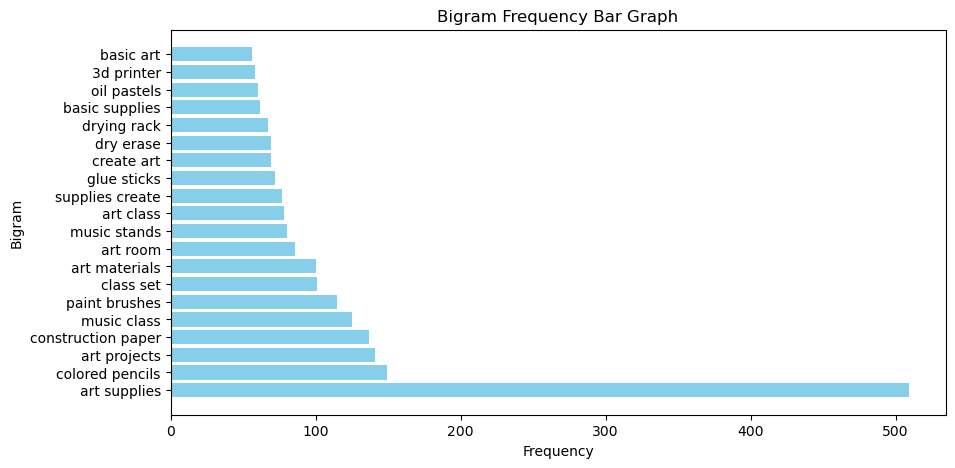

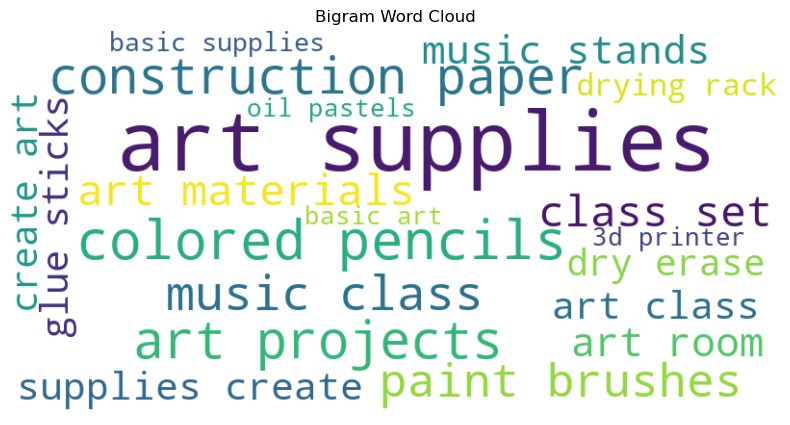

printing top 20 trigrams.....................
{('instruments', 'give', 'tools'): 1, ('give', 'tools', 'grow'): 1, ('tools', 'grow', 'musically'): 1, ('two', 'chromebooks', 'chromecast'): 1, ('chromebooks', 'chromecast', 'colored'): 1, ('chromecast', 'colored', 'printer'): 1, ('colored', 'printer', 'ink'): 1, ('ink', 'continue', 'make'): 1, ('continue', 'make', 'fine'): 1, ('make', 'fine', 'art'): 1, ('fine', 'art', 'glicee'): 1, ('art', 'glicee', 'prints'): 1, ('glicee', 'prints', 'photographic'): 1, ('prints', 'photographic', 'images'): 1, ('artist', 'resource', 'art'): 1, ('resource', 'art', 'history'): 1, ('art', 'history', 'posters'): 1, ('history', 'posters', 'create'): 1, ('posters', 'create', 'solid'): 1, ('create', 'solid', 'understanding'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  music


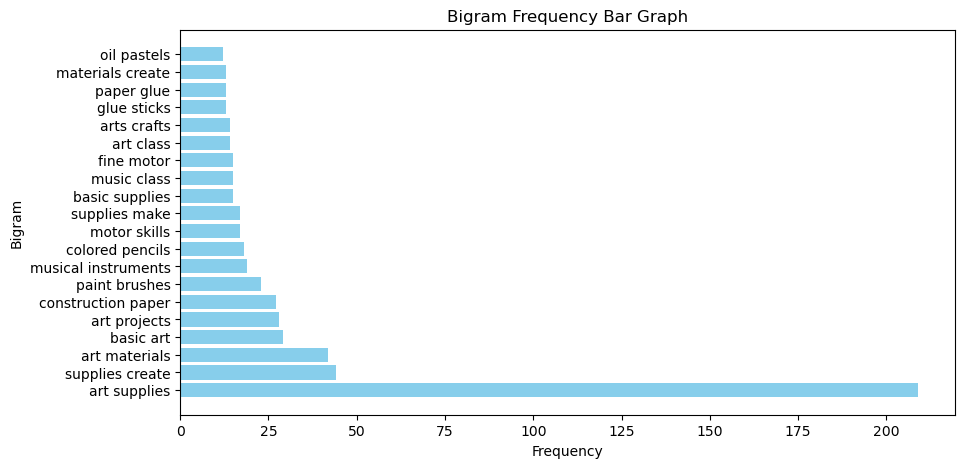

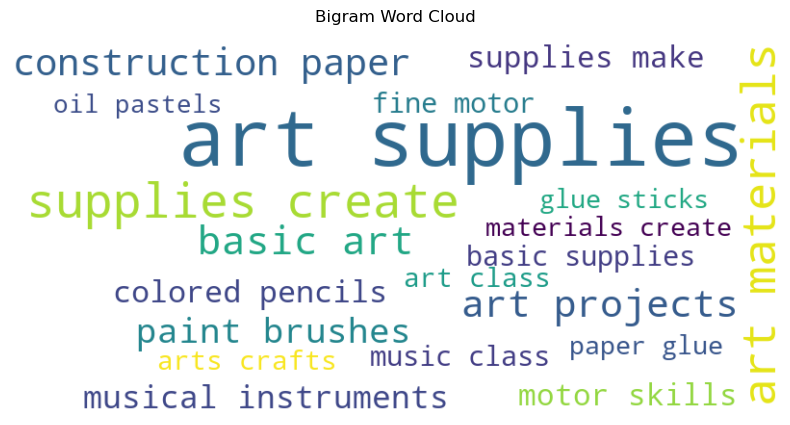

printing top 20 trigrams.....................
{('orff', 'instruments', 'guitars'): 1, ('instruments', 'guitars', 'ukuleles'): 1, ('guitars', 'ukuleles', 'brand'): 1, ('ukuleles', 'brand', 'music'): 1, ('brand', 'music', 'program'): 1, ('safety', 'basic', 'equipment'): 1, ('basic', 'equipment', 'start'): 1, ('equipment', 'start', 'ceramics'): 1, ('start', 'ceramics', 'program'): 1, ('guitar', 'picks', 'guitar'): 1, ('picks', 'guitar', 'tuners'): 1, ('guitar', 'tuners', 'brand'): 1, ('tuners', 'brand', 'guitar'): 1, ('brand', 'guitar', 'course'): 1, ('guitar', 'course', 'often'): 1, ('course', 'often', 'afford'): 1, ('often', 'afford', 'thank'): 1, ('afford', 'thank', 'generous'): 1, ('thank', 'generous', 'support'): 1, ('essentials', 'like', 'glue'): 1}
#######################################################################################################
Approved cleaned_summary  science


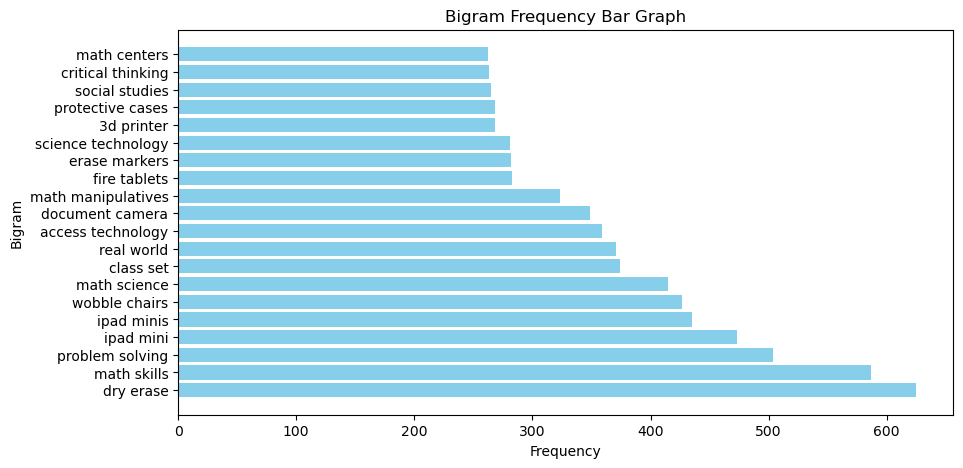

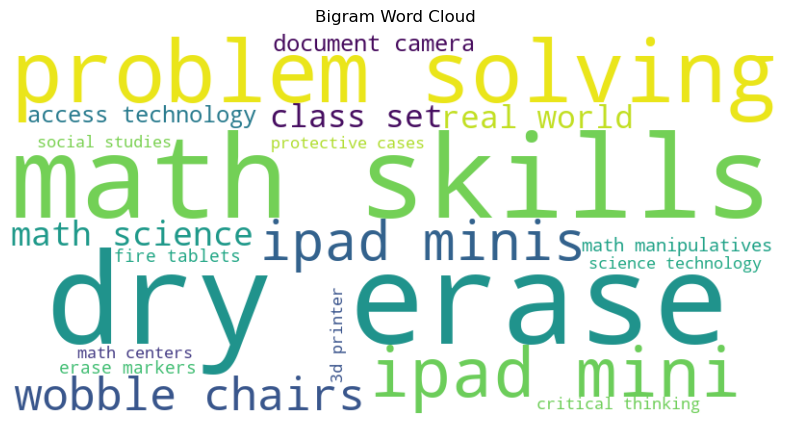

printing top 20 trigrams.....................
{('engage', 'math', 'way'): 1, ('math', 'way', 'inspire'): 1, ('way', 'inspire', 'mini'): 1, ('inspire', 'mini', 'ipads'): 1, ('hands', 'practice', 'mathematics'): 1, ('practice', 'mathematics', 'fun'): 1, ('mathematics', 'fun', 'personalized'): 1, ('fun', 'personalized', 'journals'): 1, ('personalized', 'journals', 'charts'): 1, ('journals', 'charts', 'involved'): 1, ('charts', 'involved', 'math'): 1, ('involved', 'math', 'routines'): 1, ('ipads', 'access', 'world'): 1, ('access', 'world', 'online'): 1, ('world', 'online', 'resources'): 1, ('online', 'resources', 'spark'): 1, ('resources', 'spark', 'interest'): 1, ('chromebooks', 'publish', 'written'): 1, ('publish', 'written', 'work'): 1, ('written', 'work', 'continue'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  science


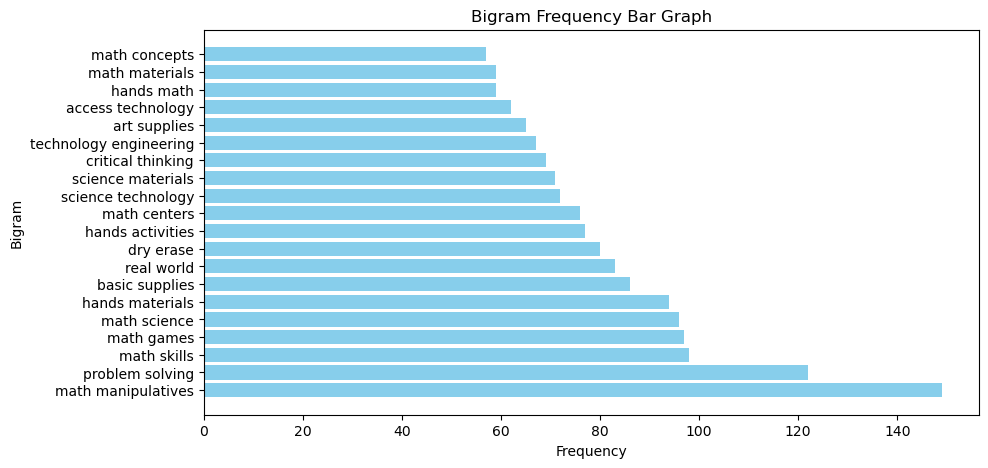

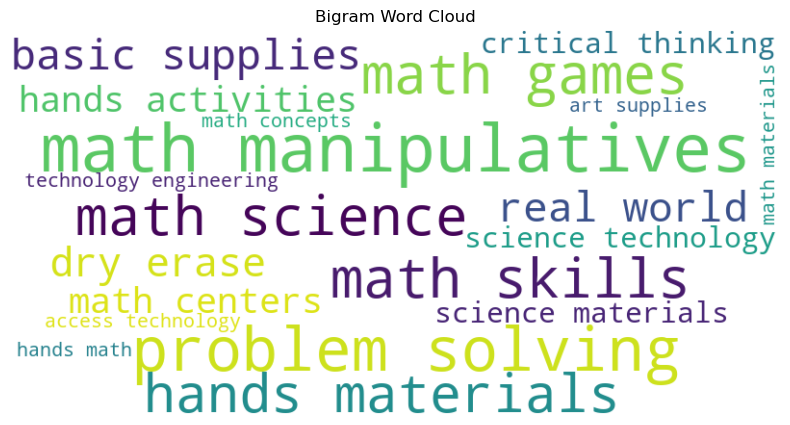

printing top 20 trigrams.....................
{('3d', '4d', 'life'): 1, ('4d', 'life', 'science'): 1, ('life', 'science', 'activity'): 1, ('science', 'activity', 'kits'): 1, ('activity', 'kits', 'full'): 1, ('kits', 'full', 'effect'): 1, ('full', 'effect', 'lessons'): 1, ('effect', 'lessons', 'work'): 1, ('lessons', 'work', 'groups'): 1, ('work', 'groups', 'store'): 1, ('groups', 'store', 'models'): 1, ('store', 'models', 'sturdy'): 1, ('models', 'sturdy', 'bins'): 1, ('centers', 'multiplication', 'kit'): 1, ('multiplication', 'kit', 'become'): 1, ('kit', 'become', 'masters'): 1, ('become', 'masters', '3rd'): 1, ('masters', '3rd', 'math'): 1, ('four', 'hp', 'chromebooks'): 1, ('hp', 'chromebooks', 'ipod'): 1}
#######################################################################################################
Approved cleaned_summary  specialneeds


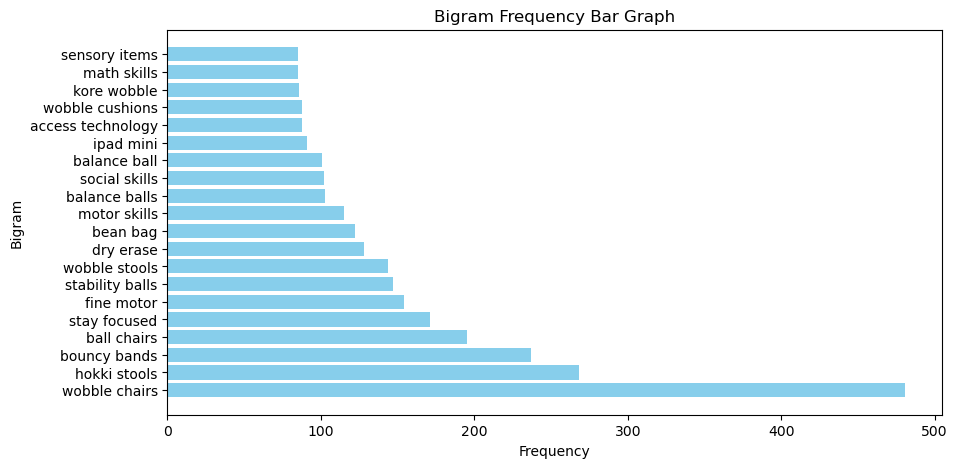

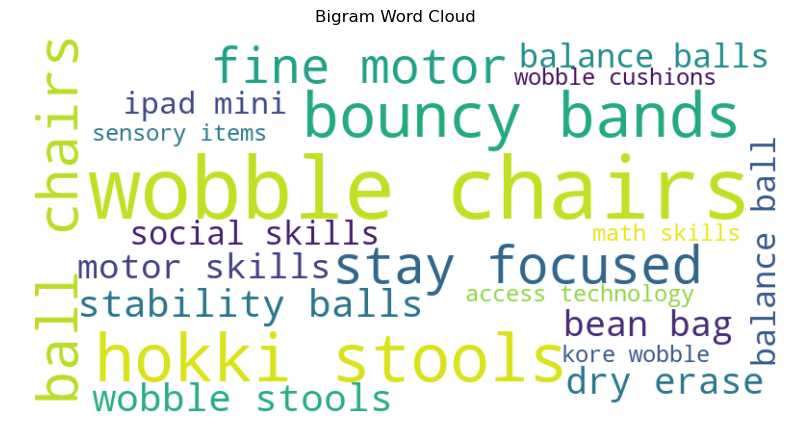

printing top 20 trigrams.....................
{('movement', 'successful', 'variety'): 1, ('successful', 'variety', 'different'): 1, ('variety', 'different', 'types'): 1, ('different', 'types', 'assist'): 1, ('dependable', 'laptops', 'math'): 1, ('access', 'technology', 'allow'): 1, ('technology', 'allow', 'communicate'): 1, ('allow', 'communicate', 'others'): 1, ('leappad', 'engage', 'critical'): 1, ('engage', 'critical', 'thinking'): 1, ('critical', 'thinking', 'skills'): 1, ('thinking', 'skills', 'vocabulary'): 1, ('skills', 'vocabulary', 'communication'): 1, ('vocabulary', 'communication', 'skills'): 1, ('communication', 'skills', 'successful'): 1, ('desks', 'stand', 'able'): 1, ('stand', 'able', 'fidget'): 1, ('able', 'fidget', 'without'): 1, ('fidget', 'without', 'becoming'): 1, ('without', 'becoming', 'distraction'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  specialneeds


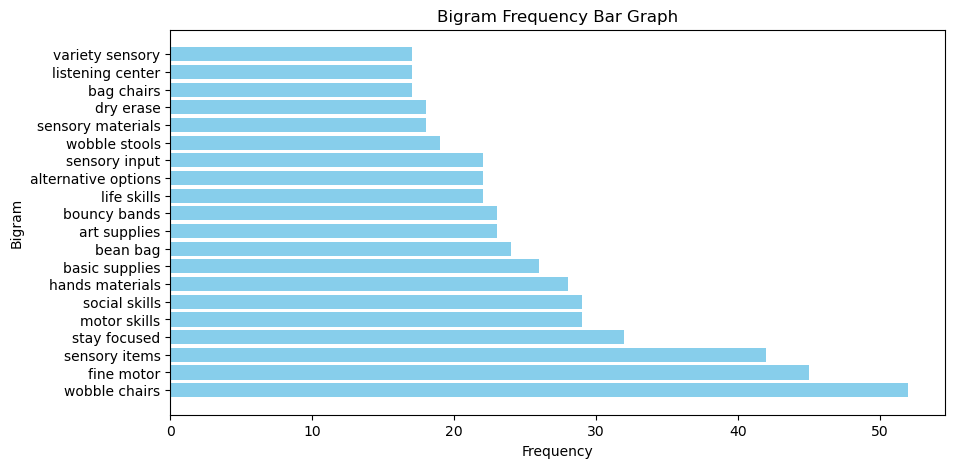

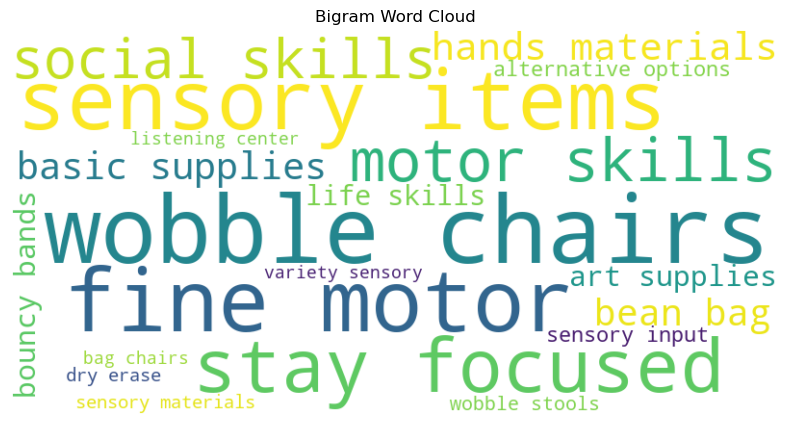

printing top 20 trigrams.....................
{('increase', 'literacy', 'skills'): 1, ('literacy', 'skills', 'hands'): 1, ('skills', 'hands', 'engaging'): 1, ('hands', 'engaging', 'way'): 1, ('coffee', 'pot', 'coffee'): 1, ('pot', 'coffee', 'cups'): 1, ('coffee', 'cups', 'sleeves'): 1, ('cups', 'sleeves', 'creamer'): 1, ('sleeves', 'creamer', 'make'): 1, ('creamer', 'make', 'project'): 1, ('make', 'project', 'possible'): 1, ('supplies', 'keep', 'computer'): 1, ('keep', 'computer', 'lab'): 1, ('computer', 'lab', 'clean'): 1, ('lab', 'clean', 'dust'): 1, ('clean', 'dust', 'dirt'): 1, ('dust', 'dirt', 'due'): 1, ('dirt', 'due', 'expensive'): 1, ('due', 'expensive', 'technology'): 1, ('expensive', 'technology', 'gate'): 1}
#######################################################################################################
Approved cleaned_summary  sports


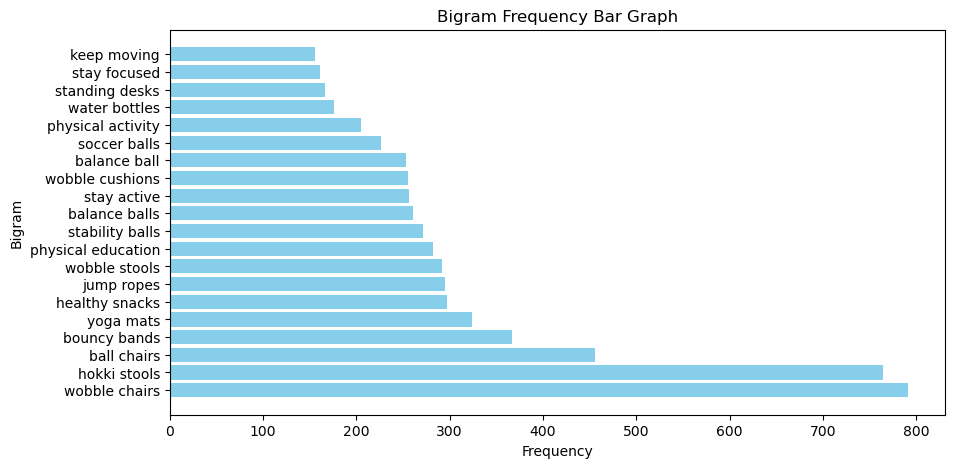

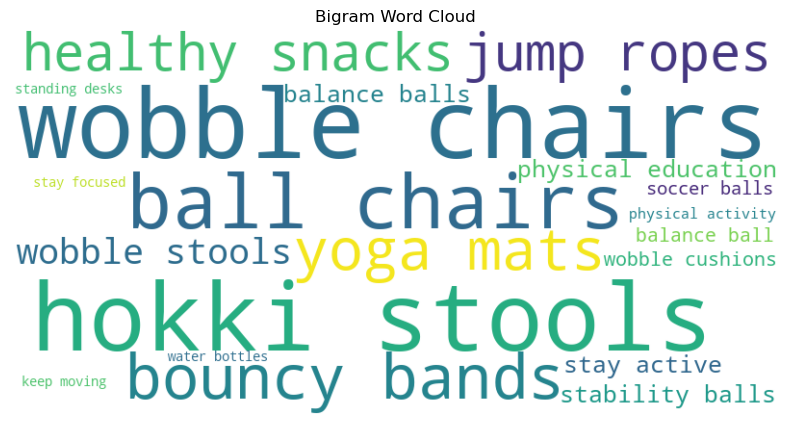

printing top 20 trigrams.....................
{('projector', 'viewing', 'educational'): 1, ('viewing', 'educational', 'programs'): 1, ('three', 'devices', 'three'): 1, ('devices', 'three', 'management'): 1, ('three', 'management', 'licenses'): 1, ('management', 'licenses', 'group'): 1, ('licenses', 'group', 'easy'): 1, ('group', 'easy', 'access'): 1, ('easy', 'access', 'newly'): 1, ('access', 'newly', 'implemented'): 1, ('newly', 'implemented', 'online'): 1, ('implemented', 'online', 'programs'): 1, ('online', 'programs', 'go'): 1, ('programs', 'go', 'noodle'): 1, ('go', 'noodle', 'plus'): 1, ('noodle', 'plus', 'increased'): 1, ('plus', 'increased', 'class'): 1, ('increased', 'class', 'physical'): 1, ('class', 'physical', 'activity'): 1, ('physical', 'activity', 'light'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  sports


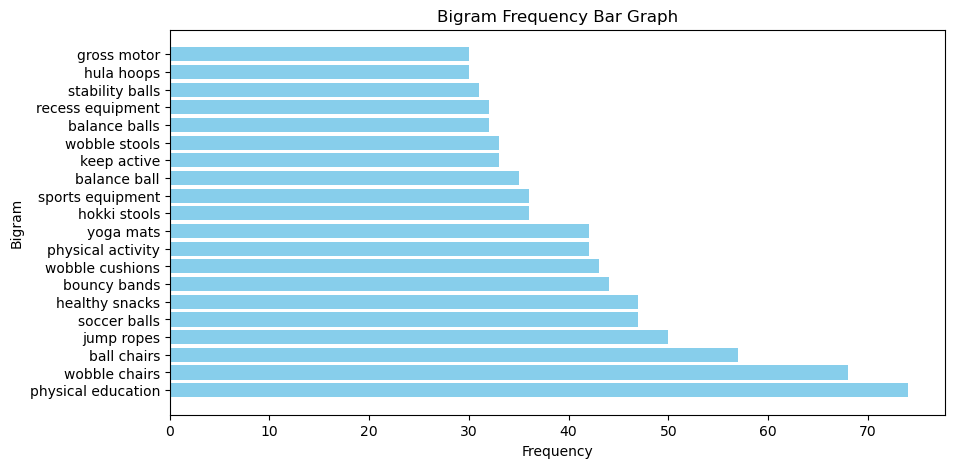

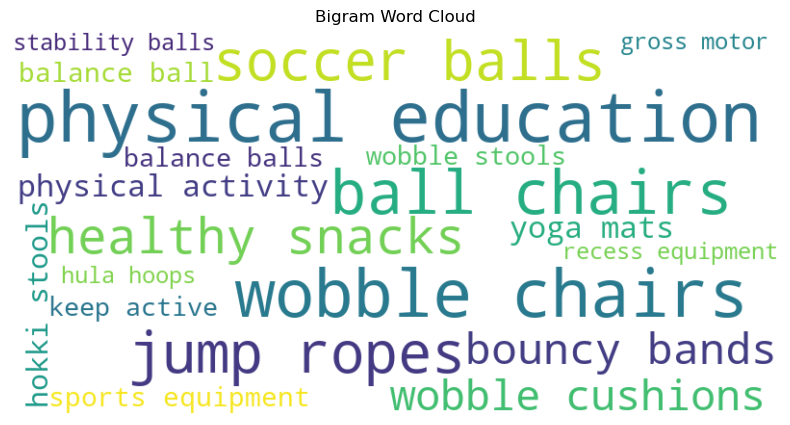

printing top 20 trigrams.....................
{('shine', 'guards', 'athletic'): 1, ('guards', 'athletic', 'socks'): 1, ('athletic', 'socks', 'soccer'): 1, ('socks', 'soccer', 'balls'): 1, ('soccer', 'balls', 'goalie'): 1, ('balls', 'goalie', 'gloves'): 1, ('goalie', 'gloves', 'training'): 1, ('gloves', 'training', 'materials'): 1, ('training', 'materials', 'upcoming'): 1, ('materials', 'upcoming', 'soccer'): 1, ('upcoming', 'soccer', 'season'): 1, ('variety', 'balls', 'balance'): 1, ('balls', 'balance', 'aids'): 1, ('balance', 'aids', 'products'): 1, ('aids', 'products', 'provide'): 1, ('products', 'provide', 'well'): 1, ('provide', 'well', 'rounded'): 1, ('well', 'rounded', 'physical'): 1, ('rounded', 'physical', 'education'): 1, ('physical', 'education', 'experience'): 1}
#######################################################################################################
Approved cleaned_summary  warmth


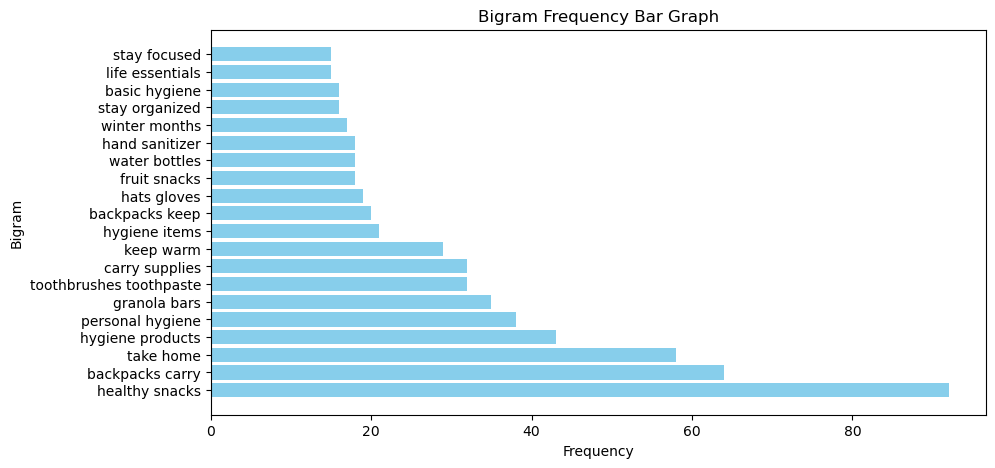

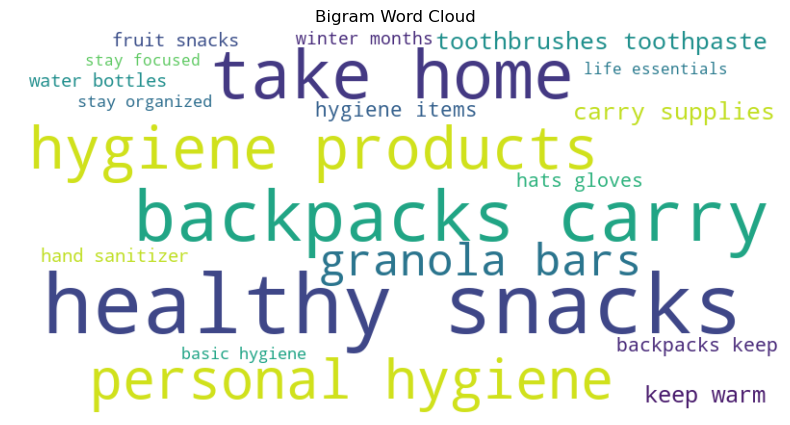

printing top 20 trigrams.....................
{('sanitary', 'napkins', 'wipes'): 1, ('napkins', 'wipes', 'lotion'): 1, ('wipes', 'lotion', 'soap'): 1, ('lotion', 'soap', 'keep'): 1, ('soap', 'keep', 'clean'): 1, ('following', 'life', 'essentials'): 1, ('life', 'essentials', 'tshirts'): 1, ('essentials', 'tshirts', 'hoodies'): 1, ('tshirts', 'hoodies', 'umbrellas'): 1, ('hoodies', 'umbrellas', 'rain'): 1, ('umbrellas', 'rain', 'boots'): 1, ('rain', 'boots', 'improve'): 1, ('boots', 'improve', 'quality'): 1, ('improve', 'quality', 'life'): 1, ('safe', 'environment', 'feel'): 1, ('environment', 'feel', 'cared'): 1, ('feel', 'cared', 'secure'): 1, ('cared', 'secure', 'loved'): 1, ('secure', 'loved', 'appropriate'): 1, ('loved', 'appropriate', 'furnishings'): 1}
------------------------------------------------------------------------------------------------------
Not Approved cleaned_summary  warmth


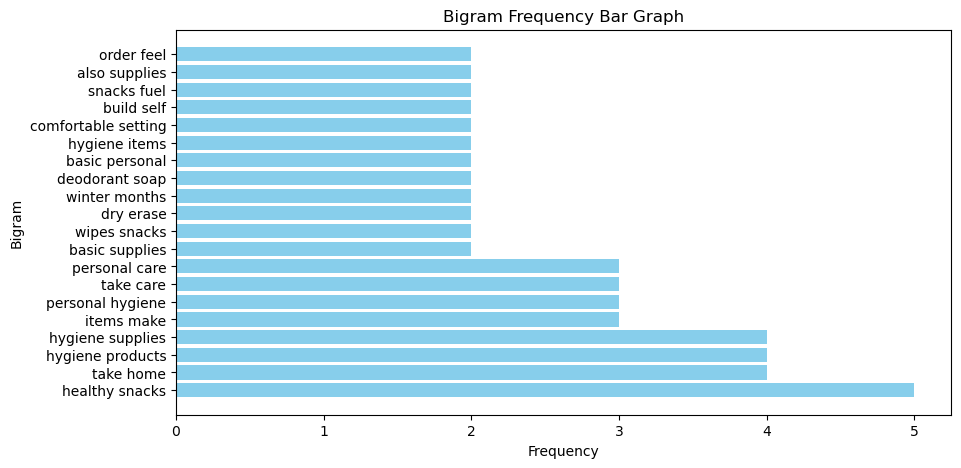

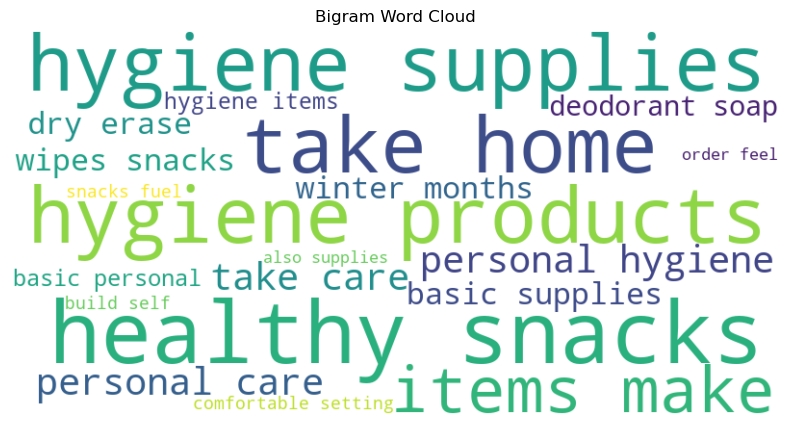

printing top 20 trigrams.....................
{('supplies', 'art', 'calligraphy'): 1, ('essentials', 'houselessness', 'including'): 1, ('houselessness', 'including', 'travel'): 1, ('including', 'travel', 'bag'): 1, ('travel', 'bag', 'essentials'): 1, ('bag', 'essentials', 'printed'): 1, ('essentials', 'printed', 'information'): 1, ('printed', 'information', 'community'): 1, ('information', 'community', 'resources'): 1, ('community', 'resources', 'accessing'): 1, ('resources', 'accessing', 'additional'): 1, ('accessing', 'additional', 'basic'): 1, ('additional', 'basic', 'supplies'): 1, ('dry', 'goods', 'make'): 1, ('goods', 'make', 'laundry'): 1, ('make', 'laundry', 'soap'): 1, ('options', 'accommodate', 'feel'): 1, ('accommodate', 'feel', 'safe'): 1, ('feel', 'safe', 'comfortable'): 1, ('safe', 'comfortable', 'provide'): 1}
#######################################################################################################


In [52]:
for i in bigrams_columns:
    #### Get bigrams and trigrams for Approved Projects
    for j in subjects:
        print(f"Approved {i}  {j}") 
        
        text_list = df_approved[df_approved["project_subject_categories"].str.contains(j)][i].to_list()
        clean_text(text_list)
        print("------------------------------------------------------------------------------------------------------")
        #### Get bigrams and trigrams for Approved Projects
        print(f"Not Approved {i}  {j}")
        text_list = df_not_approved[df_not_approved["project_subject_categories"].str.contains(j)][i].to_list()
        clean_text(text_list)
        print("#######################################################################################################")

first find length of the word_set

In [53]:
print(len(word_set))


59603


In [54]:
#word_set

In [55]:
df.columns

Index(['teacher_prefix', 'school_state', 'project_grade_category',
       'project_subject_categories', 'project_subject_subcategories',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'price', 'quantity', 'cleaned_titles', 'cleaned_essays',
       'cleaned_summary', 'isdigit_summary'],
      dtype='object')

In [56]:
# Assuming you have a DataFrame df containing the mentioned columns

# Create X by excluding 'project_is_approved'
X = df.drop(columns=['project_is_approved'])

# Create y as 'project_is_approved'
y = df['project_is_approved']

In [57]:
from sklearn.model_selection import train_test_split

# Step 1: Split the data into a training set and a test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [58]:
X_train

,teacher_prefix,school_state,project_grade_category,project_subject_categories,project_subject_subcategories,teacher_number_of_previously_posted_projects,price,quantity,cleaned_titles,cleaned_essays,cleaned_summary,isdigit_summary
52569,mr,ia,grades_9_12,appliedlearning history civics,extracurricular history geography,3,149.99,3,technology expansion,students wide ranging group young men women go...,students need chromebooks use classroom many t...,0
12687,ms,ca,grades_6_8,history civics literacy language,history geography literacy,0,126.66,1,time travelers need engaging books,traveling next 6th grade history classroom ask...,students need 10 high interest graphic novels ...,1
89507,mrs,va,grades_3_5,math science literacy language,environmentalscience literature writing,2,318.45,4,techies training,teach high poverty school produces amazing res...,students need 2 ipad minis cases enhance suppo...,1
90724,mrs,al,grades_3_5,literacy language math science,literacy mathematics,2,62.62,9,ilearn ipads,students title 1 school means free reduced lun...,students need cases ipads donated classroom no...,0
6276,teacher,fl,grades_6_8,math science specialneeds,appliedsciences specialneeds,2,282.99,2,littlebits engineers,8 middle school students diagnosed intellectua...,students need littlebits electonics kits help ...,0
...,...,...,...,...,...,...,...,...,...,...,...,...
54913,mrs,tx,grades_3_5,specialneeds,specialneeds,27,107.06,4,hokki pokki,school title 1 school located low socioeconomi...,students need four hokki chairs help full ener...,0
76855,ms,fl,grades_prek_2,literacy language,literacy,44,574.87,19,making abcs 123s fun,greatest gift passion reading elizabeth hardwi...,students need storage cart leveled books assor...,0
103736,ms,ca,grades_6_8,history civics specialneeds,history geography specialneeds,59,174.03,27,social studies simulation fun,students live low income community heart silic...,students need pocket folders multiple colored ...,0
860,mrs,tx,grades_3_5,literacy language history civics,literature writing socialsciences,0,12.74,52,reads around world,work title school makes really hard students g...,students need engaging reading materials provi...,0


In [59]:
#Pass it to tfid vecorizer
X_train['merged_text'] = X_train['cleaned_titles'] + ' ' + X_train['cleaned_essays'] + ' ' + X_train['cleaned_summary']
X_test['merged_text'] = X_test['cleaned_titles'] + ' ' + X_test['cleaned_essays'] + ' ' + X_test['cleaned_summary']


In [60]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [61]:
# Step 2: Initialize the TF-IDF Vectorizer with the bigrams vocabulary
bigrams_vocabulary = word_set  # Replace with your bigrams
tfidf_vectorizer = TfidfVectorizer(vocabulary=bigrams_vocabulary)


In [62]:

# Step 3: Transform the text data using TF-IDF
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train["merged_text"])
X_test_tfidf = tfidf_vectorizer.transform(X_test["merged_text"])


In [63]:
X_train_tfidf

<87364x59603 sparse matrix of type '<class 'numpy.float64'>'
	with 7873901 stored elements in Compressed Sparse Row format>

In [64]:
# Initialize Count Vectorizer for each of the columns
count_vectorizer_teacher_prefix = CountVectorizer()
count_vectorizer_school_state = CountVectorizer()
count_vectorizer_project_grade_category = CountVectorizer()
count_vectorizer_project_subject_categories = CountVectorizer()
count_vectorizer_project_subject_subcategories = CountVectorizer()



In [65]:
teacher_pref_train = count_vectorizer_teacher_prefix.fit_transform(X_train["teacher_prefix"])
school_state_train = count_vectorizer_school_state.fit_transform(X_train["school_state"])
project_grade_category_train = count_vectorizer_project_grade_category.fit_transform(X_train["project_grade_category"])
project_subject_categories_train = count_vectorizer_project_subject_categories.fit_transform(X_train["project_subject_categories"])
project_subject_subcategories_train = count_vectorizer_project_subject_subcategories.fit_transform(X_train["project_subject_subcategories"])

In [66]:
teacher_pref_test = count_vectorizer_teacher_prefix.transform(X_test["teacher_prefix"])
school_state_test = count_vectorizer_school_state.transform(X_test["school_state"])
project_grade_category_test = count_vectorizer_project_grade_category.transform(X_test["project_grade_category"])
project_subject_categories_test = count_vectorizer_project_subject_categories.transform(X_test["project_subject_categories"])
project_subject_subcategories_test = count_vectorizer_project_subject_subcategories.transform(X_test["project_subject_subcategories"])

In [67]:
import scipy

In [68]:
X_final_train = scipy.sparse.hstack((X_train_tfidf,teacher_pref_train,school_state_train,project_grade_category_train,
                     project_subject_categories_train,
                    project_subject_subcategories_train))

In [69]:
X_final_train  = scipy.sparse.hstack((X_final_train,X_train[['teacher_number_of_previously_posted_projects',
                     'price',
                     'quantity',
                     'isdigit_summary']]))

In [70]:
X_final_test = scipy.sparse.hstack((X_test_tfidf,teacher_pref_test,school_state_test,project_grade_category_test,
                     project_subject_categories_test,
                    project_subject_subcategories_test))

In [71]:
X_final_test  = scipy.sparse.hstack((X_final_test,X_test[['teacher_number_of_previously_posted_projects',
                     'price',
                     'quantity',
                     'isdigit_summary']]))

In [72]:
X_final_train.shape

(87364, 59719)

In [73]:
X_final_test.shape

(21841, 59719)

In [74]:
y_train.shape

(87364,)

In [75]:
y_test.shape

(21841,)

In [76]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score,roc_auc_score, confusion_matrix, classification_report


In [77]:
def display_confusion_matrix(confusion_matrix, class_labels=["Not Approved Projects", "Approved Projects"]):
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Greens", xticklabels=class_labels, yticklabels=class_labels)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()

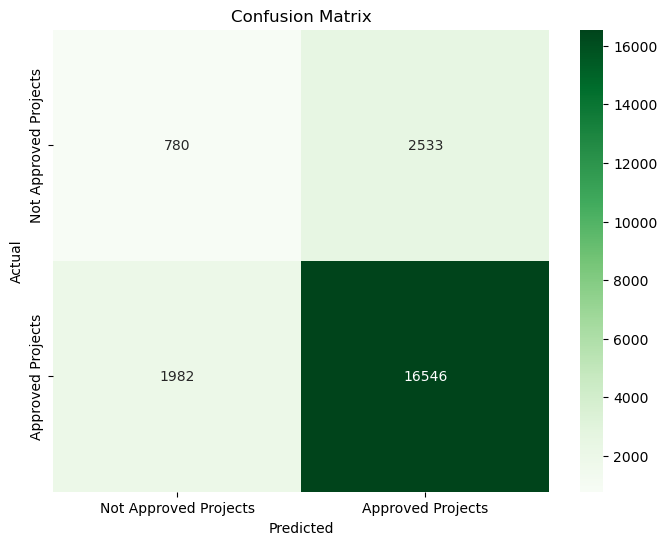

Accuracy using BernoulliNB: 0.7932786960304016
Precision using BernoulliNB: 0.8672362283138529
Recall using BernoulliNB: 0.8930267702936097
F1-Score using BernoulliNB: 0.8799425638843833
ROC AUC using BernoulliNB: 0.5642314654365724
Confusion Matrix using BernoulliNB:
 [[  780  2533]
 [ 1982 16546]]
Classification Report using BernoulliNB:
               precision    recall  f1-score   support

           0       0.28      0.24      0.26      3313
           1       0.87      0.89      0.88     18528

    accuracy                           0.79     21841
   macro avg       0.57      0.56      0.57     21841
weighted avg       0.78      0.79      0.79     21841



In [78]:
from sklearn.naive_bayes import BernoulliNB

# Step 3: Initialize and train the Bernoulli Naive Bayes model
bernoulli_nb_classifier = BernoulliNB()
bernoulli_nb_classifier.fit(X_final_train, y_train)

# Step 4: Make predictions on the test set
y_pred = bernoulli_nb_classifier.predict(X_final_test)

# Step 5: Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
# Calculate precision
precision = precision_score(y_test, y_pred)

# Calculate recall
recall = recall_score(y_test, y_pred)

# Calculate F1-score
f1 = f1_score(y_test, y_pred)

# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred)

# Generate a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
display_confusion_matrix(conf_matrix)

# Generate a classification report
class_report = classification_report(y_test, y_pred)

# Print the results
print("Accuracy using BernoulliNB:", accuracy)
print("Precision using BernoulliNB:", precision)
print("Recall using BernoulliNB:", recall)
print("F1-Score using BernoulliNB:", f1)
print("ROC AUC using BernoulliNB:", roc_auc)
print("Confusion Matrix using BernoulliNB:\n", conf_matrix)
print("Classification Report using BernoulliNB:\n", class_report)

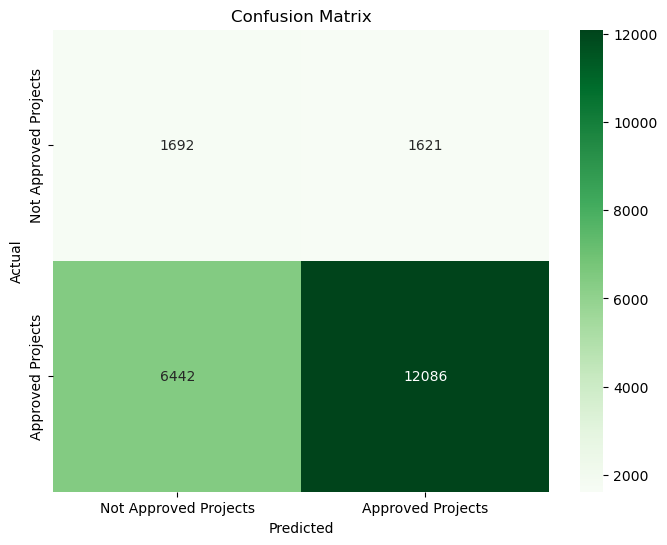

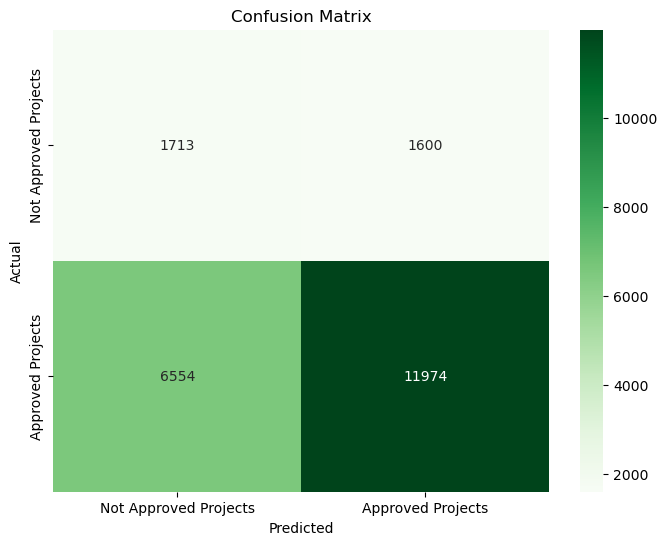

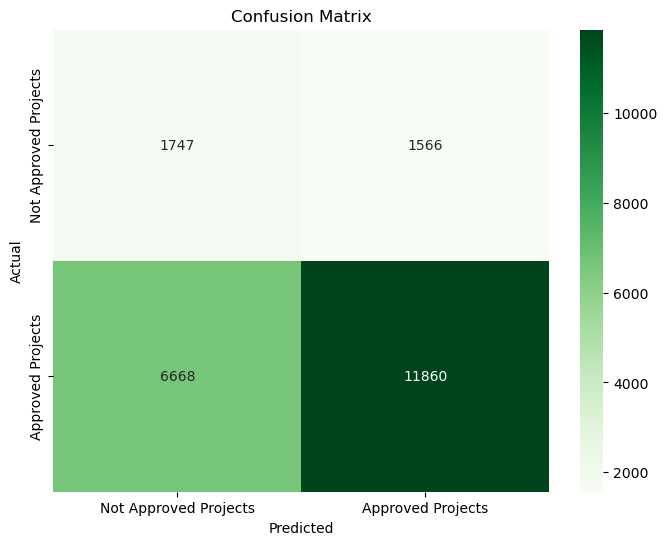

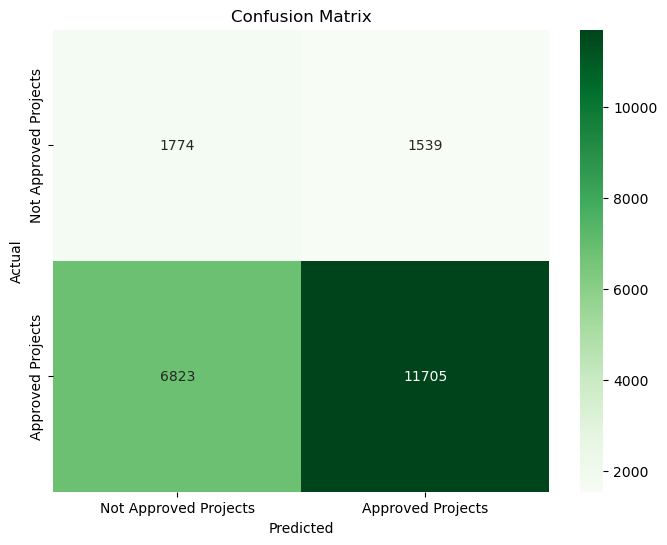

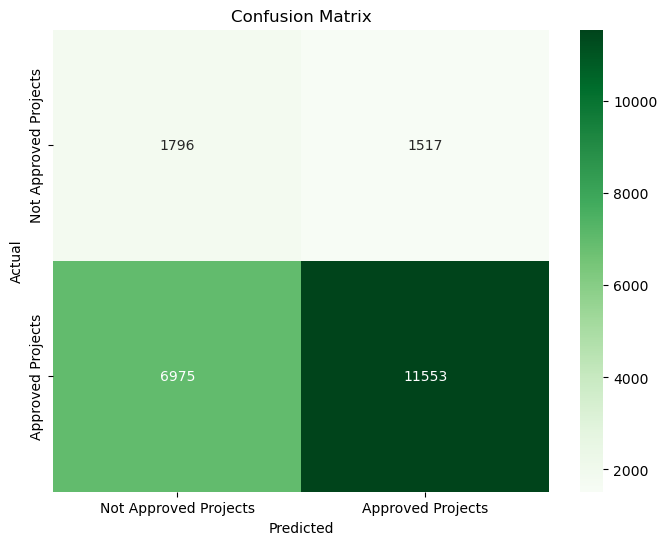

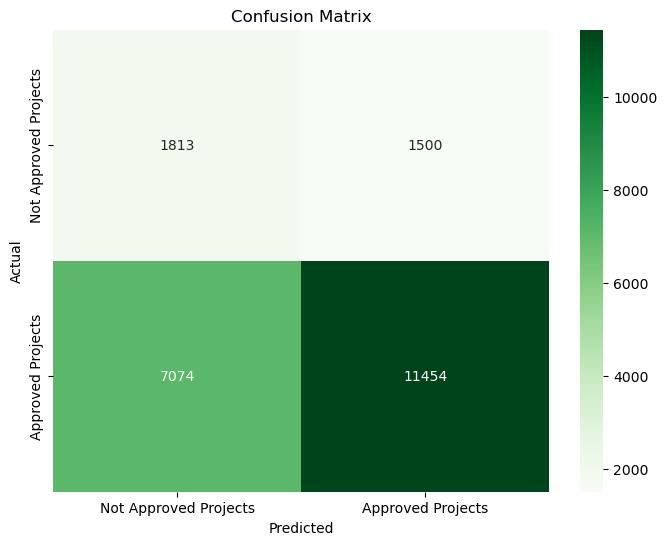

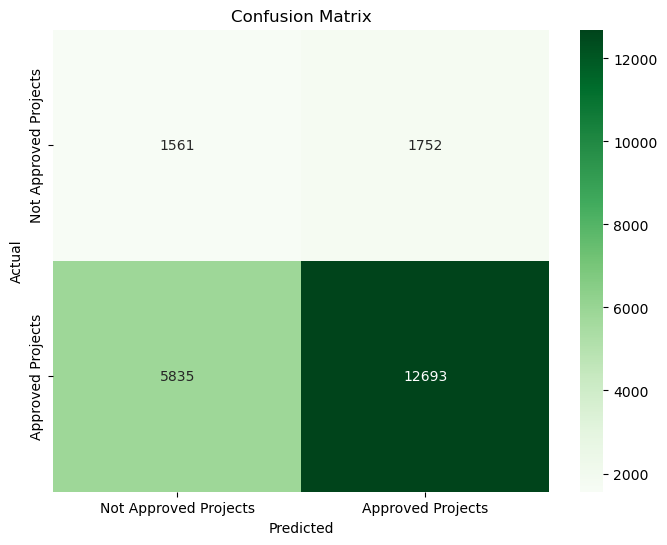

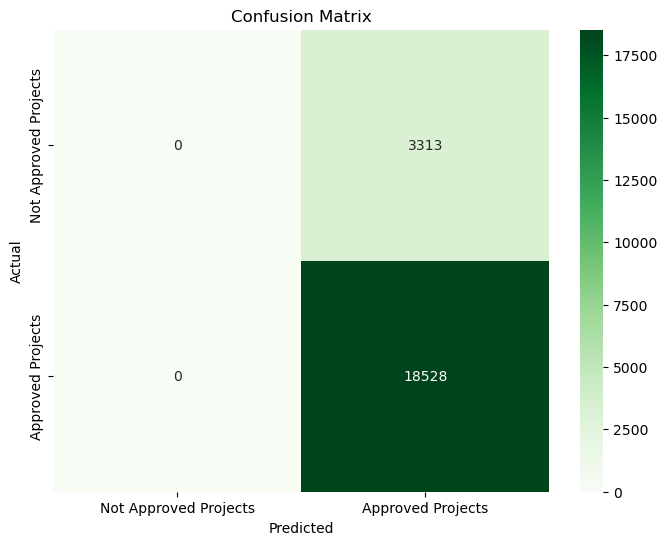

C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


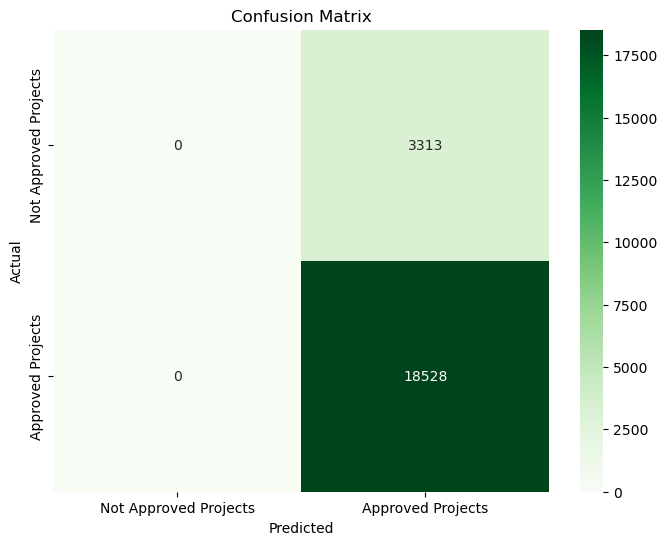

C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


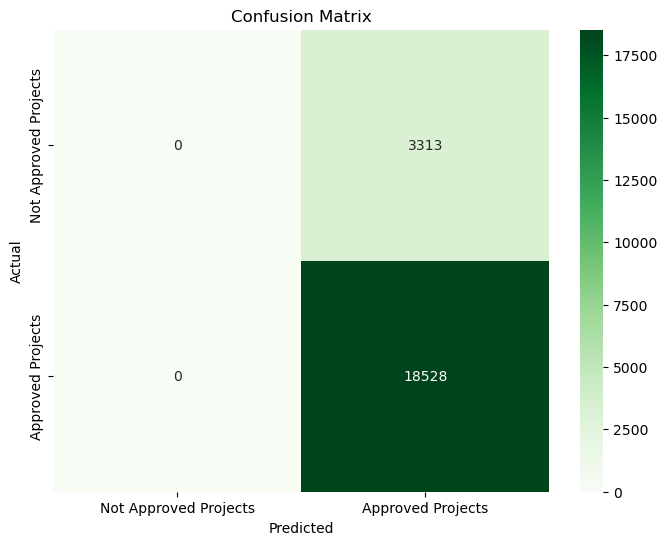

C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


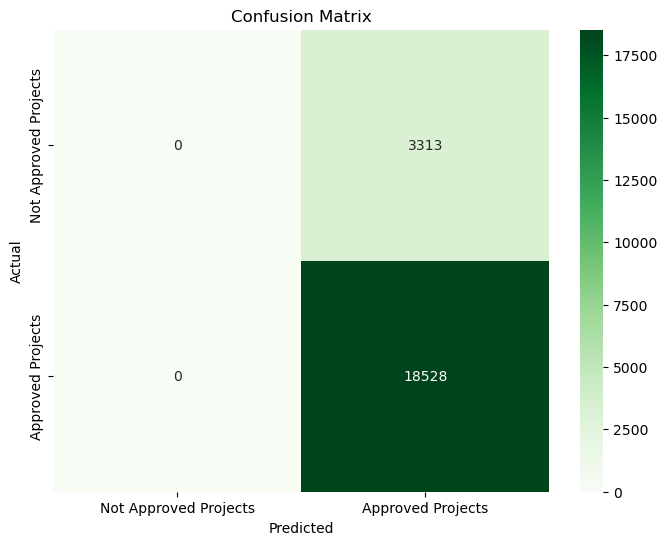

C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


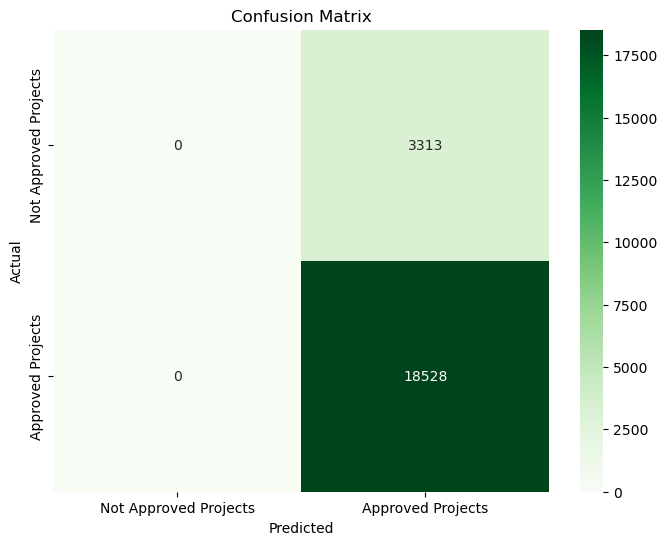

Results for alpha=1e-06:
Accuracy using MultinomialNB: 0.6308319216153107
Precision using MultinomialNB: 0.8817392573137813
Recall using MultinomialNB: 0.6523100172711571
F1-Score using MultinomialNB: 0.7498681557313479
ROC AUC using MultinomialNB: 0.5815126904949206
Confusion Matrix using MultinomialNB:
 [[ 1692  1621]
 [ 6442 12086]]
Classification Report using MultinomialNB:
               precision    recall  f1-score   support

           0       0.21      0.51      0.30      3313
           1       0.88      0.65      0.75     18528

    accuracy                           0.63     21841
   macro avg       0.54      0.58      0.52     21841
weighted avg       0.78      0.63      0.68     21841

Results for alpha=1e-05:
Accuracy using MultinomialNB: 0.6266654457213497
Precision using MultinomialNB: 0.8821275968763813
Recall using MultinomialNB: 0.6462651122625216
F1-Score using MultinomialNB: 0.7459971341349448
ROC AUC using MultinomialNB: 0.5816595709214811
Confusion Matrix using 

C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [79]:
from sklearn.naive_bayes import MultinomialNB
import numpy as np

# Define a range of alpha values to test
alpha_values = [0.000001,0.00001,0.0001,0.001,0.01,0.1,1,10,100,1000,10000,100000]

# Initialize lists to store evaluation metrics for each alpha
accuracies = []
precisions = []
recalls = []
f1_scores = []
roc_aucs = []
conf_matrices = []
class_reports = []

for alpha in alpha_values:
    # Step 3: Initialize and train the Multinomial Naive Bayes model with the current alpha
    Multinomial_nb_classifier = MultinomialNB(alpha=alpha)
    Multinomial_nb_classifier.fit(X_final_train, y_train)

    # Step 4: Make predictions on the test set
    y_pred = Multinomial_nb_classifier.predict(X_final_test)

    # Step 5: Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred)
    conf_matrix = confusion_matrix(y_test, y_pred)
    display_confusion_matrix(conf_matrix)
    class_report = classification_report(y_test, y_pred)

    # Append metrics to the respective lists
    accuracies.append(accuracy)
    precisions.append(precision)
    recalls.append(recall)
    f1_scores.append(f1)
    roc_aucs.append(roc_auc)
    conf_matrices.append(conf_matrix)
    class_reports.append(class_report)

# Print the results for each alpha
for i, alpha in enumerate(alpha_values):
    print(f"Results for alpha={alpha}:")
    print("Accuracy using MultinomialNB:", accuracies[i])
    print("Precision using MultinomialNB:", precisions[i])
    print("Recall using MultinomialNB:", recalls[i])
    print("F1-Score using MultinomialNB:", f1_scores[i])
    print("ROC AUC using MultinomialNB:", roc_aucs[i])
    print("Confusion Matrix using MultinomialNB:\n", conf_matrices[i])
    print("Classification Report using MultinomialNB:\n", class_reports[i])


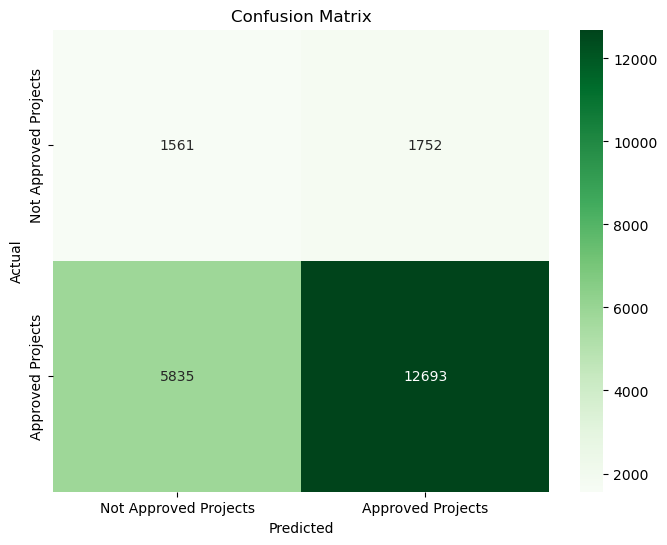

Accuracy using MultinomialNB: 0.652625795522183
Precision using MultinomialNB: 0.8787123572170301
Recall using MultinomialNB: 0.685071243523316
F1-Score using MultinomialNB: 0.7699026476207805
ROC AUC using MultinomialNB: 0.5781227029569492
Confusion Matrix using MultinomialNB:
 [[ 1561  1752]
 [ 5835 12693]]
Classification Report using MultinomialNB:
               precision    recall  f1-score   support

           0       0.21      0.47      0.29      3313
           1       0.88      0.69      0.77     18528

    accuracy                           0.65     21841
   macro avg       0.54      0.58      0.53     21841
weighted avg       0.78      0.65      0.70     21841



In [80]:
from sklearn.naive_bayes import MultinomialNB

# Step 3: Initialize and train the Bernoulli Naive Bayes model
Multinomial_nb_classifier = MultinomialNB()
Multinomial_nb_classifier.fit(X_final_train, y_train)

# Step 4: Make predictions on the test set
y_pred = Multinomial_nb_classifier.predict(X_final_test)

# Step 5: Evaluate the model
accuracy = accuracy_score(y_test, y_pred)

# Calculate precision
precision = precision_score(y_test, y_pred)

# Calculate recall
recall = recall_score(y_test, y_pred)

# Calculate F1-score
f1 = f1_score(y_test, y_pred)

# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred)

# Generate a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
display_confusion_matrix(conf_matrix)

# Generate a classification report
class_report = classification_report(y_test, y_pred)

# Print the results
print("Accuracy using MultinomialNB:", accuracy)
print("Precision using MultinomialNB:", precision)
print("Recall using MultinomialNB:", recall)
print("F1-Score using MultinomialNB:", f1)
print("ROC AUC using MultinomialNB:", roc_auc)
print("Confusion Matrix using MultinomialNB:\n", conf_matrix)
print("Classification Report using MultinomialNB:\n", class_report)

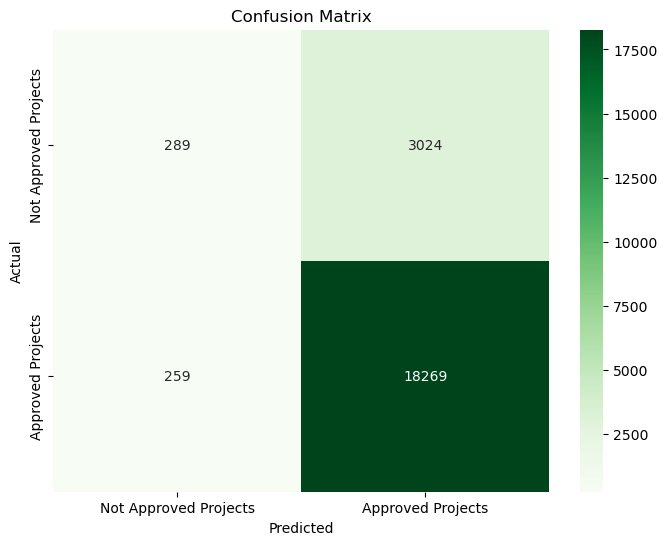

Accuracy using XGBClassifier: 0.8496863696717183
Precision using XGBClassifier: 0.8579814962663787
Recall using XGBClassifier: 0.9860211571675302
F1-Score using XGBClassifier: 0.9175560633836418
ROC AUC using XGBClassifier: 0.5366266365372816
Confusion Matrix using XGBClassifier:
 [[  289  3024]
 [  259 18269]]
Classification Report using XGBClassifier:
               precision    recall  f1-score   support

           0       0.53      0.09      0.15      3313
           1       0.86      0.99      0.92     18528

    accuracy                           0.85     21841
   macro avg       0.69      0.54      0.53     21841
weighted avg       0.81      0.85      0.80     21841



In [81]:
from xgboost import XGBClassifier

xgboost_classifier_model = XGBClassifier()
xgboost_classifier_model.fit(X_final_train, y_train)

# Make predictions on the test set
y_pred = xgboost_classifier_model.predict(X_final_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)

# Calculate precision
precision = precision_score(y_test, y_pred)

# Calculate recall
recall = recall_score(y_test, y_pred)

# Calculate F1-score
f1 = f1_score(y_test, y_pred)

# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred)

# Generate a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
display_confusion_matrix(conf_matrix)

# Generate a classification report
class_report = classification_report(y_test, y_pred)

# Print the results
print("Accuracy using XGBClassifier:", accuracy)
print("Precision using XGBClassifier:", precision)
print("Recall using XGBClassifier:", recall)
print("F1-Score using XGBClassifier:", f1)
print("ROC AUC using XGBClassifier:", roc_auc)
print("Confusion Matrix using XGBClassifier:\n", conf_matrix)
print("Classification Report using XGBClassifier:\n", class_report)


C:\ProgramFiles\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


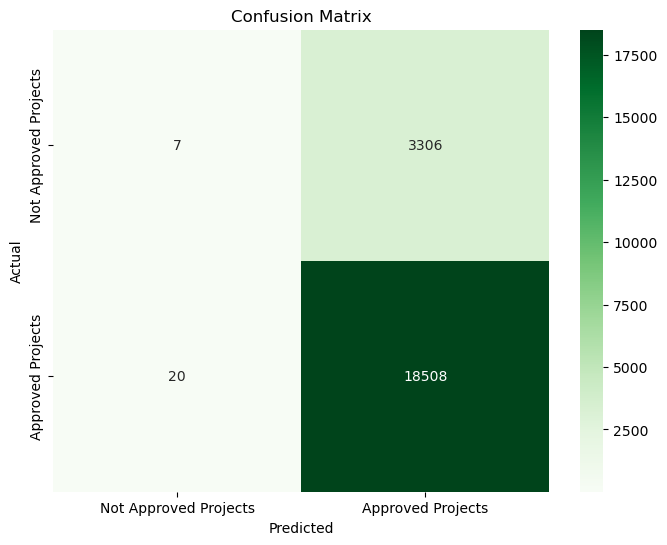

Accuracy using LogisticRegression model: 0.8477175953481983
Precision using LogisticRegression model: 0.848445952140827
Recall using LogisticRegression model: 0.9989205526770294
F1-Score using LogisticRegression model: 0.9175549055574834
ROC AUC using LogisticRegression model: 0.5005167206488075
Confusion Matrix using LogisticRegression model:
 [[    7  3306]
 [   20 18508]]
Classification Report using LogisticRegression model:
               precision    recall  f1-score   support

           0       0.26      0.00      0.00      3313
           1       0.85      1.00      0.92     18528

    accuracy                           0.85     21841
   macro avg       0.55      0.50      0.46     21841
weighted avg       0.76      0.85      0.78     21841



In [82]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score,roc_auc_score, confusion_matrix, classification_report

# Initialize and train the Logistic Regression model
logistic_regression_model = LogisticRegression()
logistic_regression_model.fit(X_final_train, y_train)

# Make predictions on the test set
y_pred = logistic_regression_model.predict(X_final_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)

# Calculate precision
precision = precision_score(y_test, y_pred)

# Calculate recall
recall = recall_score(y_test, y_pred)

# Calculate F1-score
f1 = f1_score(y_test, y_pred)

# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred)

# Generate a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
display_confusion_matrix(conf_matrix)

# Generate a classification report
class_report = classification_report(y_test, y_pred)

# Print the results
print("Accuracy using LogisticRegression model:", accuracy)
print("Precision using LogisticRegression model:", precision)
print("Recall using LogisticRegression model:", recall)
print("F1-Score using LogisticRegression model:", f1)
print("ROC AUC using LogisticRegression model:", roc_auc)
print("Confusion Matrix using LogisticRegression model:\n", conf_matrix)
print("Classification Report using LogisticRegression model:\n", class_report)
